# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

<div class="alert alert-block alert-warning">
<b>Caution:</b> You will need to create the proper python virtual environment.  The environment specifications can be found in the requirements.txt file.
<br>
Using Anaconda is recommended.  To begin, execute the code below from your anaconda command prompt:<br>
<br>
$ conda env create -f environment.yaml
<br>
<br>
Then navigate to the directory for this project where you downloaded it on your PC and launch jupyter notebook from there.
</div>

<div class="alert alert-block alert-warning">
Using the environment.yaml file in the directory is the easiest way to get started, but if you would like to create a new environment manually, be sure to run the below commands in the anaconda command prompt:
<br><br>
conda create -n tensorflow pip python=3.5 
<br>
activate tensorflow
<br>
pip install -U tensorflow-gpu==1.0
<br>
pip install pillow
<br>
pip install tqdm
<br>
pip uninstall matplotlib
<br>
pip install matplotlib==2.0.2
</div>

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

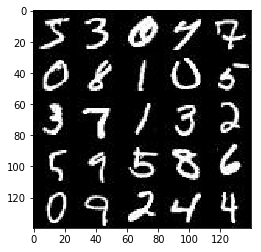

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

In [4]:
print(mnist_images.shape)

(25, 28, 28, 1)


### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

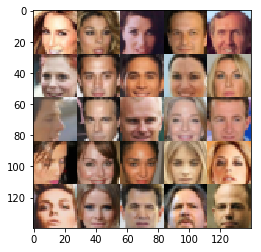

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

In [6]:
print(mnist_images.shape)

(25, 28, 28, 3)


## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [11]:
!pip install -U tensorflow-gpu==1.0

  Could not find a version that satisfies the requirement tensorflow-gpu==1.0 (from versions: 1.2.0rc2, 1.2.0, 1.2.1, 1.3.0rc0, 1.3.0rc1, 1.3.0rc2, 1.3.0, 1.4.0rc0, 1.4.0rc1, 1.4.0, 1.5.0rc0, 1.5.0rc1, 1.5.0, 1.6.0rc0, 1.6.0rc1, 1.6.0)
No matching distribution found for tensorflow-gpu==1.0


In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.1.0


C:\Users\steph\Anaconda3\envs\tensorflow\lib\site-packages\ipykernel_launcher.py:14: UserWarning: No GPU found. Please use a GPU to train your neural network.
  


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    inputs_real = tf.placeholder(tf.float32, [None, image_width, image_height, image_channels], name = 'input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name = 'input_z')
    learning_rate = tf.placeholder(tf.float32, name = 'learning_rate')

    return inputs_real, inputs_z, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [6]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    alpha = 0.2
    with tf.variable_scope('discriminator', reuse = reuse):
        # input is 28x28xN
        x1 = tf.layers.conv2d(images, 64, 5, strides = 2, padding = 'same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 14x14x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides = 2, padding = 'same')
        bn2 = tf.layers.batch_normalization(x2, training = True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 7x7x128 now
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides = 2, padding = 'valid')
        bn3 = tf.layers.batch_normalization(x3, training = True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 2x2x256 now
        
        
        flat = tf.reshape(relu3, (-1, 2*2*256))
        logits = tf.layers.dense(flat, 1, kernel_initializer=tf.contrib.layers.xavier_initializer())
        out = tf.sigmoid(logits)
        
        
        return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [7]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    alpha = 0.2

    # TODO: Implement Function
    with tf.variable_scope('generator', reuse = False if is_train == True else True):
        x1 = tf.layers.dense(z, 2*2*512, kernel_initializer=tf.contrib.layers.xavier_initializer())
        x1 = tf.reshape(x1, (-1, 2, 2, 512))
        x1 = tf.layers.batch_normalization(x1, training = is_train)
        x1 = tf.maximum(alpha * x1, x1)
        # 2x2x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides = 2, padding = 'valid')
        x2 = tf.layers.batch_normalization(x2, training = is_train)
        x2 = tf.maximum(alpha * x2, x2)
        # 7x7x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides = 2, padding = 'same')
        x3 = tf.layers.batch_normalization(x3, training = is_train)
        x3 = tf.maximum(alpha * x3, x3)
        # 14x14x128 now
        
        logits = tf.layers.conv2d_transpose(x3, out_channel_dim, 5, strides = 2, padding = 'same')
        # 28x28xN now
        out = tf.tanh(logits)
    
        return out

# reviewer noted to bring down number of layers even further to 64 to improve the generator
    
"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [8]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    g_model = generator(input_z, out_channel_dim)
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse = True)
    
    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits = d_logits_real, labels = tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits = d_logits_fake, labels = tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits = d_logits_fake, labels = tf.ones_like(d_model_fake)))
    d_loss = d_loss_real + d_loss_fake
    
    return d_loss, g_loss

# reviewer mentioned to add '* np.random.uniform(0.7, 1.2)' after 'tf.ones_like(d_model_real)' in discriminator loss
    # and a similar random number between 0 and 0.3 after 'tf.zeros_like(d_model_fake)' to provide better training results
    # through smoothing, but don't do this to generator loss

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [9]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1 = beta1).minimize(d_loss, var_list = d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1 = beta1).minimize(g_loss, var_list = g_vars)
    
    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [11]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    
    
    
    num_channels = 1
    if data_image_mode =="RGB":
        num_channels = 3
    
    input_real, input_z, lr  = model_inputs(data_shape[1], data_shape[2], num_channels, z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, data_shape[3])
    d_train_opt, g_train_opt = model_opt(d_loss, g_loss, lr, beta1)
    
    losses = []
    steps = 0
    saver = tf.train.Saver()
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                steps += 1
                
                
                batch_z = np.random.uniform(-1, 1, size = (batch_size, z_dim))
                batch_images = batch_images * 2
                
                _ = sess.run(d_train_opt, feed_dict = {input_real: batch_images, input_z: batch_z, lr: learning_rate})
                _ = sess.run(g_train_opt, feed_dict = {input_z: batch_z, input_real: batch_images, lr: learning_rate})
                
                if steps % 10 ==0:
                    train_loss_d = sess.run(d_loss, {input_z: batch_z, input_real: batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_z})
            
                    print("Epoch {}/{}...".format(epoch_i+1, epochs), "Discriminator Loss: {:.4f}...".format(train_loss_d), "Generator Loss: {:.4f}".format(train_loss_g)) 
                    losses.append((train_loss_d, train_loss_g))    
                    show_generator_output(sess, 10, input_z, data_shape[3], data_image_mode)
        saver.save(sess, './checkpoints/generator.ckpt')
                

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

<div class="alert alert-block alert-warning">
<b>Caution:</b> The training process takes a good bit of time.  If you are reviewing the code and wish to just see the results, scroll through the output of the cell below.
</div>

1
Epoch 1/2... Discriminator Loss: 0.3212... Generator Loss: 1.9420


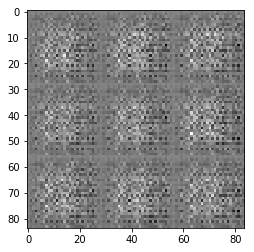

Epoch 1/2... Discriminator Loss: 0.3474... Generator Loss: 1.3607


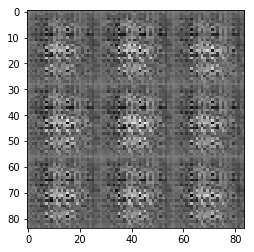

Epoch 1/2... Discriminator Loss: 1.0570... Generator Loss: 6.2709


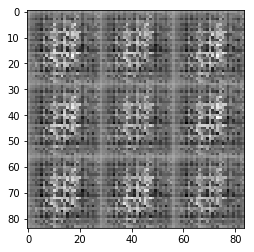

Epoch 1/2... Discriminator Loss: 1.4627... Generator Loss: 7.4019


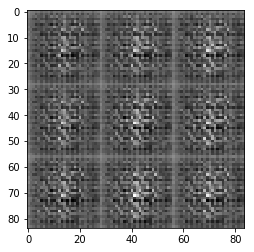

Epoch 1/2... Discriminator Loss: 0.7790... Generator Loss: 0.7311


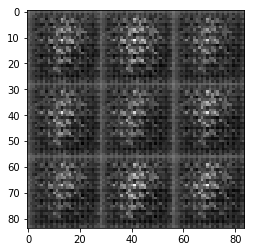

Epoch 1/2... Discriminator Loss: 0.7985... Generator Loss: 0.9869


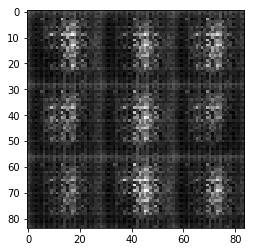

Epoch 1/2... Discriminator Loss: 0.6978... Generator Loss: 1.9080


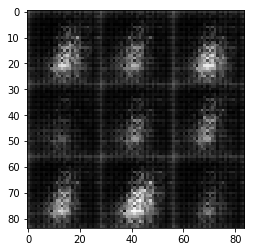

Epoch 1/2... Discriminator Loss: 1.3441... Generator Loss: 0.5559


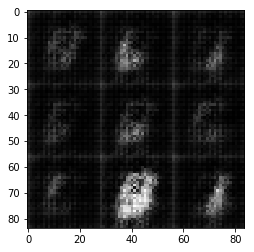

Epoch 1/2... Discriminator Loss: 1.2115... Generator Loss: 1.1506


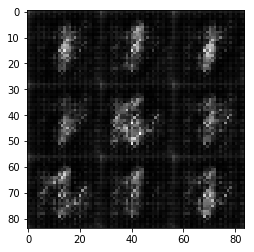

Epoch 1/2... Discriminator Loss: 0.8047... Generator Loss: 1.2191


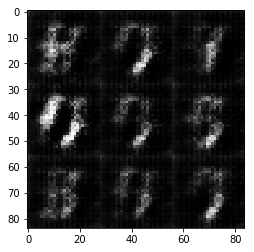

Epoch 1/2... Discriminator Loss: 1.0241... Generator Loss: 0.9375


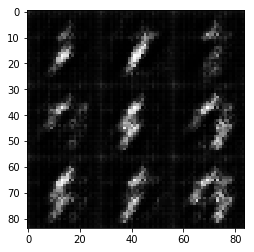

Epoch 1/2... Discriminator Loss: 0.9918... Generator Loss: 0.7013


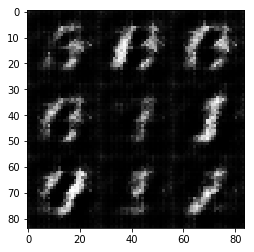

Epoch 1/2... Discriminator Loss: 0.9695... Generator Loss: 1.0846


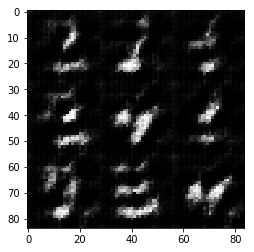

Epoch 1/2... Discriminator Loss: 1.4799... Generator Loss: 0.4614


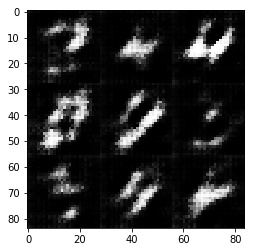

Epoch 1/2... Discriminator Loss: 1.1681... Generator Loss: 0.9578


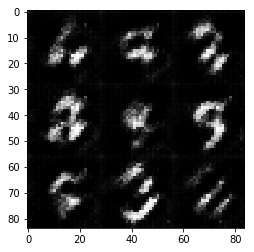

Epoch 1/2... Discriminator Loss: 1.4154... Generator Loss: 1.1497


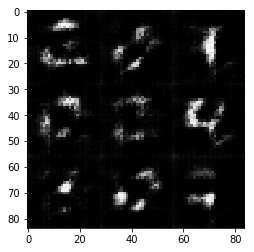

Epoch 1/2... Discriminator Loss: 1.0250... Generator Loss: 0.9432


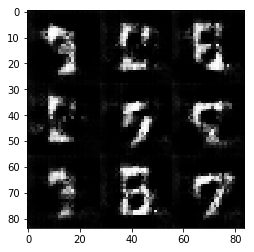

Epoch 1/2... Discriminator Loss: 1.0601... Generator Loss: 1.0745


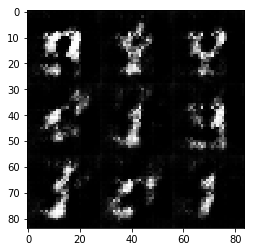

Epoch 1/2... Discriminator Loss: 1.1954... Generator Loss: 0.5600


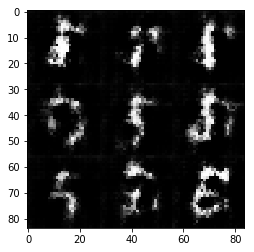

Epoch 1/2... Discriminator Loss: 1.2399... Generator Loss: 0.5241


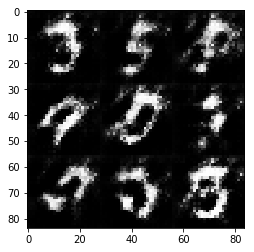

Epoch 1/2... Discriminator Loss: 1.2849... Generator Loss: 0.7385


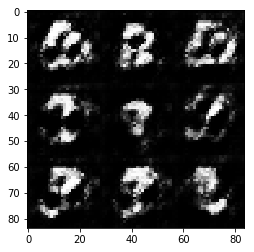

Epoch 1/2... Discriminator Loss: 0.9181... Generator Loss: 1.0524


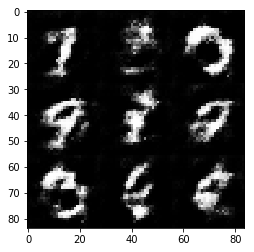

Epoch 1/2... Discriminator Loss: 1.1461... Generator Loss: 0.7338


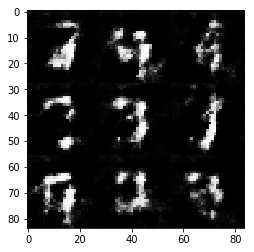

Epoch 1/2... Discriminator Loss: 1.4563... Generator Loss: 0.4277


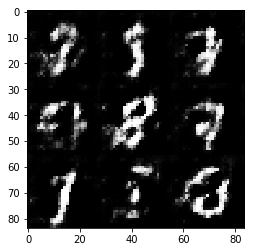

Epoch 1/2... Discriminator Loss: 1.2992... Generator Loss: 0.5821


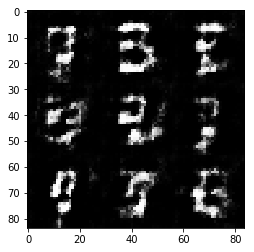

Epoch 1/2... Discriminator Loss: 0.9713... Generator Loss: 0.8264


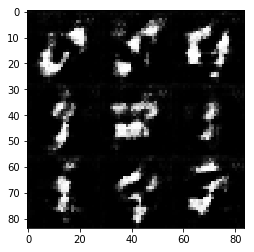

Epoch 1/2... Discriminator Loss: 1.2734... Generator Loss: 0.5809


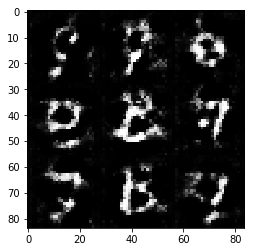

Epoch 1/2... Discriminator Loss: 1.0439... Generator Loss: 1.0813


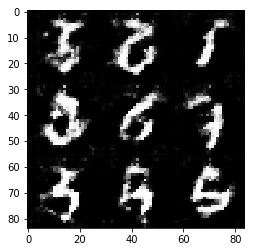

Epoch 1/2... Discriminator Loss: 1.3775... Generator Loss: 0.4865


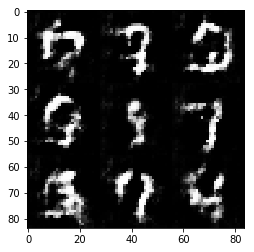

Epoch 1/2... Discriminator Loss: 1.1555... Generator Loss: 0.6164


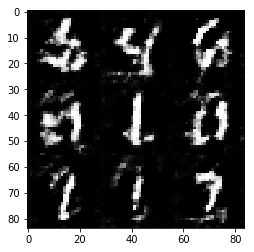

Epoch 1/2... Discriminator Loss: 1.0541... Generator Loss: 0.7399


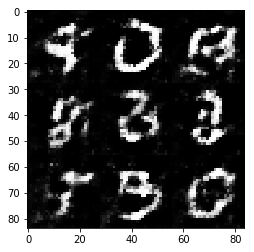

Epoch 1/2... Discriminator Loss: 1.1679... Generator Loss: 0.6498


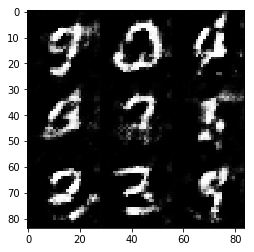

Epoch 1/2... Discriminator Loss: 1.0555... Generator Loss: 0.7629


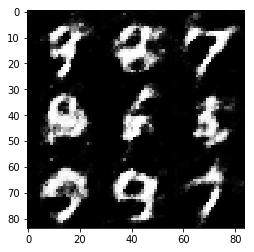

Epoch 1/2... Discriminator Loss: 1.2457... Generator Loss: 0.6431


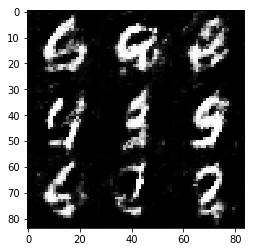

Epoch 1/2... Discriminator Loss: 1.2186... Generator Loss: 0.6448


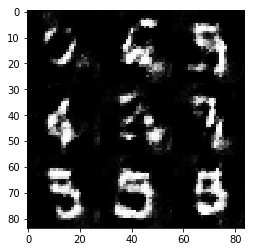

Epoch 1/2... Discriminator Loss: 1.1068... Generator Loss: 0.8011


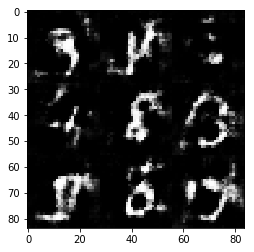

Epoch 1/2... Discriminator Loss: 0.9992... Generator Loss: 1.1736


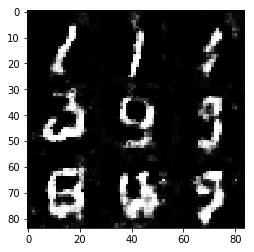

Epoch 1/2... Discriminator Loss: 1.3944... Generator Loss: 0.4824


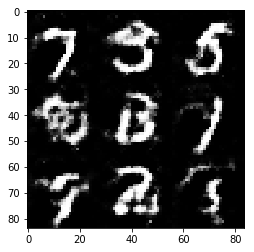

Epoch 1/2... Discriminator Loss: 1.0682... Generator Loss: 0.7305


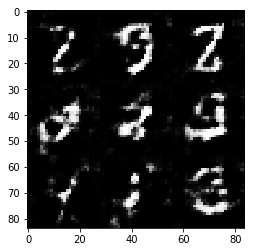

Epoch 1/2... Discriminator Loss: 1.0722... Generator Loss: 0.9399


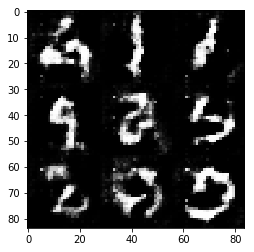

Epoch 1/2... Discriminator Loss: 1.2730... Generator Loss: 0.8843


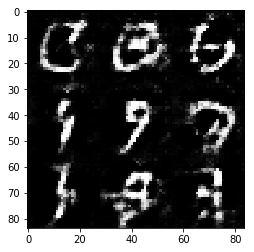

Epoch 1/2... Discriminator Loss: 0.9695... Generator Loss: 0.8487


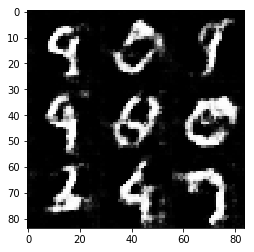

Epoch 1/2... Discriminator Loss: 1.0913... Generator Loss: 0.8593


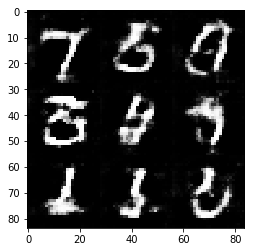

Epoch 1/2... Discriminator Loss: 1.1706... Generator Loss: 0.6215


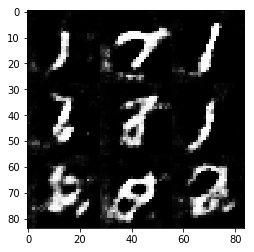

Epoch 1/2... Discriminator Loss: 1.2083... Generator Loss: 0.5783


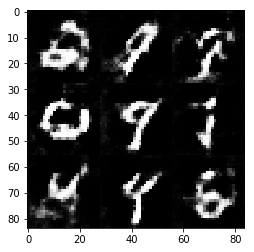

Epoch 1/2... Discriminator Loss: 1.0625... Generator Loss: 0.6689


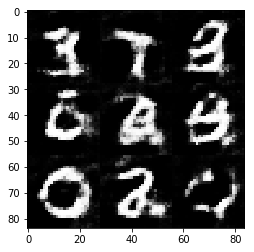

Epoch 1/2... Discriminator Loss: 1.1104... Generator Loss: 0.6782


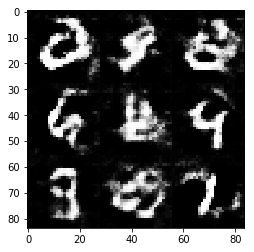

Epoch 1/2... Discriminator Loss: 1.1095... Generator Loss: 0.8248


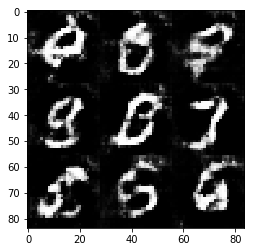

Epoch 1/2... Discriminator Loss: 1.1278... Generator Loss: 0.7221


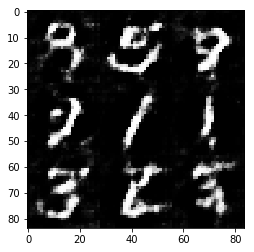

Epoch 1/2... Discriminator Loss: 1.1043... Generator Loss: 0.6045


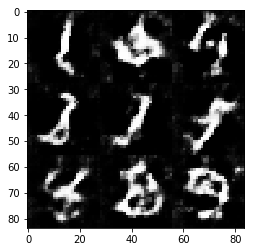

Epoch 1/2... Discriminator Loss: 1.1252... Generator Loss: 1.1946


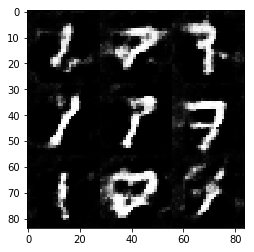

Epoch 1/2... Discriminator Loss: 1.0208... Generator Loss: 0.7502


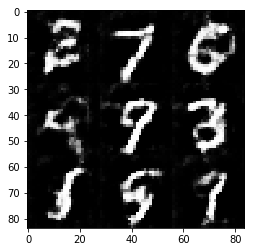

Epoch 1/2... Discriminator Loss: 1.1335... Generator Loss: 0.5708


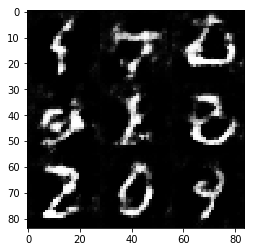

Epoch 1/2... Discriminator Loss: 1.1590... Generator Loss: 0.5978


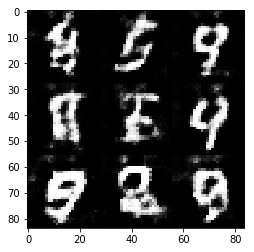

Epoch 1/2... Discriminator Loss: 1.0786... Generator Loss: 0.9400


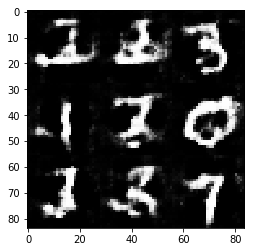

Epoch 1/2... Discriminator Loss: 0.9947... Generator Loss: 1.2588


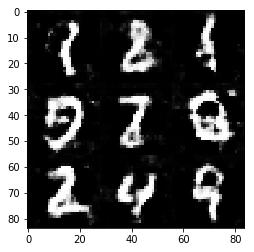

Epoch 1/2... Discriminator Loss: 1.3800... Generator Loss: 0.4102


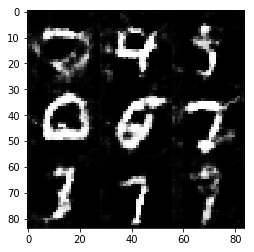

Epoch 1/2... Discriminator Loss: 1.1528... Generator Loss: 0.7829


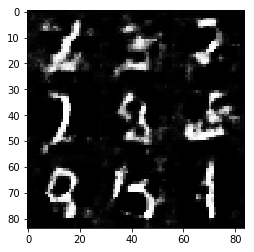

Epoch 1/2... Discriminator Loss: 0.8884... Generator Loss: 0.8823


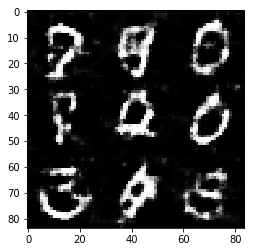

Epoch 1/2... Discriminator Loss: 1.4962... Generator Loss: 0.4199


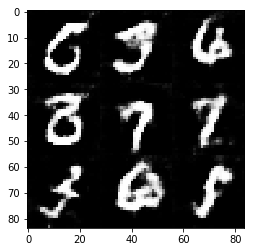

Epoch 1/2... Discriminator Loss: 1.0793... Generator Loss: 1.1790


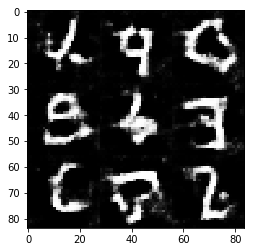

Epoch 1/2... Discriminator Loss: 1.1821... Generator Loss: 0.9098


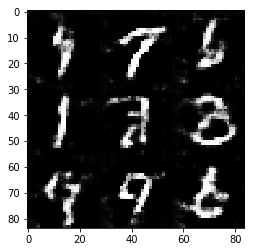

Epoch 1/2... Discriminator Loss: 1.1985... Generator Loss: 0.5182


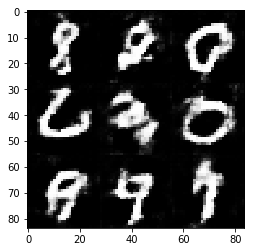

Epoch 1/2... Discriminator Loss: 1.0515... Generator Loss: 0.9083


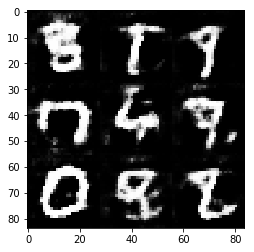

Epoch 1/2... Discriminator Loss: 1.1125... Generator Loss: 0.5857


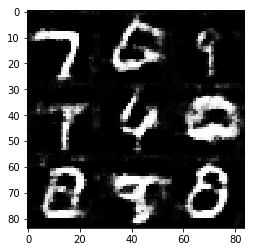

Epoch 1/2... Discriminator Loss: 1.1594... Generator Loss: 1.6613


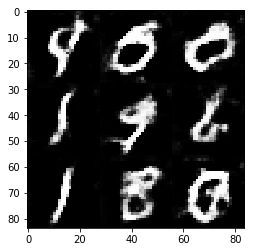

Epoch 1/2... Discriminator Loss: 1.1547... Generator Loss: 0.9524


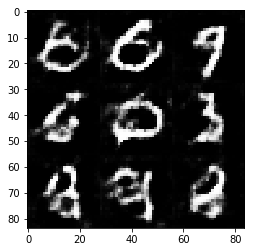

Epoch 1/2... Discriminator Loss: 1.0323... Generator Loss: 0.8889


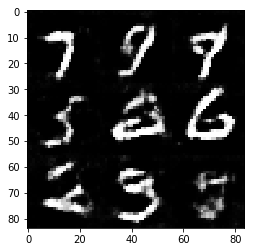

Epoch 1/2... Discriminator Loss: 1.2951... Generator Loss: 0.4422


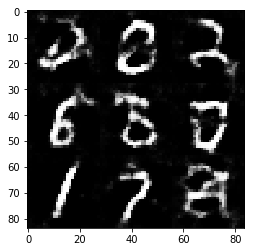

Epoch 1/2... Discriminator Loss: 1.0131... Generator Loss: 1.3234


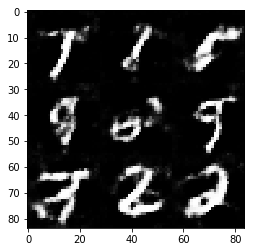

Epoch 1/2... Discriminator Loss: 1.4330... Generator Loss: 0.4132


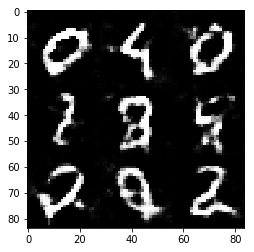

Epoch 1/2... Discriminator Loss: 1.0114... Generator Loss: 0.7673


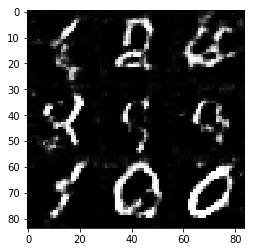

Epoch 1/2... Discriminator Loss: 1.1470... Generator Loss: 0.5751


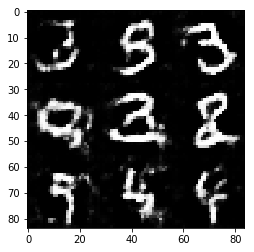

Epoch 1/2... Discriminator Loss: 0.9806... Generator Loss: 1.3064


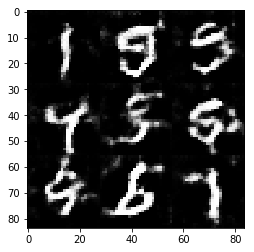

Epoch 1/2... Discriminator Loss: 0.9360... Generator Loss: 0.8102


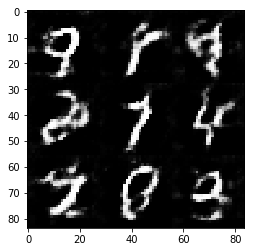

Epoch 1/2... Discriminator Loss: 0.8428... Generator Loss: 0.9798


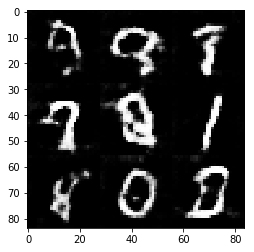

Epoch 1/2... Discriminator Loss: 0.9246... Generator Loss: 1.0937


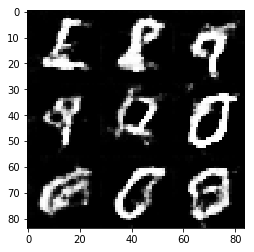

Epoch 1/2... Discriminator Loss: 1.0617... Generator Loss: 0.8645


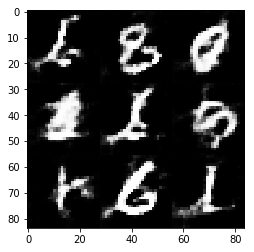

Epoch 1/2... Discriminator Loss: 0.9997... Generator Loss: 0.7862


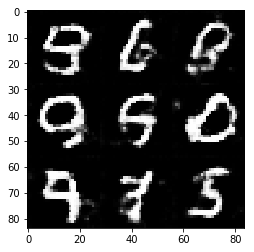

Epoch 1/2... Discriminator Loss: 1.3834... Generator Loss: 0.4032


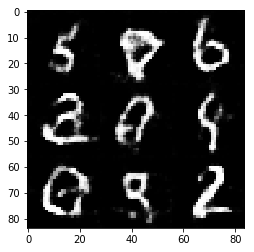

Epoch 1/2... Discriminator Loss: 0.9287... Generator Loss: 0.8208


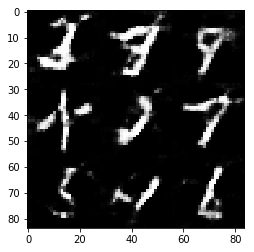

Epoch 1/2... Discriminator Loss: 0.9823... Generator Loss: 0.8103


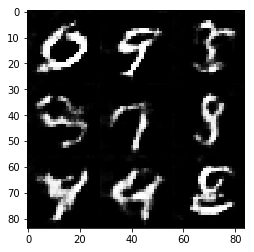

Epoch 1/2... Discriminator Loss: 1.0029... Generator Loss: 0.8013


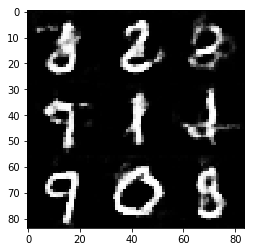

Epoch 1/2... Discriminator Loss: 1.0112... Generator Loss: 1.4988


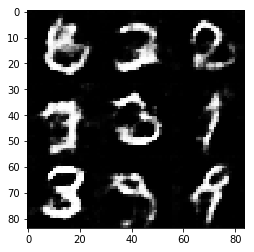

Epoch 1/2... Discriminator Loss: 1.2219... Generator Loss: 0.4563


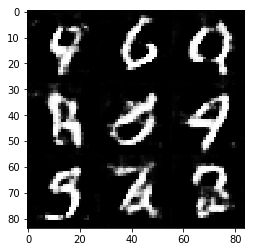

Epoch 1/2... Discriminator Loss: 0.8647... Generator Loss: 0.9123


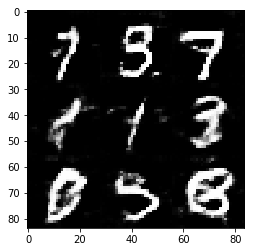

Epoch 1/2... Discriminator Loss: 1.1936... Generator Loss: 0.5450


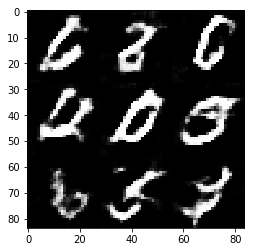

Epoch 1/2... Discriminator Loss: 1.2448... Generator Loss: 0.5235


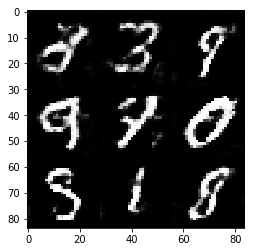

Epoch 1/2... Discriminator Loss: 1.1029... Generator Loss: 0.5668


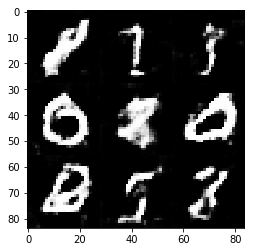

Epoch 1/2... Discriminator Loss: 1.1064... Generator Loss: 0.5811


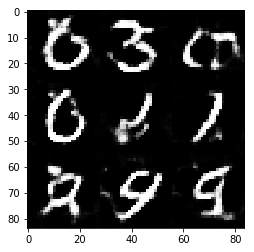

Epoch 1/2... Discriminator Loss: 0.9292... Generator Loss: 0.6717


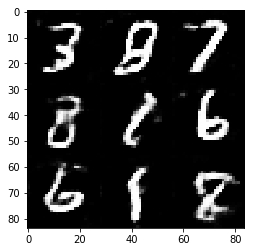

Epoch 1/2... Discriminator Loss: 1.5673... Generator Loss: 0.3035


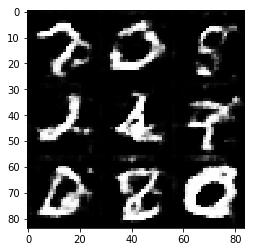

Epoch 1/2... Discriminator Loss: 1.0488... Generator Loss: 1.4682


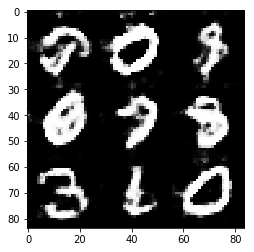

Epoch 1/2... Discriminator Loss: 1.4997... Generator Loss: 0.3574


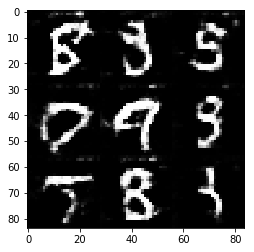

Epoch 1/2... Discriminator Loss: 0.8648... Generator Loss: 1.0014


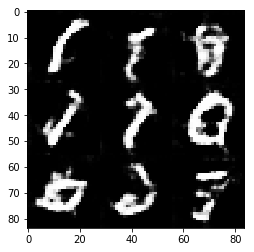

Epoch 1/2... Discriminator Loss: 0.7608... Generator Loss: 1.2578


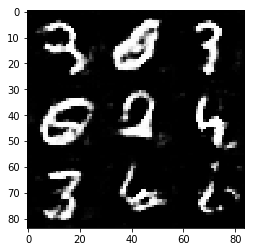

Epoch 1/2... Discriminator Loss: 1.6249... Generator Loss: 0.2858


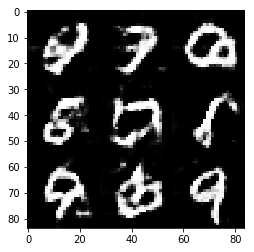

Epoch 1/2... Discriminator Loss: 2.0596... Generator Loss: 2.6354


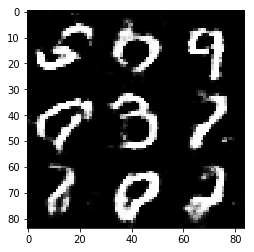

Epoch 1/2... Discriminator Loss: 0.9694... Generator Loss: 0.7927


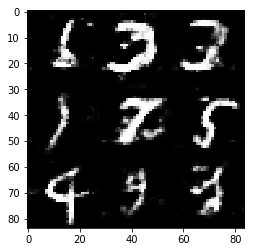

Epoch 1/2... Discriminator Loss: 1.0272... Generator Loss: 0.6310


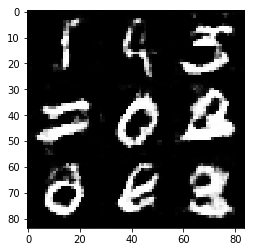

Epoch 1/2... Discriminator Loss: 0.9656... Generator Loss: 0.7320


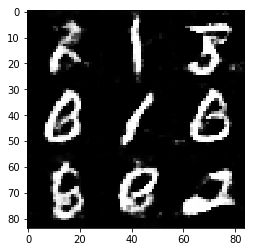

Epoch 1/2... Discriminator Loss: 1.0733... Generator Loss: 0.6600


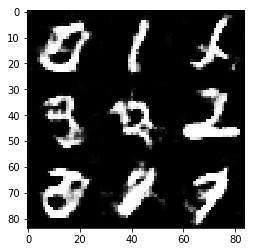

Epoch 1/2... Discriminator Loss: 1.1636... Generator Loss: 0.4916


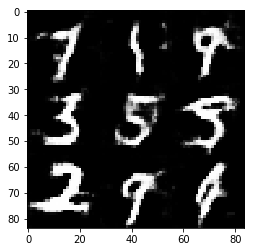

Epoch 1/2... Discriminator Loss: 1.7621... Generator Loss: 0.2641


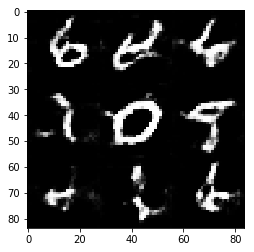

Epoch 1/2... Discriminator Loss: 0.8383... Generator Loss: 0.8195


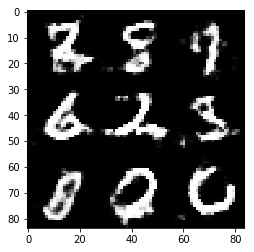

Epoch 1/2... Discriminator Loss: 1.0693... Generator Loss: 0.5695


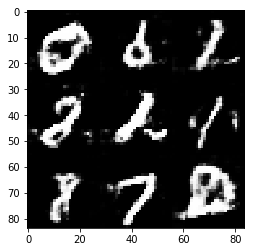

Epoch 1/2... Discriminator Loss: 0.7583... Generator Loss: 0.9143


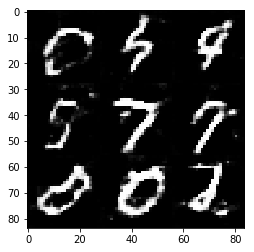

Epoch 1/2... Discriminator Loss: 0.7913... Generator Loss: 0.9245


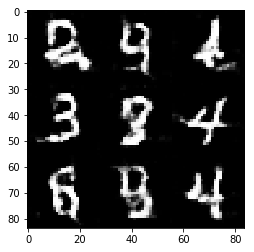

Epoch 1/2... Discriminator Loss: 1.4256... Generator Loss: 3.0089


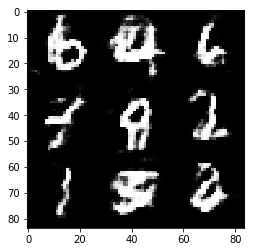

Epoch 1/2... Discriminator Loss: 1.0118... Generator Loss: 0.6129


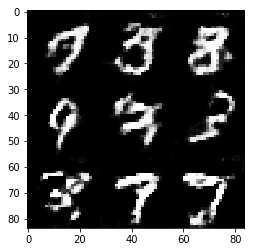

Epoch 1/2... Discriminator Loss: 0.9130... Generator Loss: 0.8413


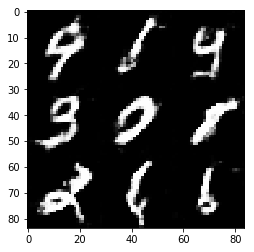

Epoch 1/2... Discriminator Loss: 1.1714... Generator Loss: 0.5220


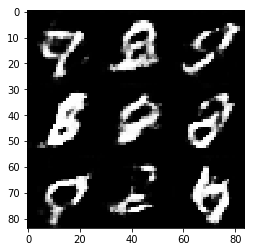

Epoch 1/2... Discriminator Loss: 1.0427... Generator Loss: 0.5942


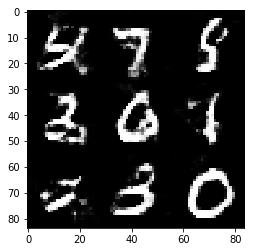

Epoch 1/2... Discriminator Loss: 1.6357... Generator Loss: 0.2979


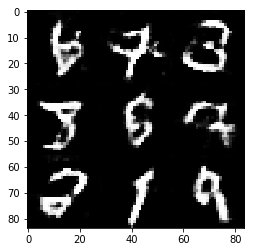

Epoch 1/2... Discriminator Loss: 0.8344... Generator Loss: 1.1771


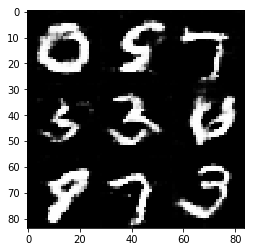

Epoch 1/2... Discriminator Loss: 0.9461... Generator Loss: 0.6732


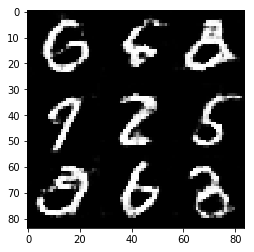

Epoch 1/2... Discriminator Loss: 1.6810... Generator Loss: 0.3635


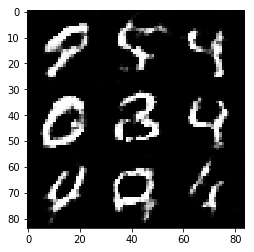

Epoch 1/2... Discriminator Loss: 0.7849... Generator Loss: 0.9265


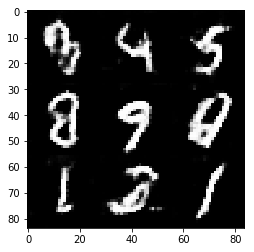

Epoch 1/2... Discriminator Loss: 0.6535... Generator Loss: 1.2413


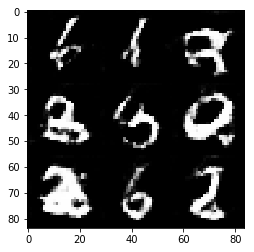

Epoch 1/2... Discriminator Loss: 0.5768... Generator Loss: 1.2142


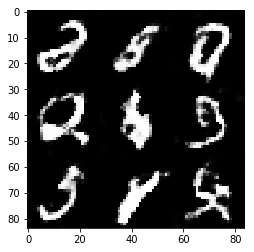

Epoch 1/2... Discriminator Loss: 0.7523... Generator Loss: 1.2957


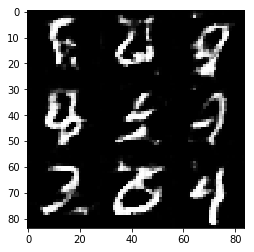

Epoch 1/2... Discriminator Loss: 0.8847... Generator Loss: 0.9065


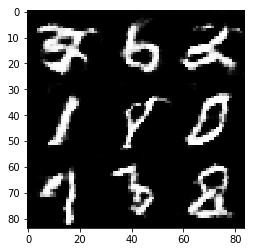

Epoch 1/2... Discriminator Loss: 0.8296... Generator Loss: 0.8423


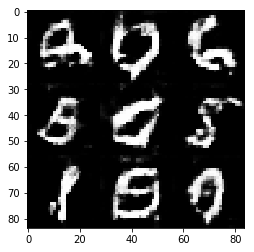

Epoch 1/2... Discriminator Loss: 0.7720... Generator Loss: 1.0147


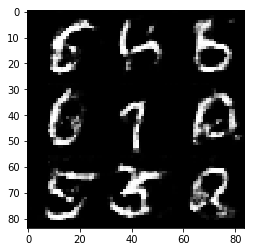

Epoch 1/2... Discriminator Loss: 0.4570... Generator Loss: 1.4503


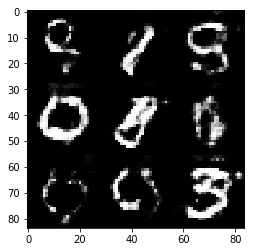

Epoch 1/2... Discriminator Loss: 0.5027... Generator Loss: 1.8091


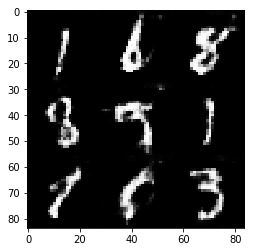

Epoch 1/2... Discriminator Loss: 1.1044... Generator Loss: 0.5715


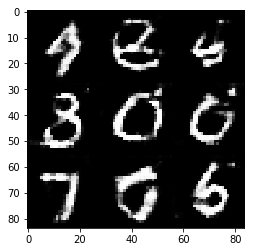

Epoch 1/2... Discriminator Loss: 0.5817... Generator Loss: 1.5482


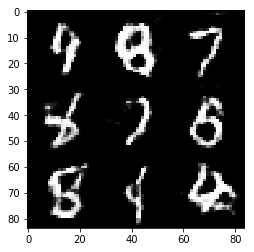

Epoch 1/2... Discriminator Loss: 1.9743... Generator Loss: 0.2083


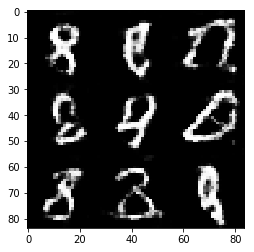

Epoch 1/2... Discriminator Loss: 2.1146... Generator Loss: 0.2068


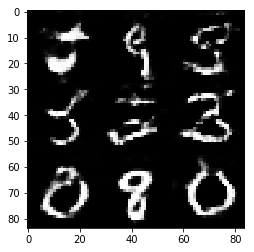

Epoch 1/2... Discriminator Loss: 0.6606... Generator Loss: 1.2206


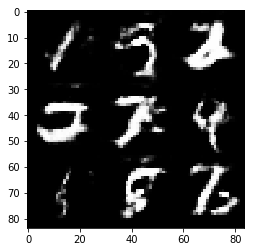

Epoch 1/2... Discriminator Loss: 1.0066... Generator Loss: 0.6280


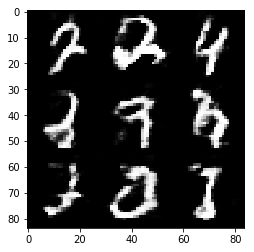

Epoch 1/2... Discriminator Loss: 0.9896... Generator Loss: 0.6868


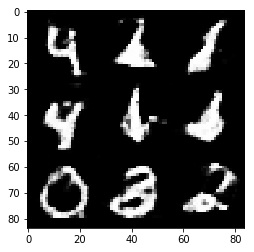

Epoch 1/2... Discriminator Loss: 0.9146... Generator Loss: 0.6875


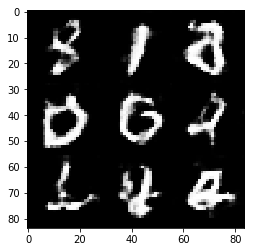

Epoch 1/2... Discriminator Loss: 1.2888... Generator Loss: 0.4602


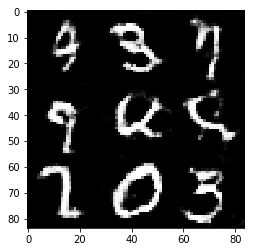

Epoch 1/2... Discriminator Loss: 1.5156... Generator Loss: 0.3440


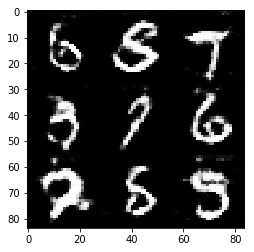

Epoch 1/2... Discriminator Loss: 0.8788... Generator Loss: 0.7263


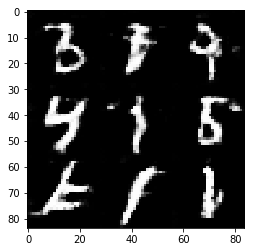

Epoch 1/2... Discriminator Loss: 0.6975... Generator Loss: 0.9362


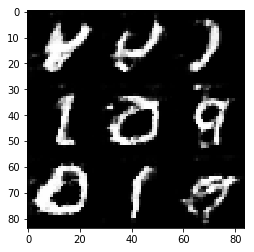

Epoch 1/2... Discriminator Loss: 0.4968... Generator Loss: 1.4864


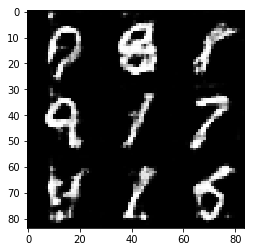

Epoch 1/2... Discriminator Loss: 1.4326... Generator Loss: 0.3560


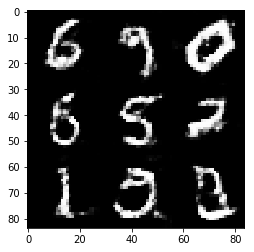

Epoch 1/2... Discriminator Loss: 1.0359... Generator Loss: 0.6215


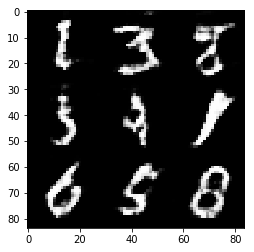

Epoch 1/2... Discriminator Loss: 0.8448... Generator Loss: 0.7908


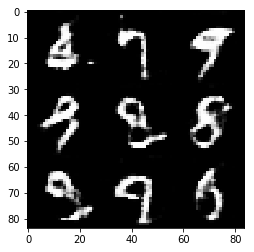

Epoch 1/2... Discriminator Loss: 0.7231... Generator Loss: 1.0779


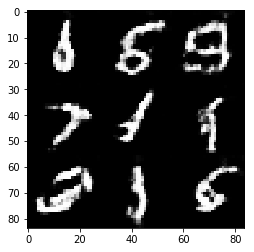

Epoch 1/2... Discriminator Loss: 1.3522... Generator Loss: 0.4125


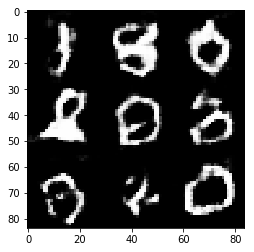

Epoch 1/2... Discriminator Loss: 1.2077... Generator Loss: 0.4868


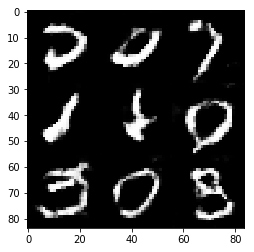

Epoch 1/2... Discriminator Loss: 0.4915... Generator Loss: 1.2802


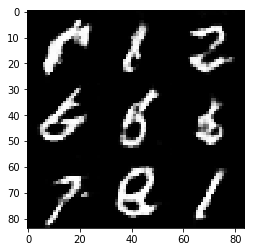

Epoch 1/2... Discriminator Loss: 1.4056... Generator Loss: 0.3641


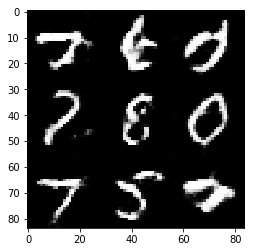

Epoch 1/2... Discriminator Loss: 0.8114... Generator Loss: 0.8736


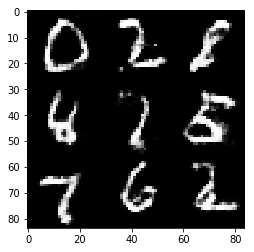

Epoch 1/2... Discriminator Loss: 2.0224... Generator Loss: 0.2453


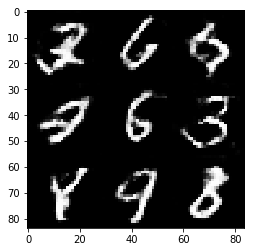

Epoch 1/2... Discriminator Loss: 0.7088... Generator Loss: 1.1085


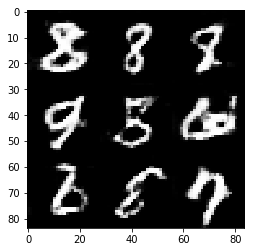

Epoch 1/2... Discriminator Loss: 0.8984... Generator Loss: 0.7854


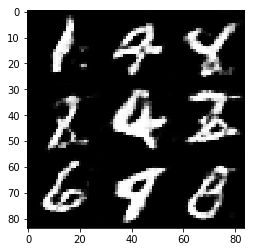

Epoch 1/2... Discriminator Loss: 0.7504... Generator Loss: 0.8152


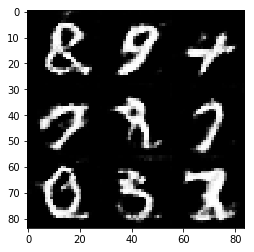

Epoch 1/2... Discriminator Loss: 1.0641... Generator Loss: 0.7320


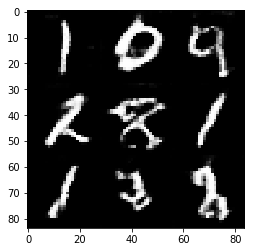

Epoch 1/2... Discriminator Loss: 1.5083... Generator Loss: 0.3718


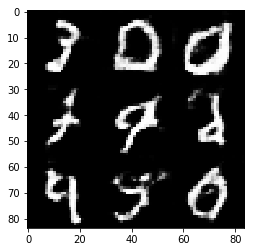

Epoch 1/2... Discriminator Loss: 1.0883... Generator Loss: 0.5590


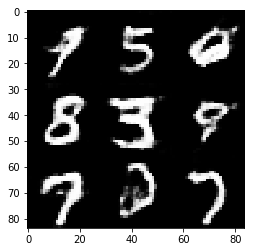

Epoch 1/2... Discriminator Loss: 0.9048... Generator Loss: 0.7473


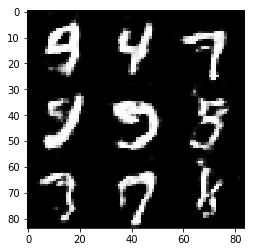

Epoch 1/2... Discriminator Loss: 0.6649... Generator Loss: 0.9636


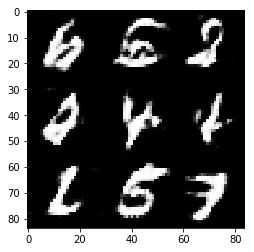

Epoch 1/2... Discriminator Loss: 0.6069... Generator Loss: 1.9467


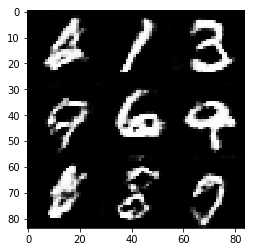

Epoch 1/2... Discriminator Loss: 0.6090... Generator Loss: 1.3276


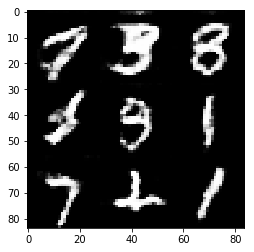

Epoch 1/2... Discriminator Loss: 1.7830... Generator Loss: 0.2920


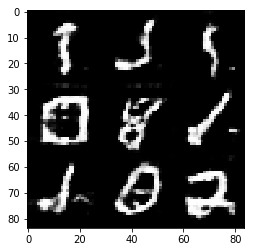

Epoch 1/2... Discriminator Loss: 1.1663... Generator Loss: 0.5108


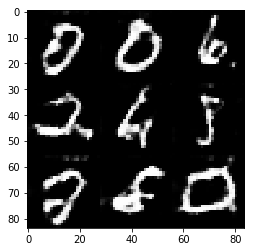

Epoch 1/2... Discriminator Loss: 1.5081... Generator Loss: 0.4435


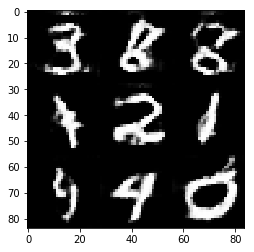

Epoch 1/2... Discriminator Loss: 0.6890... Generator Loss: 1.0957


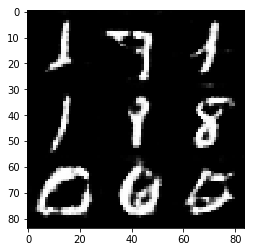

Epoch 1/2... Discriminator Loss: 0.6977... Generator Loss: 0.9054


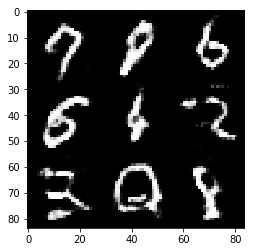

Epoch 1/2... Discriminator Loss: 1.0483... Generator Loss: 0.6747


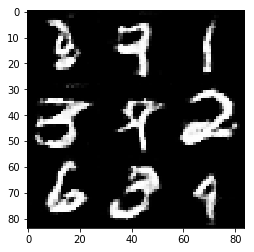

Epoch 1/2... Discriminator Loss: 1.3873... Generator Loss: 0.3956


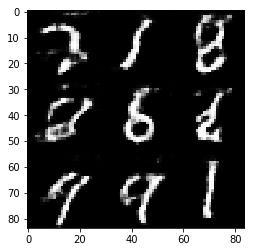

Epoch 1/2... Discriminator Loss: 0.9222... Generator Loss: 0.7815


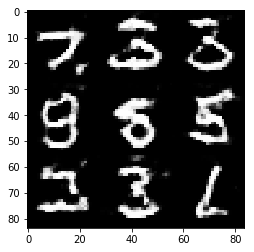

Epoch 1/2... Discriminator Loss: 0.5680... Generator Loss: 1.1327


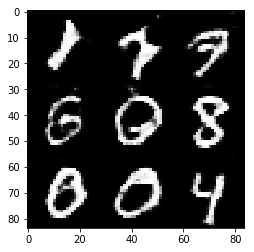

Epoch 1/2... Discriminator Loss: 0.9793... Generator Loss: 0.7200


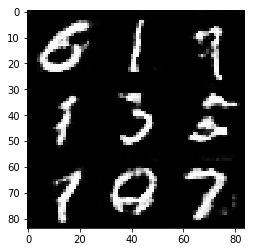

Epoch 1/2... Discriminator Loss: 0.6356... Generator Loss: 0.9486


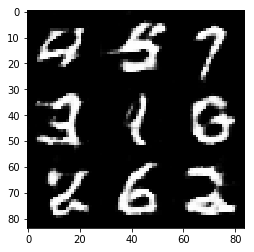

Epoch 1/2... Discriminator Loss: 0.6257... Generator Loss: 0.9492


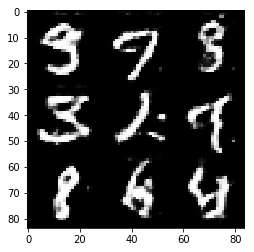

Epoch 1/2... Discriminator Loss: 0.9513... Generator Loss: 0.8163


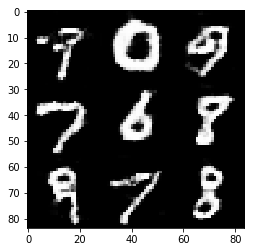

Epoch 1/2... Discriminator Loss: 1.1284... Generator Loss: 0.5610


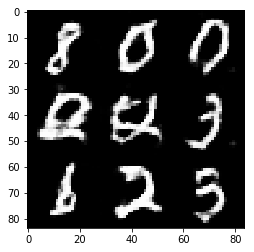

Epoch 1/2... Discriminator Loss: 1.2480... Generator Loss: 2.2853


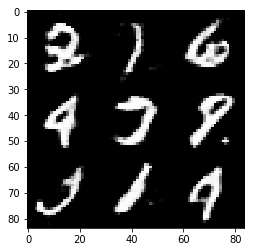

Epoch 1/2... Discriminator Loss: 0.7081... Generator Loss: 0.9926


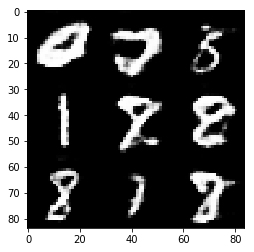

Epoch 1/2... Discriminator Loss: 0.7167... Generator Loss: 0.8919


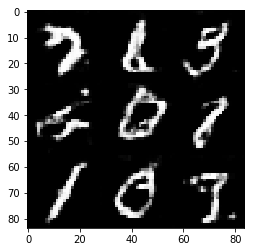

Epoch 1/2... Discriminator Loss: 1.1012... Generator Loss: 0.5666


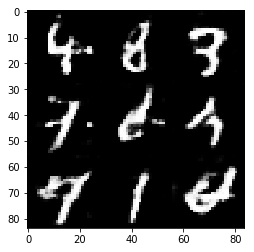

Epoch 1/2... Discriminator Loss: 0.5058... Generator Loss: 1.8696


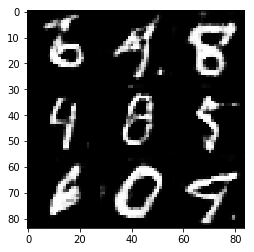

Epoch 1/2... Discriminator Loss: 0.5910... Generator Loss: 1.1391


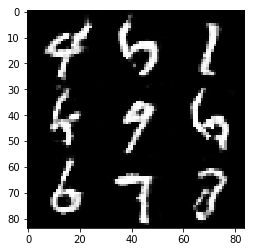

Epoch 1/2... Discriminator Loss: 0.4195... Generator Loss: 1.4324


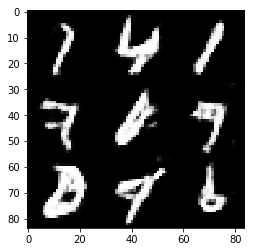

Epoch 1/2... Discriminator Loss: 0.5411... Generator Loss: 1.7655


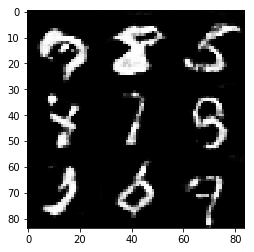

Epoch 1/2... Discriminator Loss: 1.3870... Generator Loss: 0.4630


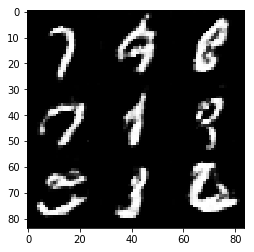

Epoch 1/2... Discriminator Loss: 0.8573... Generator Loss: 1.0323


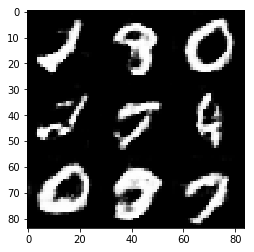

Epoch 1/2... Discriminator Loss: 0.7056... Generator Loss: 0.9392


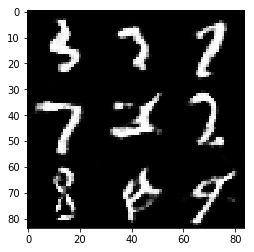

Epoch 1/2... Discriminator Loss: 1.0575... Generator Loss: 0.5887


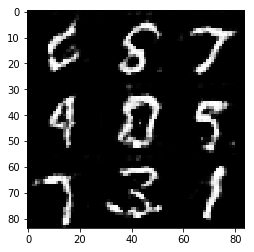

Epoch 1/2... Discriminator Loss: 1.2932... Generator Loss: 0.4696


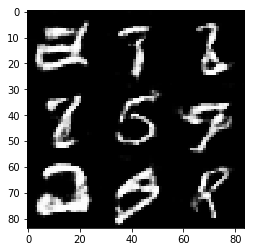

Epoch 1/2... Discriminator Loss: 0.7132... Generator Loss: 0.9146


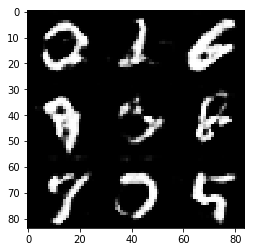

Epoch 2/2... Discriminator Loss: 0.5392... Generator Loss: 1.1222


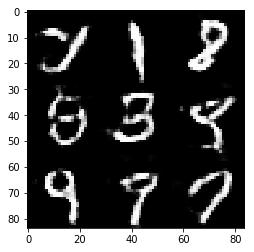

Epoch 2/2... Discriminator Loss: 0.8703... Generator Loss: 2.4126


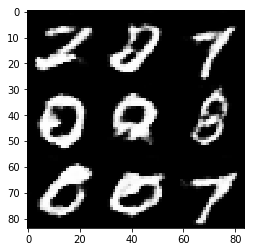

Epoch 2/2... Discriminator Loss: 0.7136... Generator Loss: 0.9735


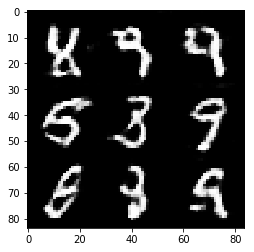

Epoch 2/2... Discriminator Loss: 0.5527... Generator Loss: 1.2436


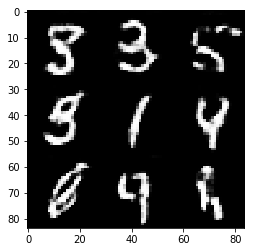

Epoch 2/2... Discriminator Loss: 0.7535... Generator Loss: 0.9282


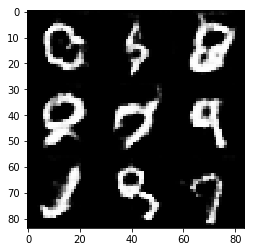

Epoch 2/2... Discriminator Loss: 1.0406... Generator Loss: 0.6317


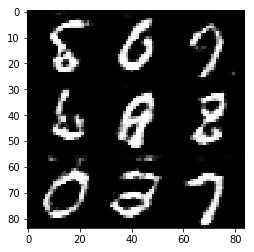

Epoch 2/2... Discriminator Loss: 0.5920... Generator Loss: 1.1941


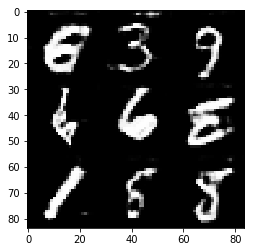

Epoch 2/2... Discriminator Loss: 0.3838... Generator Loss: 1.5863


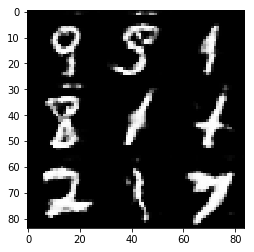

Epoch 2/2... Discriminator Loss: 1.0110... Generator Loss: 0.6376


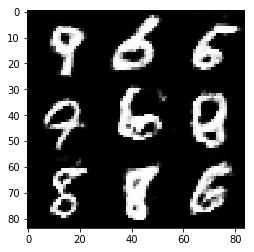

Epoch 2/2... Discriminator Loss: 1.2608... Generator Loss: 0.4520


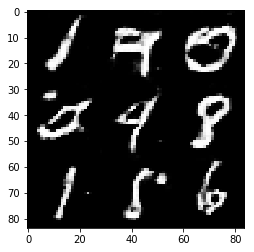

Epoch 2/2... Discriminator Loss: 0.5393... Generator Loss: 2.0568


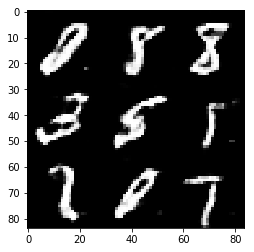

Epoch 2/2... Discriminator Loss: 0.5395... Generator Loss: 1.1742


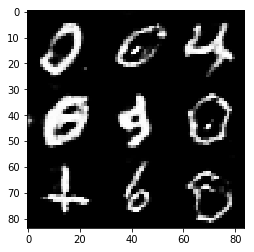

Epoch 2/2... Discriminator Loss: 0.8080... Generator Loss: 1.0319


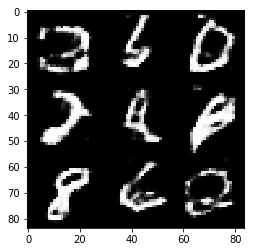

Epoch 2/2... Discriminator Loss: 0.8080... Generator Loss: 0.8219


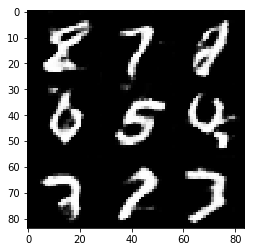

Epoch 2/2... Discriminator Loss: 0.9791... Generator Loss: 0.6375


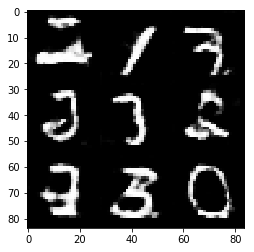

Epoch 2/2... Discriminator Loss: 0.8728... Generator Loss: 0.6445


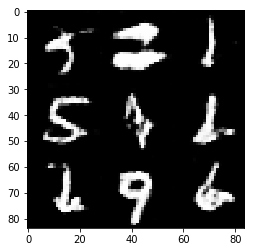

Epoch 2/2... Discriminator Loss: 0.8824... Generator Loss: 0.7189


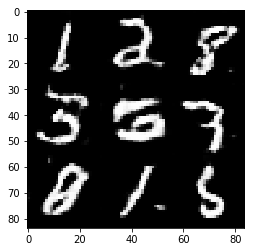

Epoch 2/2... Discriminator Loss: 0.5643... Generator Loss: 1.1424


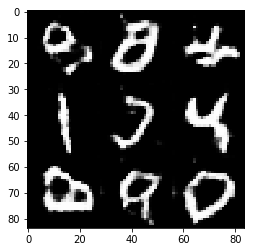

Epoch 2/2... Discriminator Loss: 0.5982... Generator Loss: 1.1589


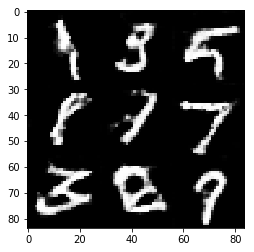

Epoch 2/2... Discriminator Loss: 0.3551... Generator Loss: 2.0594


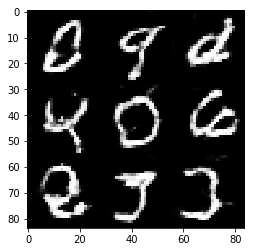

Epoch 2/2... Discriminator Loss: 0.6867... Generator Loss: 1.0732


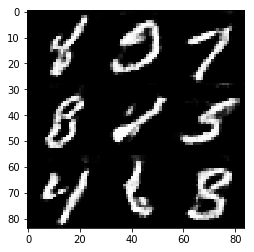

Epoch 2/2... Discriminator Loss: 0.7360... Generator Loss: 0.9768


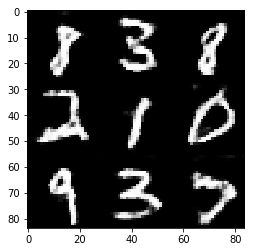

Epoch 2/2... Discriminator Loss: 0.6740... Generator Loss: 1.0597


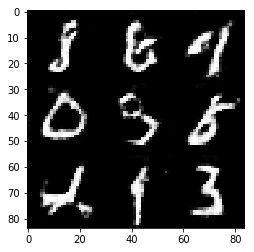

Epoch 2/2... Discriminator Loss: 0.5967... Generator Loss: 1.0116


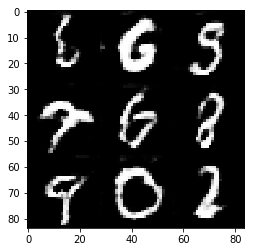

Epoch 2/2... Discriminator Loss: 0.7656... Generator Loss: 2.3922


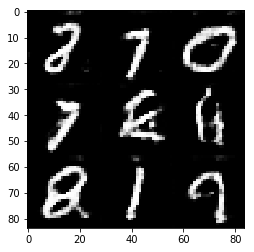

Epoch 2/2... Discriminator Loss: 0.5113... Generator Loss: 1.2900


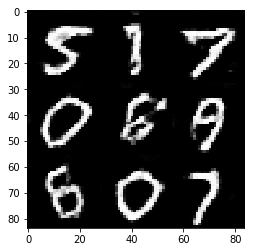

Epoch 2/2... Discriminator Loss: 1.1455... Generator Loss: 0.6007


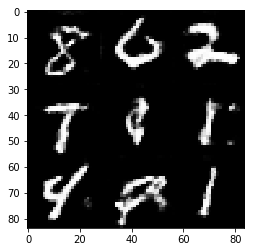

Epoch 2/2... Discriminator Loss: 0.6931... Generator Loss: 0.9281


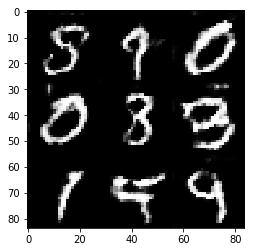

Epoch 2/2... Discriminator Loss: 1.0547... Generator Loss: 0.7250


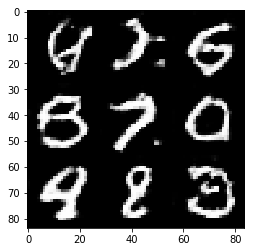

Epoch 2/2... Discriminator Loss: 1.9293... Generator Loss: 0.2507


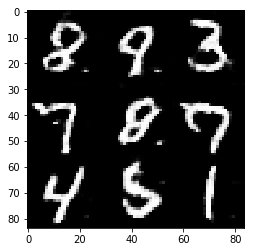

Epoch 2/2... Discriminator Loss: 0.6454... Generator Loss: 1.4462


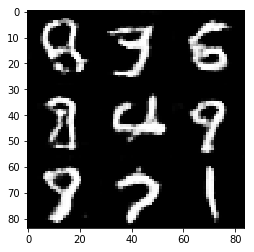

Epoch 2/2... Discriminator Loss: 0.6413... Generator Loss: 1.2084


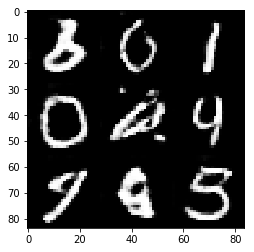

Epoch 2/2... Discriminator Loss: 0.7990... Generator Loss: 0.8344


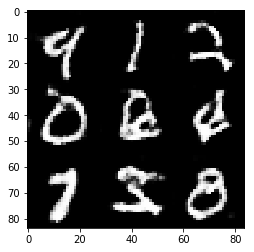

Epoch 2/2... Discriminator Loss: 1.4847... Generator Loss: 0.4466


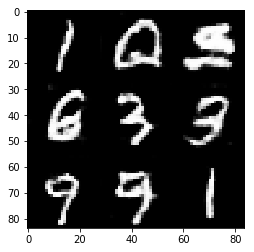

Epoch 2/2... Discriminator Loss: 0.5655... Generator Loss: 1.6233


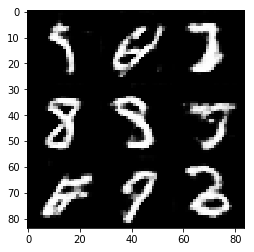

Epoch 2/2... Discriminator Loss: 0.9149... Generator Loss: 3.1542


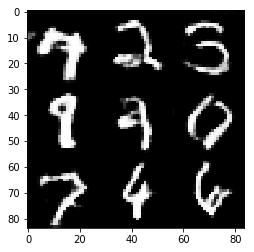

Epoch 2/2... Discriminator Loss: 0.6303... Generator Loss: 1.1679


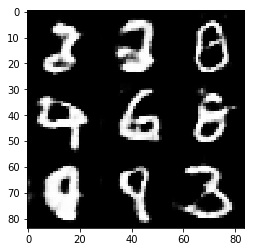

Epoch 2/2... Discriminator Loss: 0.6858... Generator Loss: 1.0378


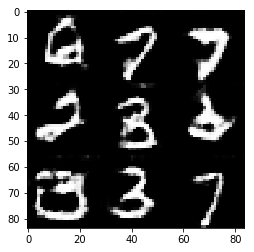

Epoch 2/2... Discriminator Loss: 0.5708... Generator Loss: 1.0883


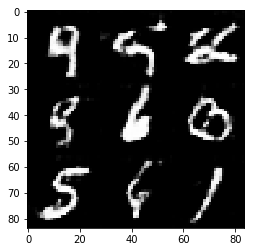

Epoch 2/2... Discriminator Loss: 1.6524... Generator Loss: 0.3351


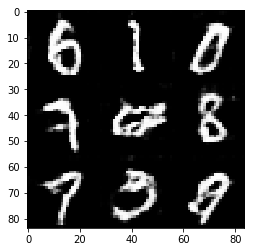

Epoch 2/2... Discriminator Loss: 0.6629... Generator Loss: 1.0052


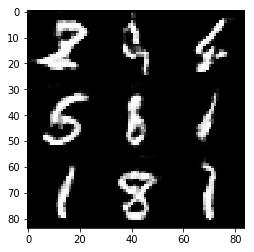

Epoch 2/2... Discriminator Loss: 1.4343... Generator Loss: 0.3889


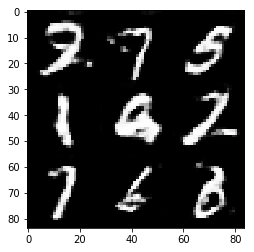

Epoch 2/2... Discriminator Loss: 0.6748... Generator Loss: 1.0890


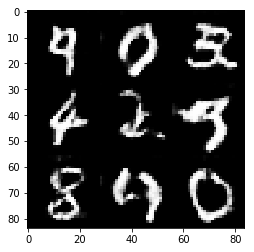

Epoch 2/2... Discriminator Loss: 0.5742... Generator Loss: 1.0879


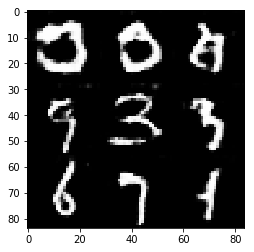

Epoch 2/2... Discriminator Loss: 0.9821... Generator Loss: 0.6931


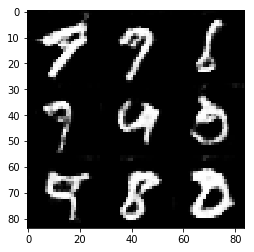

Epoch 2/2... Discriminator Loss: 1.6304... Generator Loss: 0.2730


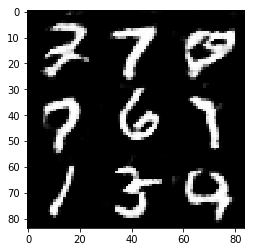

Epoch 2/2... Discriminator Loss: 0.9488... Generator Loss: 0.6694


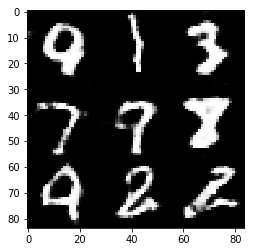

Epoch 2/2... Discriminator Loss: 0.3190... Generator Loss: 1.9815


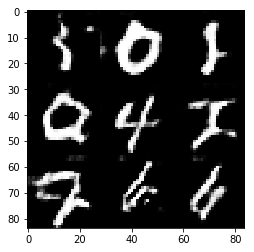

Epoch 2/2... Discriminator Loss: 1.0203... Generator Loss: 0.7076


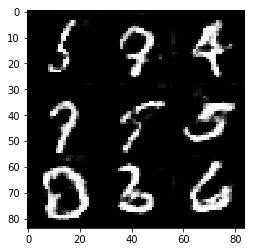

Epoch 2/2... Discriminator Loss: 0.8498... Generator Loss: 0.7545


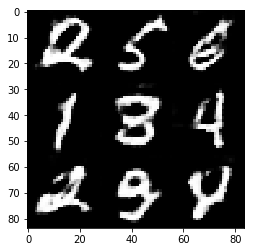

Epoch 2/2... Discriminator Loss: 0.8437... Generator Loss: 0.7759


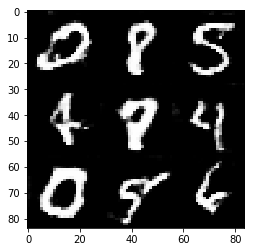

Epoch 2/2... Discriminator Loss: 0.5659... Generator Loss: 1.3067


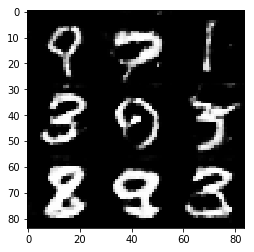

Epoch 2/2... Discriminator Loss: 1.4648... Generator Loss: 0.3939


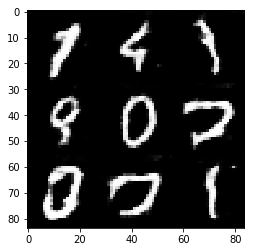

Epoch 2/2... Discriminator Loss: 0.3760... Generator Loss: 1.9944


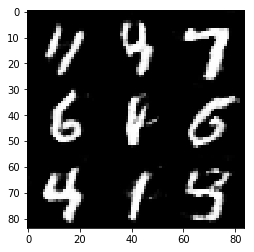

Epoch 2/2... Discriminator Loss: 1.7750... Generator Loss: 0.2449


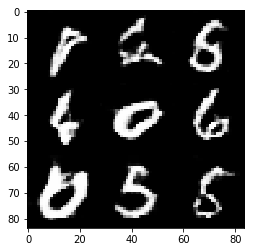

Epoch 2/2... Discriminator Loss: 0.9113... Generator Loss: 0.7608


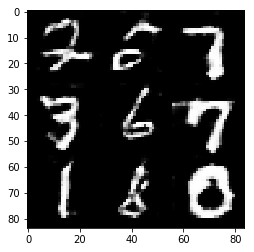

Epoch 2/2... Discriminator Loss: 1.5059... Generator Loss: 0.5108


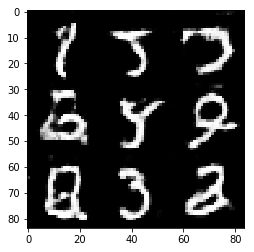

Epoch 2/2... Discriminator Loss: 1.1477... Generator Loss: 0.5713


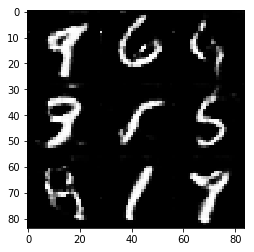

Epoch 2/2... Discriminator Loss: 0.6554... Generator Loss: 1.0157


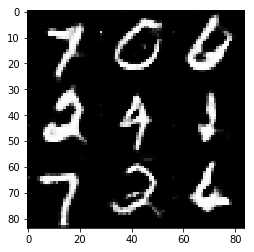

Epoch 2/2... Discriminator Loss: 1.0083... Generator Loss: 0.6672


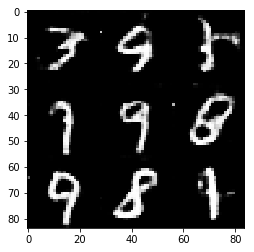

Epoch 2/2... Discriminator Loss: 0.8590... Generator Loss: 0.7590


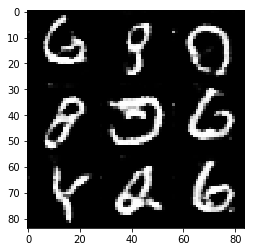

Epoch 2/2... Discriminator Loss: 0.9672... Generator Loss: 0.6510


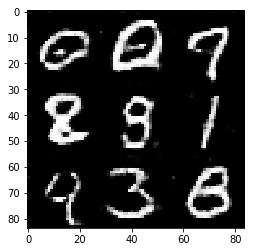

Epoch 2/2... Discriminator Loss: 1.1158... Generator Loss: 0.5472


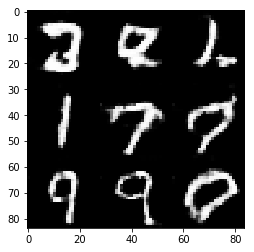

Epoch 2/2... Discriminator Loss: 0.6554... Generator Loss: 1.3001


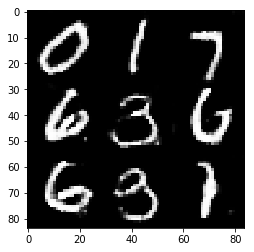

Epoch 2/2... Discriminator Loss: 0.4806... Generator Loss: 1.1930


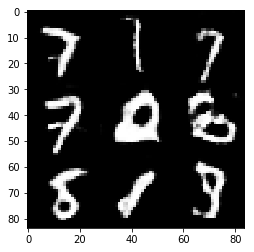

Epoch 2/2... Discriminator Loss: 1.8750... Generator Loss: 0.3458


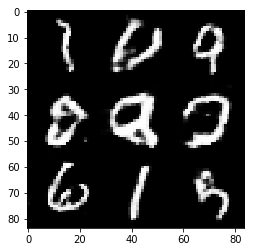

Epoch 2/2... Discriminator Loss: 1.2367... Generator Loss: 0.5669


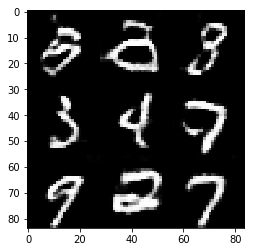

Epoch 2/2... Discriminator Loss: 1.1066... Generator Loss: 0.7090


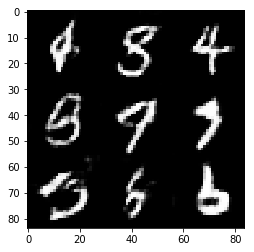

Epoch 2/2... Discriminator Loss: 0.5064... Generator Loss: 1.2425


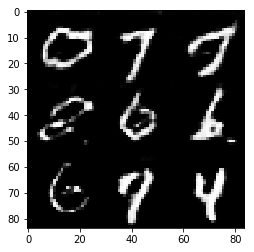

Epoch 2/2... Discriminator Loss: 0.7782... Generator Loss: 0.8731


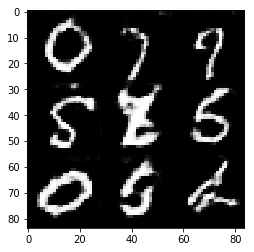

Epoch 2/2... Discriminator Loss: 0.3548... Generator Loss: 1.7314


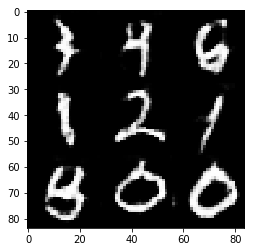

Epoch 2/2... Discriminator Loss: 0.4826... Generator Loss: 1.5020


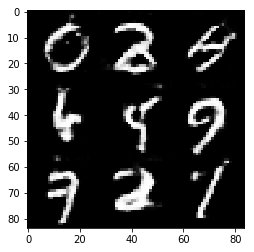

Epoch 2/2... Discriminator Loss: 1.8594... Generator Loss: 0.2524


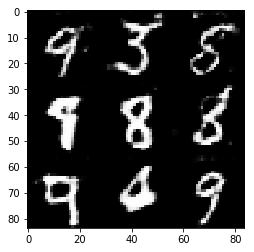

Epoch 2/2... Discriminator Loss: 1.2640... Generator Loss: 0.4824


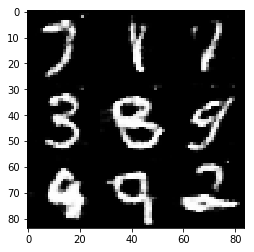

Epoch 2/2... Discriminator Loss: 0.4115... Generator Loss: 1.4418


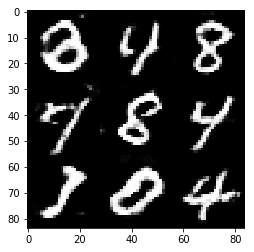

Epoch 2/2... Discriminator Loss: 0.3079... Generator Loss: 1.7864


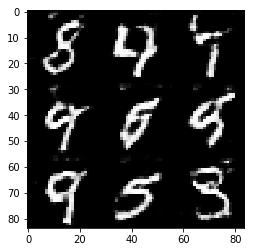

Epoch 2/2... Discriminator Loss: 1.9978... Generator Loss: 0.2562


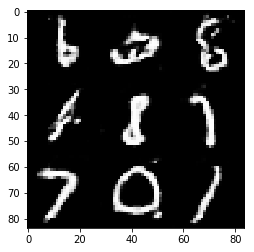

Epoch 2/2... Discriminator Loss: 0.8157... Generator Loss: 0.7379


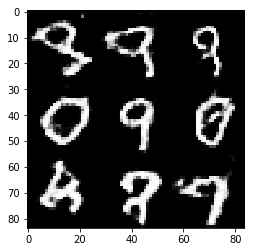

Epoch 2/2... Discriminator Loss: 0.8874... Generator Loss: 0.7986


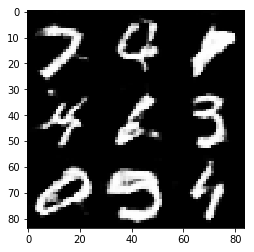

Epoch 2/2... Discriminator Loss: 0.7710... Generator Loss: 0.8625


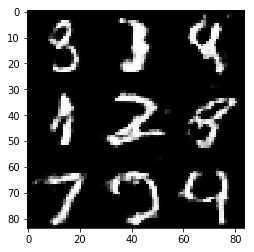

Epoch 2/2... Discriminator Loss: 0.9294... Generator Loss: 3.0813


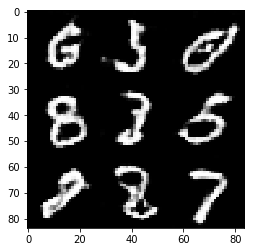

Epoch 2/2... Discriminator Loss: 0.5485... Generator Loss: 1.1361


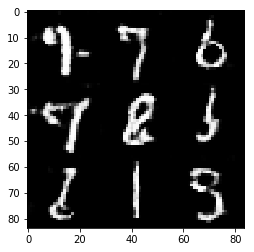

Epoch 2/2... Discriminator Loss: 1.3094... Generator Loss: 0.4870


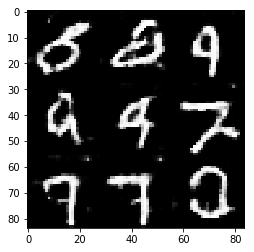

Epoch 2/2... Discriminator Loss: 0.4263... Generator Loss: 1.5797


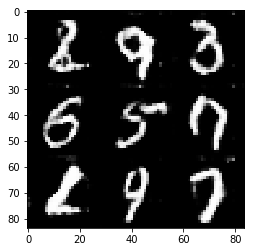

Epoch 2/2... Discriminator Loss: 1.4694... Generator Loss: 0.3760


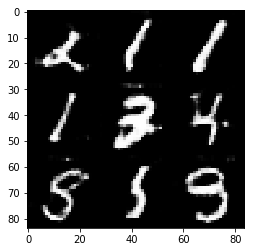

Epoch 2/2... Discriminator Loss: 1.6729... Generator Loss: 0.4301


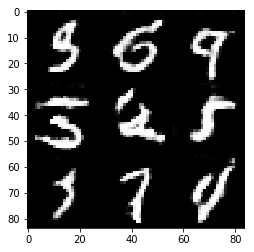

Epoch 2/2... Discriminator Loss: 1.0252... Generator Loss: 0.6799


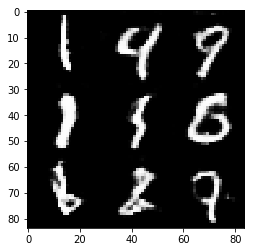

Epoch 2/2... Discriminator Loss: 0.6058... Generator Loss: 1.1325


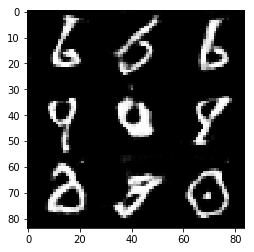

Epoch 2/2... Discriminator Loss: 1.4188... Generator Loss: 0.4526


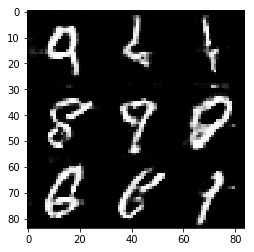

Epoch 2/2... Discriminator Loss: 0.9770... Generator Loss: 0.6441


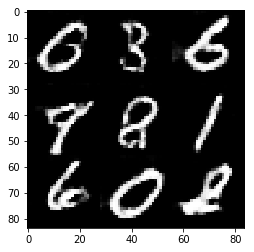

Epoch 2/2... Discriminator Loss: 0.9592... Generator Loss: 0.6909


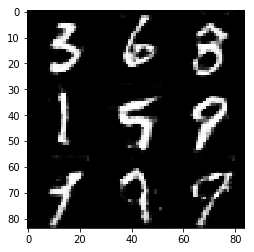

Epoch 2/2... Discriminator Loss: 1.0924... Generator Loss: 0.5265


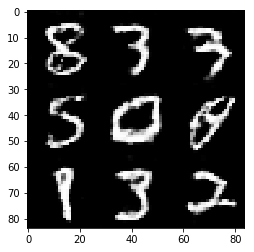

Epoch 2/2... Discriminator Loss: 1.0705... Generator Loss: 0.5676


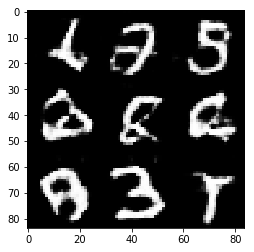

Epoch 2/2... Discriminator Loss: 0.6659... Generator Loss: 1.0235


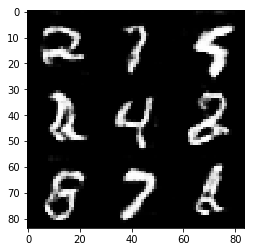

Epoch 2/2... Discriminator Loss: 0.5568... Generator Loss: 1.4365


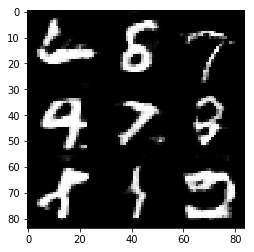

Epoch 2/2... Discriminator Loss: 0.3758... Generator Loss: 1.6844


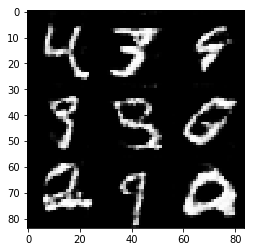

Epoch 2/2... Discriminator Loss: 1.5365... Generator Loss: 0.4358


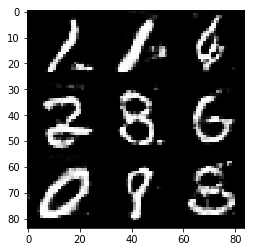

Epoch 2/2... Discriminator Loss: 0.5907... Generator Loss: 1.1706


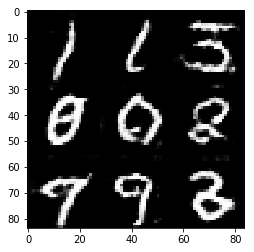

Epoch 2/2... Discriminator Loss: 1.1222... Generator Loss: 0.6176


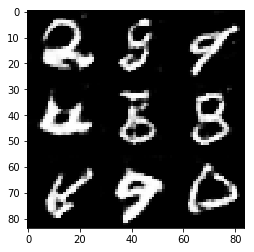

Epoch 2/2... Discriminator Loss: 1.4502... Generator Loss: 0.4257


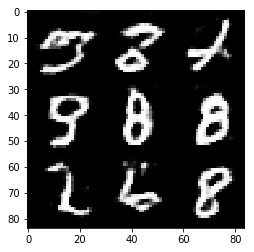

Epoch 2/2... Discriminator Loss: 0.9221... Generator Loss: 0.7534


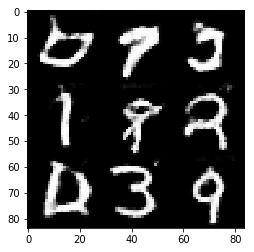

Epoch 2/2... Discriminator Loss: 0.7420... Generator Loss: 0.9329


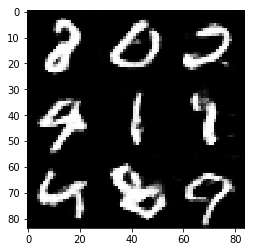

Epoch 2/2... Discriminator Loss: 0.7302... Generator Loss: 2.3672


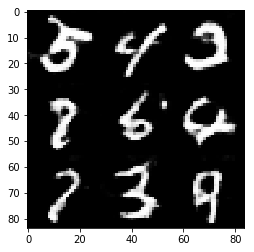

Epoch 2/2... Discriminator Loss: 0.5193... Generator Loss: 1.3917


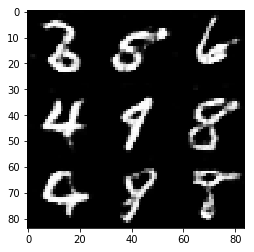

Epoch 2/2... Discriminator Loss: 0.7273... Generator Loss: 0.9274


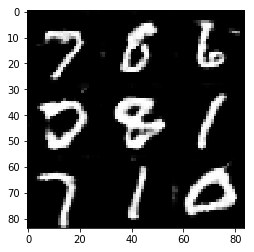

Epoch 2/2... Discriminator Loss: 0.3360... Generator Loss: 1.6785


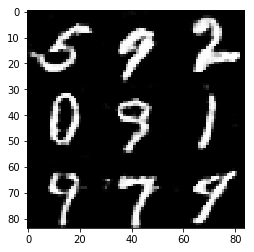

Epoch 2/2... Discriminator Loss: 0.4147... Generator Loss: 1.6893


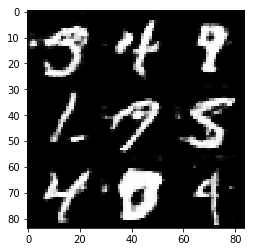

Epoch 2/2... Discriminator Loss: 0.2626... Generator Loss: 2.2029


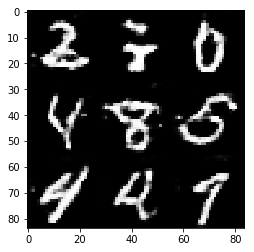

Epoch 2/2... Discriminator Loss: 0.5729... Generator Loss: 1.3535


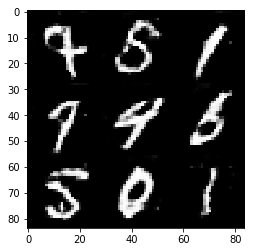

Epoch 2/2... Discriminator Loss: 0.6261... Generator Loss: 1.0680


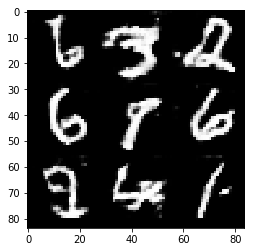

Epoch 2/2... Discriminator Loss: 0.8256... Generator Loss: 0.9126


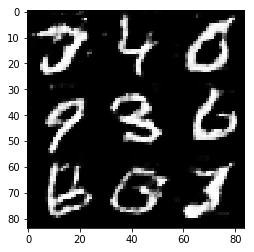

Epoch 2/2... Discriminator Loss: 0.5296... Generator Loss: 1.3098


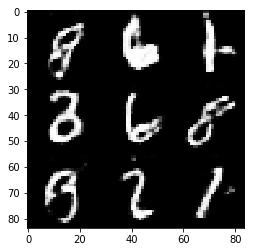

Epoch 2/2... Discriminator Loss: 0.7835... Generator Loss: 1.9181


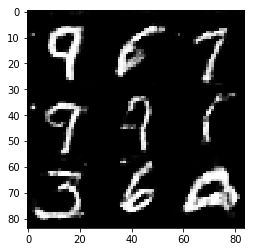

Epoch 2/2... Discriminator Loss: 0.3812... Generator Loss: 1.6797


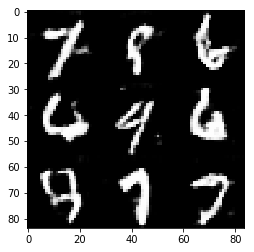

Epoch 2/2... Discriminator Loss: 1.0450... Generator Loss: 0.5765


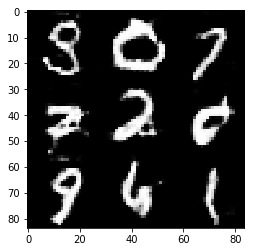

Epoch 2/2... Discriminator Loss: 0.4759... Generator Loss: 1.2910


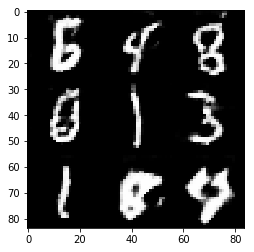

Epoch 2/2... Discriminator Loss: 0.8351... Generator Loss: 0.8445


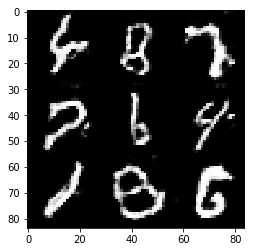

Epoch 2/2... Discriminator Loss: 0.6635... Generator Loss: 1.0005


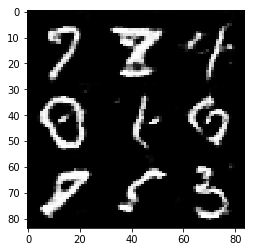

Epoch 2/2... Discriminator Loss: 0.4624... Generator Loss: 1.4633


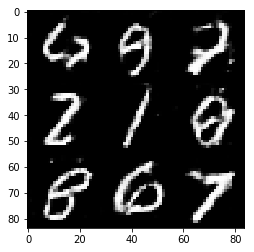

Epoch 2/2... Discriminator Loss: 0.5085... Generator Loss: 1.1642


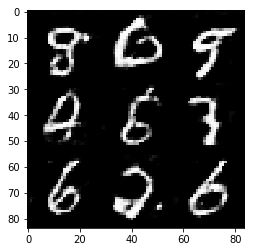

Epoch 2/2... Discriminator Loss: 0.8367... Generator Loss: 0.7824


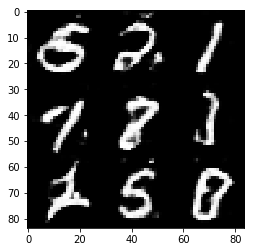

Epoch 2/2... Discriminator Loss: 0.7186... Generator Loss: 3.1730


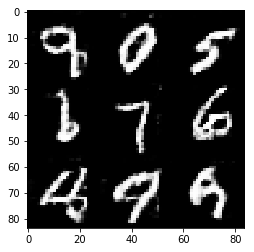

Epoch 2/2... Discriminator Loss: 0.6712... Generator Loss: 1.1057


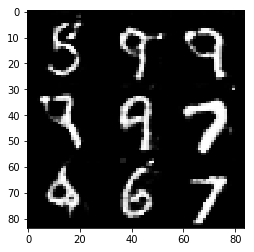

Epoch 2/2... Discriminator Loss: 0.2751... Generator Loss: 2.1354


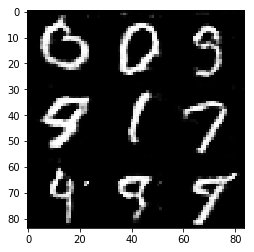

Epoch 2/2... Discriminator Loss: 0.6041... Generator Loss: 1.1871


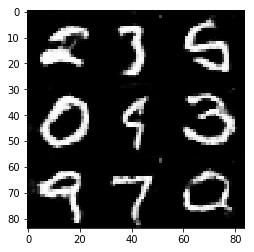

Epoch 2/2... Discriminator Loss: 3.4549... Generator Loss: 6.5941


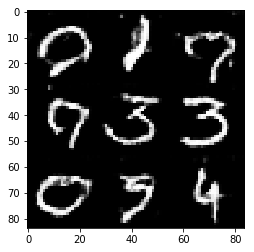

Epoch 2/2... Discriminator Loss: 1.0485... Generator Loss: 0.6679


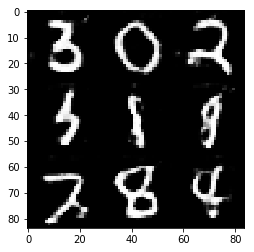

Epoch 2/2... Discriminator Loss: 0.7978... Generator Loss: 0.9463


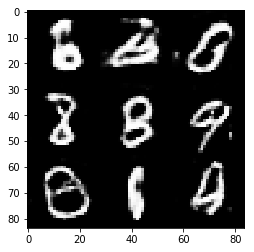

Epoch 2/2... Discriminator Loss: 1.2891... Generator Loss: 0.4578


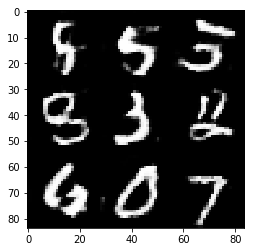

Epoch 2/2... Discriminator Loss: 0.6931... Generator Loss: 1.0148


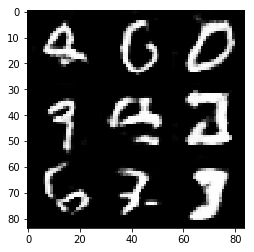

Epoch 2/2... Discriminator Loss: 0.7470... Generator Loss: 0.8701


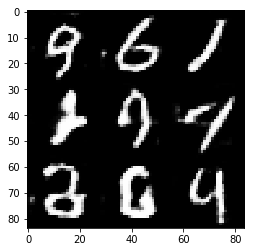

Epoch 2/2... Discriminator Loss: 1.5219... Generator Loss: 0.4478


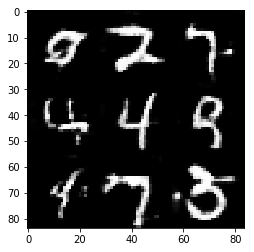

Epoch 2/2... Discriminator Loss: 0.8860... Generator Loss: 0.9456


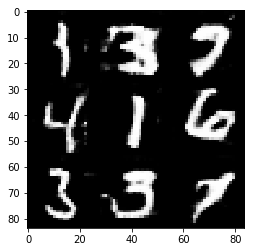

Epoch 2/2... Discriminator Loss: 0.6831... Generator Loss: 1.8191


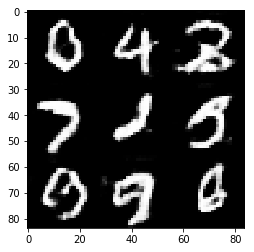

Epoch 2/2... Discriminator Loss: 0.9892... Generator Loss: 0.6667


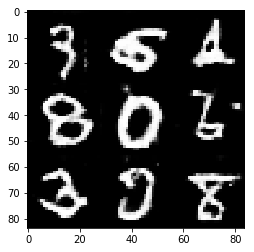

Epoch 2/2... Discriminator Loss: 0.7309... Generator Loss: 0.8834


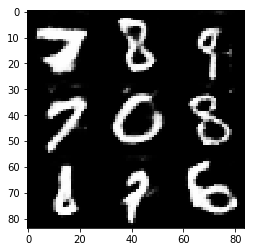

Epoch 2/2... Discriminator Loss: 0.3676... Generator Loss: 1.8623


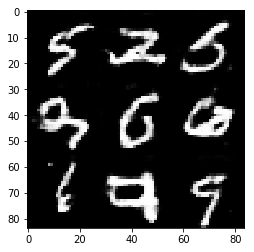

Epoch 2/2... Discriminator Loss: 0.7571... Generator Loss: 0.8825


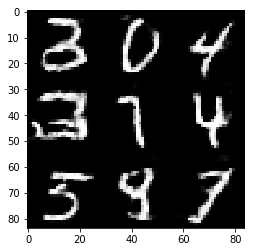

Epoch 2/2... Discriminator Loss: 0.9594... Generator Loss: 0.7603


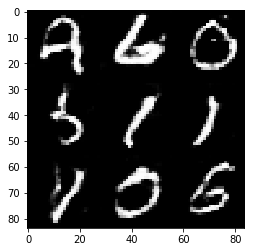

Epoch 2/2... Discriminator Loss: 0.5543... Generator Loss: 1.3424


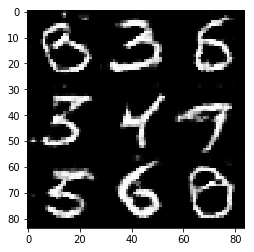

Epoch 2/2... Discriminator Loss: 0.5799... Generator Loss: 1.2728


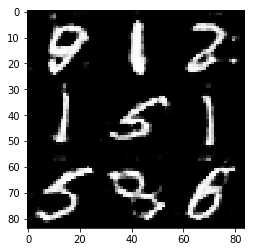

Epoch 2/2... Discriminator Loss: 0.5941... Generator Loss: 1.4637


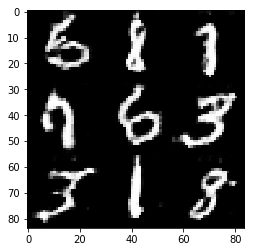

Epoch 2/2... Discriminator Loss: 1.6665... Generator Loss: 0.3693


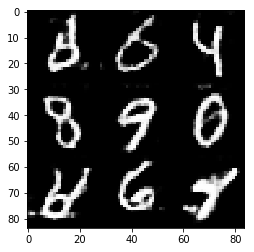

Epoch 2/2... Discriminator Loss: 0.5158... Generator Loss: 1.3722


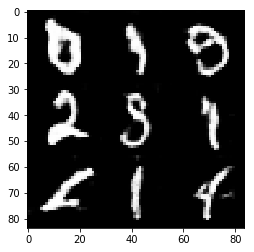

Epoch 2/2... Discriminator Loss: 0.4635... Generator Loss: 1.5509


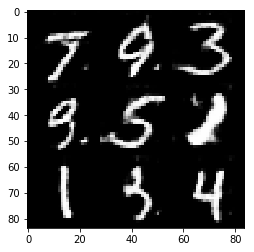

Epoch 2/2... Discriminator Loss: 0.6825... Generator Loss: 0.9570


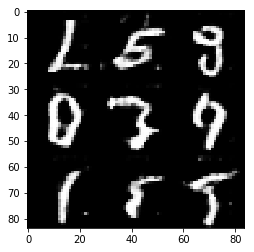

Epoch 2/2... Discriminator Loss: 0.2671... Generator Loss: 2.0121


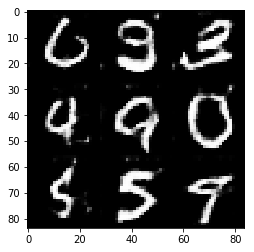

Epoch 2/2... Discriminator Loss: 0.6358... Generator Loss: 1.0735


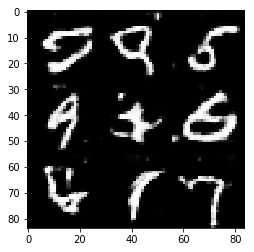

Epoch 2/2... Discriminator Loss: 0.2528... Generator Loss: 1.9111


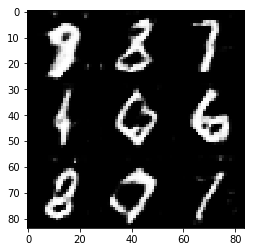

Epoch 2/2... Discriminator Loss: 1.3462... Generator Loss: 0.4934


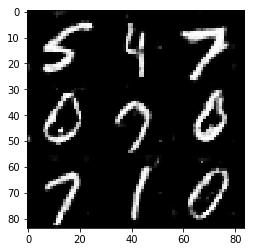

Epoch 2/2... Discriminator Loss: 0.6536... Generator Loss: 0.9337


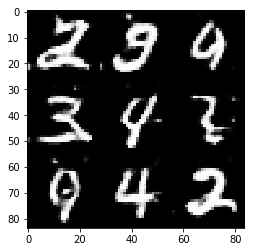

Epoch 2/2... Discriminator Loss: 0.4580... Generator Loss: 1.3327


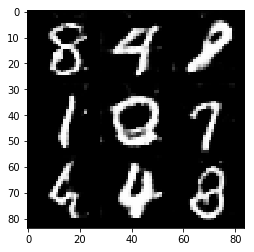

Epoch 2/2... Discriminator Loss: 1.6053... Generator Loss: 0.3160


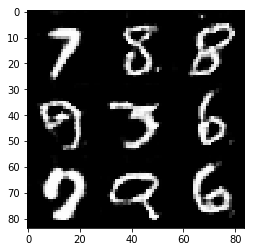

Epoch 2/2... Discriminator Loss: 0.6896... Generator Loss: 1.0488


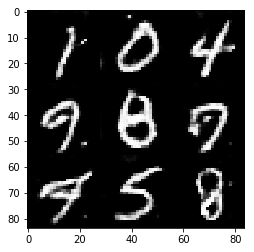

Epoch 2/2... Discriminator Loss: 0.4695... Generator Loss: 1.2816


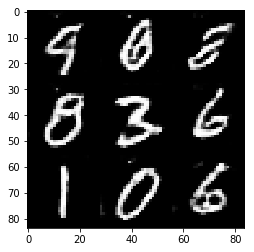

Epoch 2/2... Discriminator Loss: 0.8496... Generator Loss: 0.8533


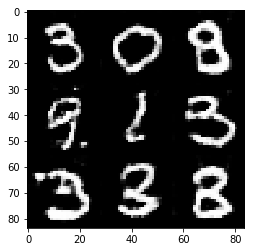

Epoch 2/2... Discriminator Loss: 2.8775... Generator Loss: 0.1677


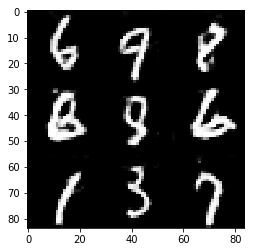

Epoch 2/2... Discriminator Loss: 1.3035... Generator Loss: 0.5365


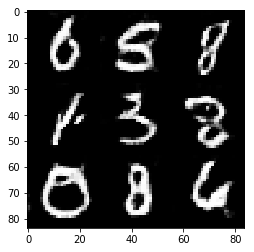

Epoch 2/2... Discriminator Loss: 0.5228... Generator Loss: 2.2200


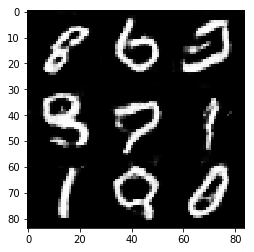

Epoch 2/2... Discriminator Loss: 0.4680... Generator Loss: 1.4177


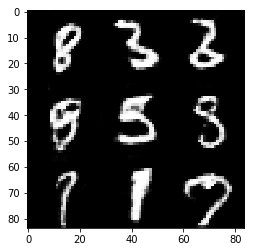

Epoch 2/2... Discriminator Loss: 0.4109... Generator Loss: 2.9326


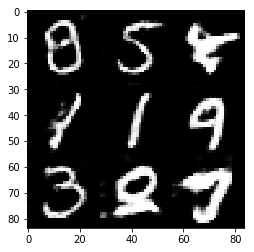

Epoch 2/2... Discriminator Loss: 0.7160... Generator Loss: 2.2867


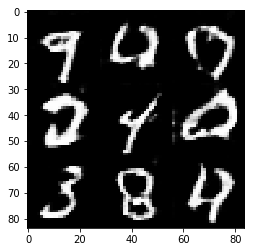

Epoch 2/2... Discriminator Loss: 1.3792... Generator Loss: 0.4720


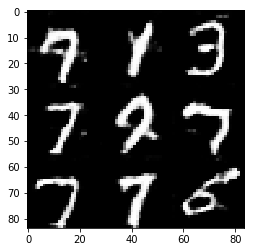

Epoch 2/2... Discriminator Loss: 0.3958... Generator Loss: 1.7048


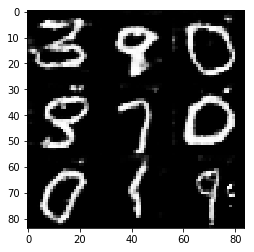

Epoch 2/2... Discriminator Loss: 0.6474... Generator Loss: 1.2387


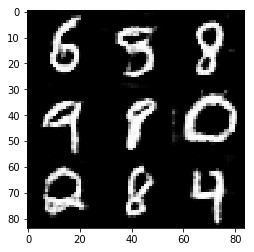

Epoch 2/2... Discriminator Loss: 0.4809... Generator Loss: 1.3393


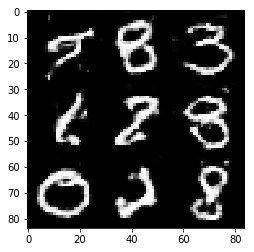

Epoch 2/2... Discriminator Loss: 0.7041... Generator Loss: 1.0536


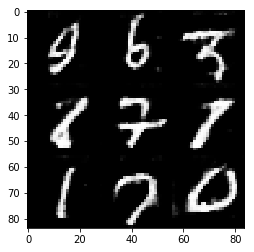

Epoch 2/2... Discriminator Loss: 0.5302... Generator Loss: 2.9931


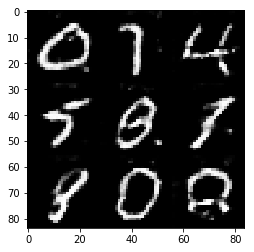

Epoch 2/2... Discriminator Loss: 0.9468... Generator Loss: 0.8102


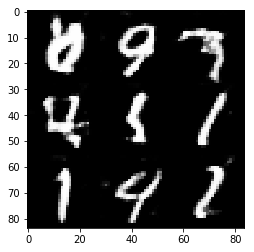

Epoch 2/2... Discriminator Loss: 1.2413... Generator Loss: 0.5997


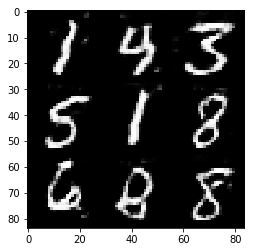

Epoch 2/2... Discriminator Loss: 0.7716... Generator Loss: 0.8534


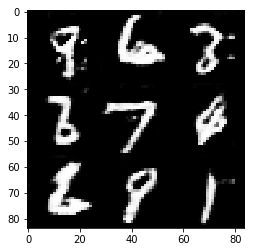

Epoch 2/2... Discriminator Loss: 0.8954... Generator Loss: 1.2792


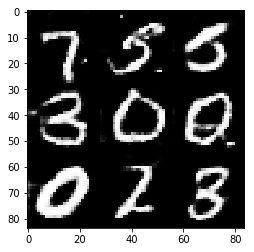

Epoch 2/2... Discriminator Loss: 3.1747... Generator Loss: 0.1099


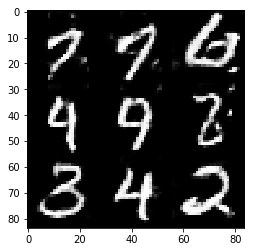

Epoch 2/2... Discriminator Loss: 0.3609... Generator Loss: 1.5083


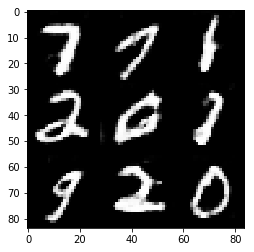

Epoch 2/2... Discriminator Loss: 0.7991... Generator Loss: 1.0426


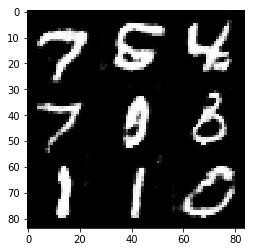

Epoch 2/2... Discriminator Loss: 0.6703... Generator Loss: 1.0602


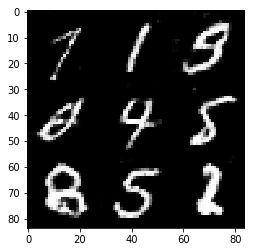

Epoch 2/2... Discriminator Loss: 1.4880... Generator Loss: 0.3567


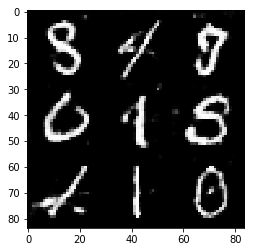

Epoch 2/2... Discriminator Loss: 0.5192... Generator Loss: 1.1625


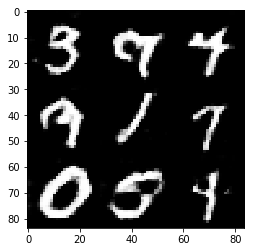

Epoch 2/2... Discriminator Loss: 0.9370... Generator Loss: 0.8194


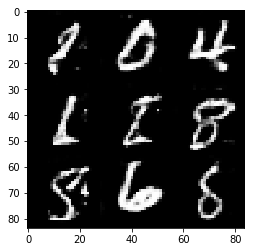

Epoch 2/2... Discriminator Loss: 0.4490... Generator Loss: 1.6881


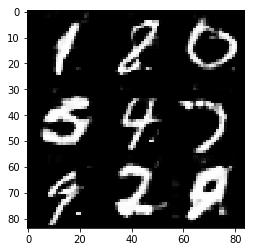

Epoch 2/2... Discriminator Loss: 0.6051... Generator Loss: 1.0807


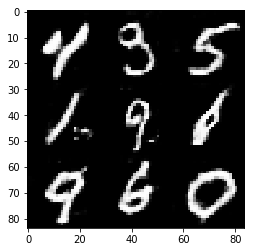

Epoch 2/2... Discriminator Loss: 0.8191... Generator Loss: 0.8385


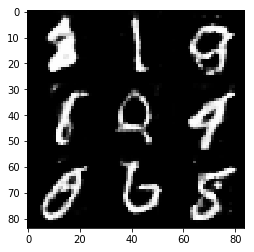

Epoch 2/2... Discriminator Loss: 0.6044... Generator Loss: 1.8679


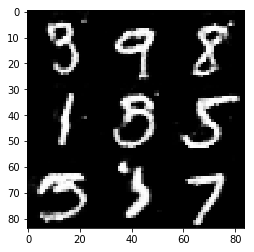

Epoch 2/2... Discriminator Loss: 0.8681... Generator Loss: 3.7297


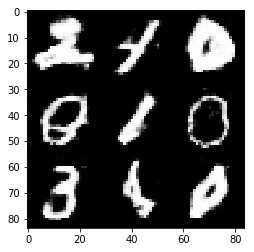

Epoch 2/2... Discriminator Loss: 0.5239... Generator Loss: 1.3771


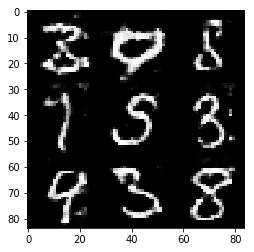

Epoch 2/2... Discriminator Loss: 0.5630... Generator Loss: 1.1708


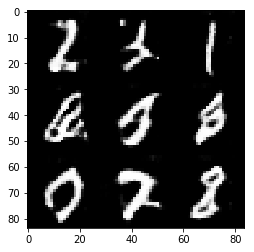

Epoch 2/2... Discriminator Loss: 1.6636... Generator Loss: 0.3338


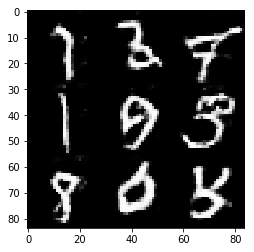

Epoch 2/2... Discriminator Loss: 0.3395... Generator Loss: 1.5938


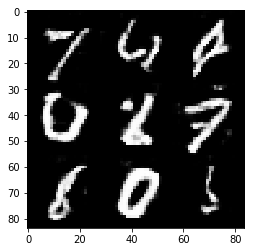

In [12]:
batch_size = 32 # recommended by reviewer, batch_size and learning_rate should be correlated
z_dim = 100
learning_rate = 0.0004 # recommended by reviewer, said DCGAN is stable between 0.0001 and 0.0008
beta1 = 0.3 # recommended by reviewer, said best values between 0.1 and 0.3
tf.reset_default_graph()

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
print(mnist_dataset.shape[3])
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

<div class="alert alert-block alert-warning">
<b>Caution:</b> The training process takes a good bit of time.  If you are reviewing the code and wish to just see the results, scroll through the output of the cell below.
</div>

Epoch 1/1... Discriminator Loss: 3.6499... Generator Loss: 0.0428


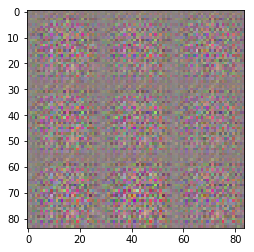

Epoch 1/1... Discriminator Loss: 0.9550... Generator Loss: 0.6522


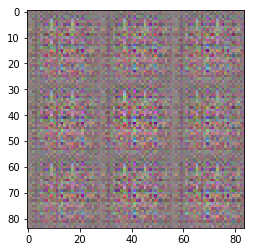

Epoch 1/1... Discriminator Loss: 0.1271... Generator Loss: 6.9276


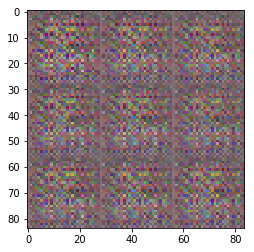

Epoch 1/1... Discriminator Loss: 1.9212... Generator Loss: 0.1798


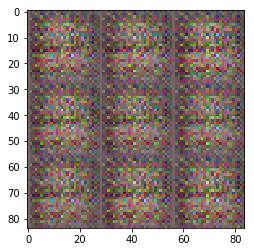

Epoch 1/1... Discriminator Loss: 0.4674... Generator Loss: 1.1485


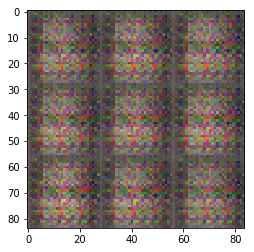

Epoch 1/1... Discriminator Loss: 0.8122... Generator Loss: 0.6954


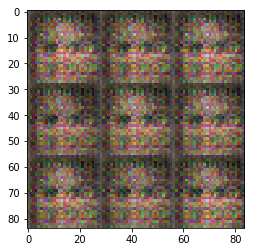

Epoch 1/1... Discriminator Loss: 1.3812... Generator Loss: 0.6680


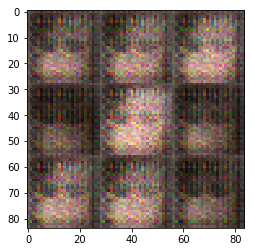

Epoch 1/1... Discriminator Loss: 1.5235... Generator Loss: 0.4786


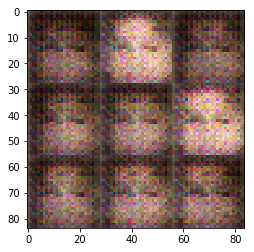

Epoch 1/1... Discriminator Loss: 1.8688... Generator Loss: 0.2969


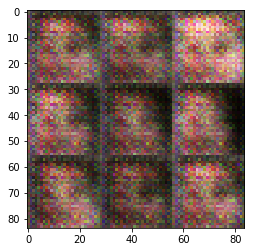

Epoch 1/1... Discriminator Loss: 1.6302... Generator Loss: 0.6952


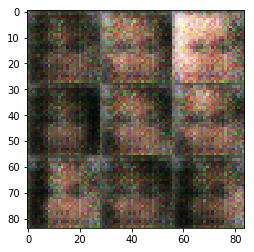

Epoch 1/1... Discriminator Loss: 1.1342... Generator Loss: 0.9191


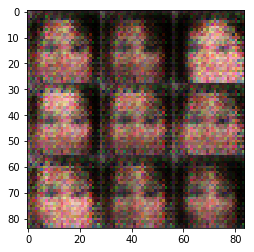

Epoch 1/1... Discriminator Loss: 0.9412... Generator Loss: 1.1702


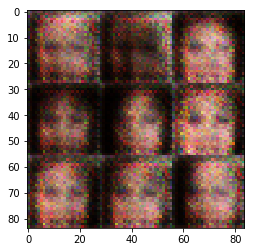

Epoch 1/1... Discriminator Loss: 1.7766... Generator Loss: 0.2744


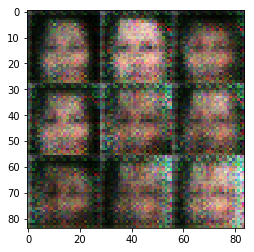

Epoch 1/1... Discriminator Loss: 1.3131... Generator Loss: 0.7534


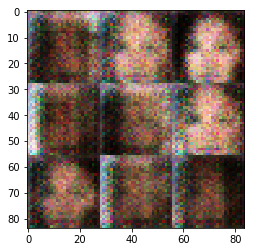

Epoch 1/1... Discriminator Loss: 1.4146... Generator Loss: 0.4506


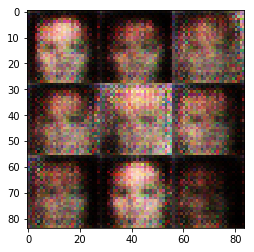

Epoch 1/1... Discriminator Loss: 1.2552... Generator Loss: 0.5056


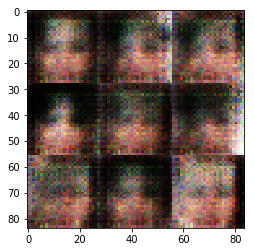

Epoch 1/1... Discriminator Loss: 1.8131... Generator Loss: 0.3187


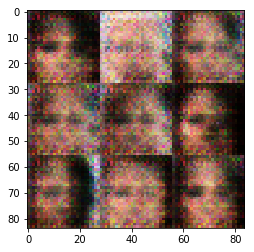

Epoch 1/1... Discriminator Loss: 1.5706... Generator Loss: 0.5834


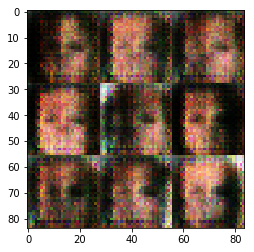

Epoch 1/1... Discriminator Loss: 1.2730... Generator Loss: 0.6742


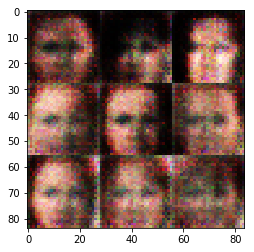

Epoch 1/1... Discriminator Loss: 1.4740... Generator Loss: 0.5890


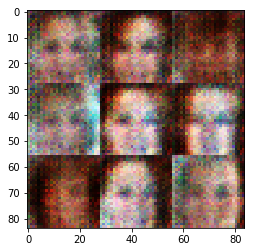

Epoch 1/1... Discriminator Loss: 1.5396... Generator Loss: 0.3741


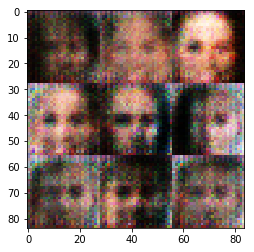

Epoch 1/1... Discriminator Loss: 1.3353... Generator Loss: 0.6650


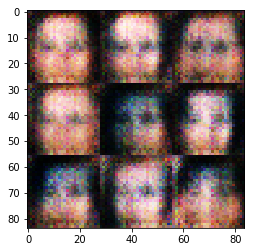

Epoch 1/1... Discriminator Loss: 1.6213... Generator Loss: 0.3532


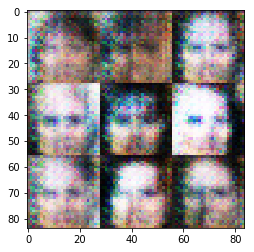

Epoch 1/1... Discriminator Loss: 1.2733... Generator Loss: 0.6842


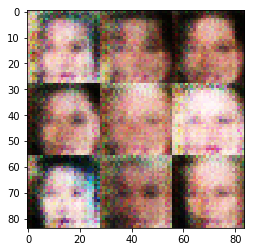

Epoch 1/1... Discriminator Loss: 1.4029... Generator Loss: 0.5850


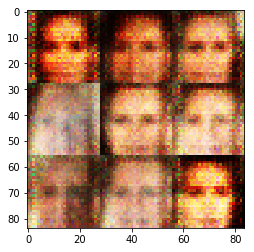

Epoch 1/1... Discriminator Loss: 1.3341... Generator Loss: 0.5163


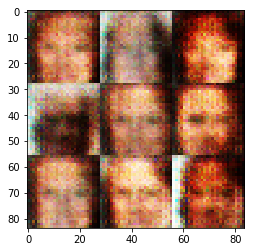

Epoch 1/1... Discriminator Loss: 1.0350... Generator Loss: 0.7871


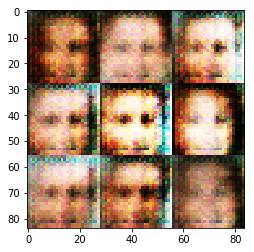

Epoch 1/1... Discriminator Loss: 1.3624... Generator Loss: 0.7821


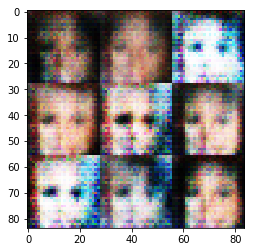

Epoch 1/1... Discriminator Loss: 1.2506... Generator Loss: 0.6285


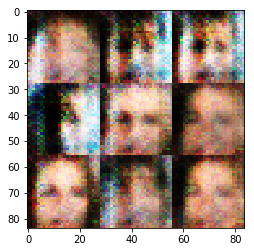

Epoch 1/1... Discriminator Loss: 1.4013... Generator Loss: 0.5567


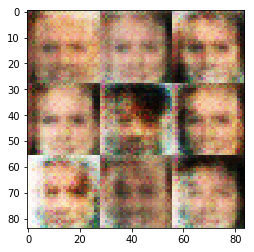

Epoch 1/1... Discriminator Loss: 1.4442... Generator Loss: 0.4684


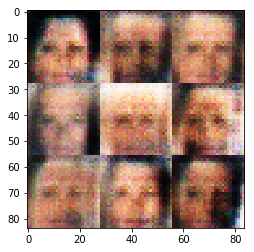

Epoch 1/1... Discriminator Loss: 1.2625... Generator Loss: 0.9006


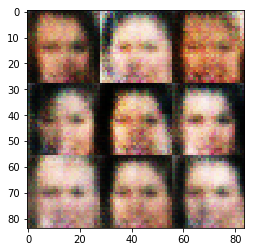

Epoch 1/1... Discriminator Loss: 1.5784... Generator Loss: 0.6720


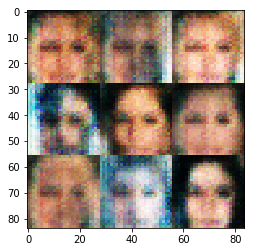

Epoch 1/1... Discriminator Loss: 1.3514... Generator Loss: 0.8896


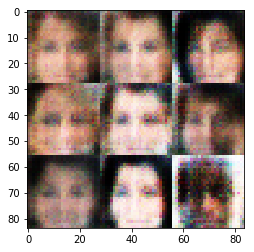

Epoch 1/1... Discriminator Loss: 1.4383... Generator Loss: 0.6406


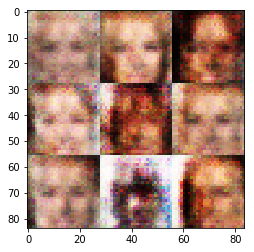

Epoch 1/1... Discriminator Loss: 1.4176... Generator Loss: 0.5798


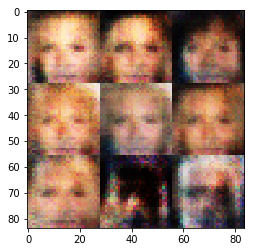

Epoch 1/1... Discriminator Loss: 1.2897... Generator Loss: 0.6834


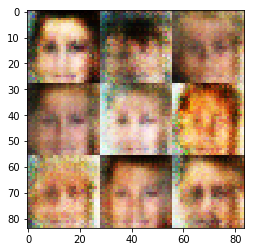

Epoch 1/1... Discriminator Loss: 1.3509... Generator Loss: 0.7488


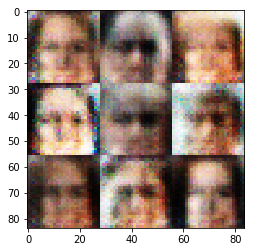

Epoch 1/1... Discriminator Loss: 1.3000... Generator Loss: 0.5185


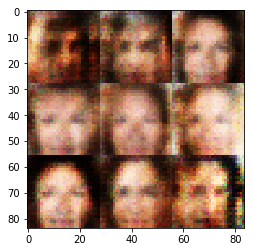

Epoch 1/1... Discriminator Loss: 1.2438... Generator Loss: 0.7788


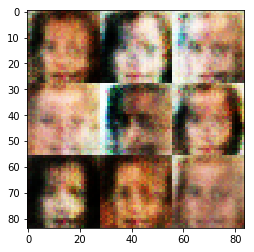

Epoch 1/1... Discriminator Loss: 1.2679... Generator Loss: 0.4848


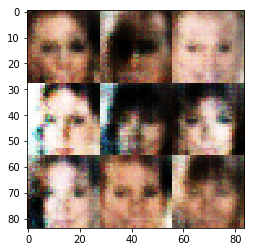

Epoch 1/1... Discriminator Loss: 1.2354... Generator Loss: 1.1361


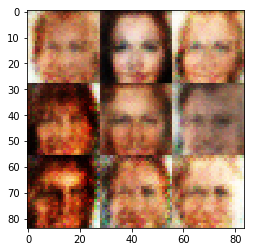

Epoch 1/1... Discriminator Loss: 1.1600... Generator Loss: 0.8454


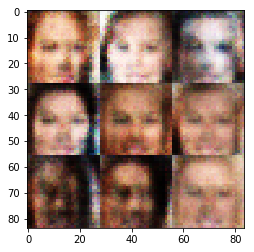

Epoch 1/1... Discriminator Loss: 1.2773... Generator Loss: 1.0932


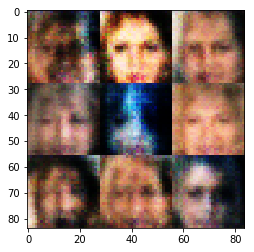

Epoch 1/1... Discriminator Loss: 1.0987... Generator Loss: 0.7081


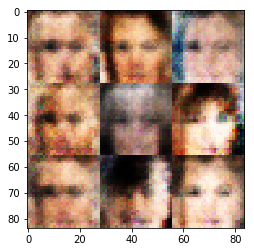

Epoch 1/1... Discriminator Loss: 1.2482... Generator Loss: 0.7255


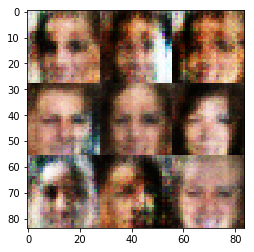

Epoch 1/1... Discriminator Loss: 1.2463... Generator Loss: 0.6677


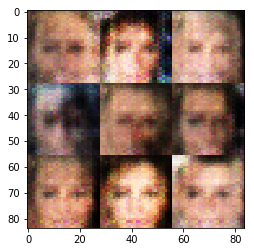

Epoch 1/1... Discriminator Loss: 1.3071... Generator Loss: 0.5394


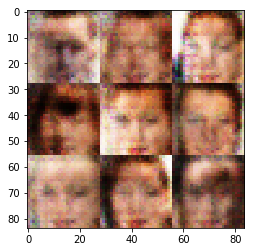

Epoch 1/1... Discriminator Loss: 1.1418... Generator Loss: 0.9311


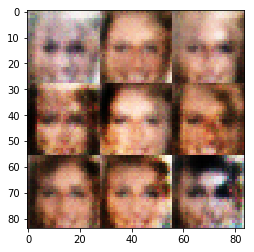

Epoch 1/1... Discriminator Loss: 1.3899... Generator Loss: 0.4525


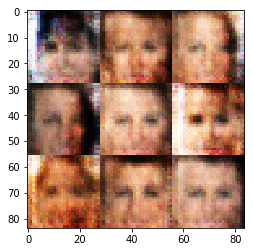

Epoch 1/1... Discriminator Loss: 1.2047... Generator Loss: 0.8863


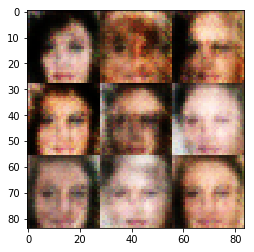

Epoch 1/1... Discriminator Loss: 1.1254... Generator Loss: 0.8692


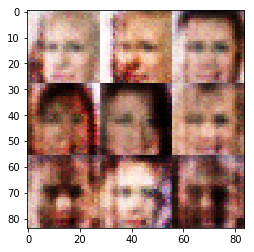

Epoch 1/1... Discriminator Loss: 1.2567... Generator Loss: 0.7233


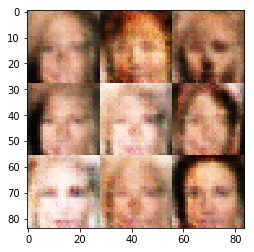

Epoch 1/1... Discriminator Loss: 1.3287... Generator Loss: 0.5863


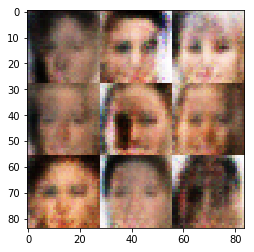

Epoch 1/1... Discriminator Loss: 1.2656... Generator Loss: 0.6936


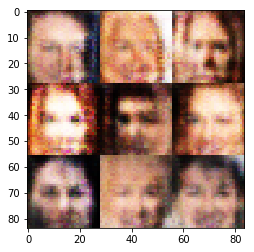

Epoch 1/1... Discriminator Loss: 1.3215... Generator Loss: 0.7073


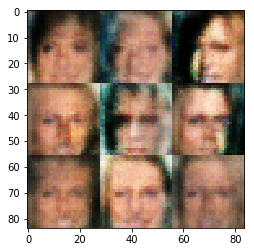

Epoch 1/1... Discriminator Loss: 1.1958... Generator Loss: 0.7218


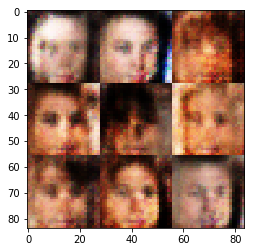

Epoch 1/1... Discriminator Loss: 1.4414... Generator Loss: 0.6536


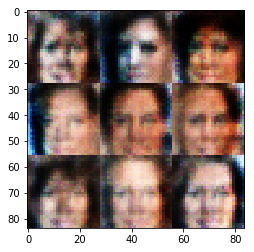

Epoch 1/1... Discriminator Loss: 1.2893... Generator Loss: 0.6222


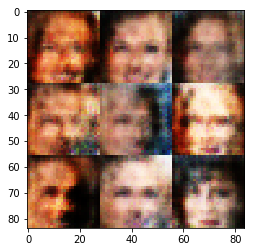

Epoch 1/1... Discriminator Loss: 1.0892... Generator Loss: 0.7057


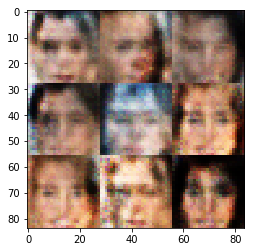

Epoch 1/1... Discriminator Loss: 1.2650... Generator Loss: 0.6520


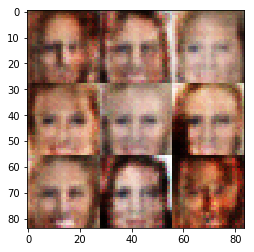

Epoch 1/1... Discriminator Loss: 1.5768... Generator Loss: 0.2990


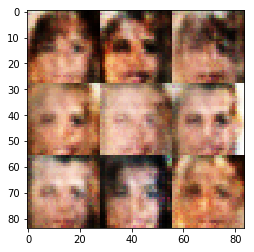

Epoch 1/1... Discriminator Loss: 1.3454... Generator Loss: 0.7939


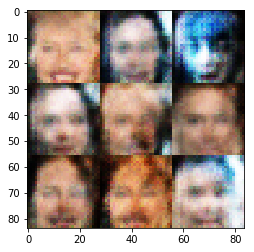

Epoch 1/1... Discriminator Loss: 1.3163... Generator Loss: 1.4627


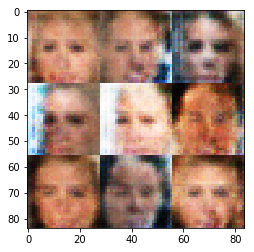

Epoch 1/1... Discriminator Loss: 1.2389... Generator Loss: 0.7034


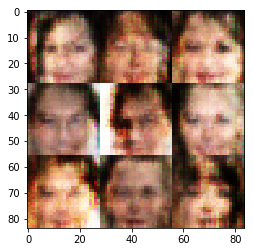

Epoch 1/1... Discriminator Loss: 1.3800... Generator Loss: 0.4849


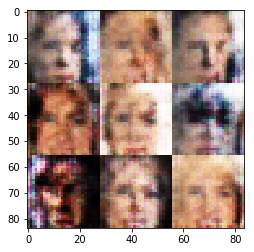

Epoch 1/1... Discriminator Loss: 1.2431... Generator Loss: 0.5835


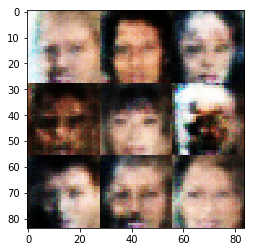

Epoch 1/1... Discriminator Loss: 1.5477... Generator Loss: 1.1465


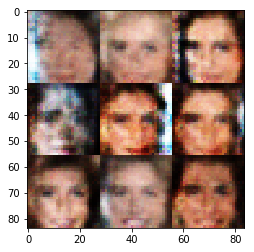

Epoch 1/1... Discriminator Loss: 1.3590... Generator Loss: 1.1044


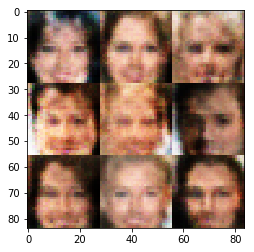

Epoch 1/1... Discriminator Loss: 1.1563... Generator Loss: 0.8309


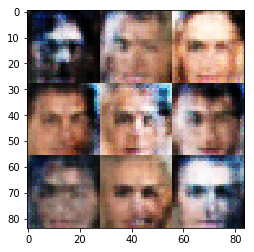

Epoch 1/1... Discriminator Loss: 1.1348... Generator Loss: 0.9164


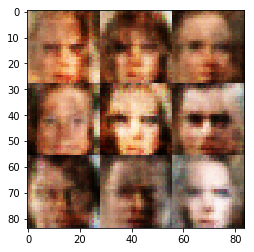

Epoch 1/1... Discriminator Loss: 1.1875... Generator Loss: 0.7095


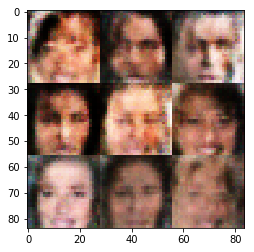

Epoch 1/1... Discriminator Loss: 1.4222... Generator Loss: 0.4970


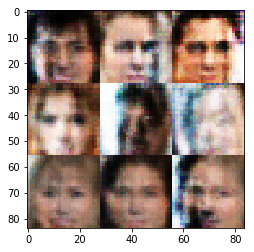

Epoch 1/1... Discriminator Loss: 1.1379... Generator Loss: 1.0608


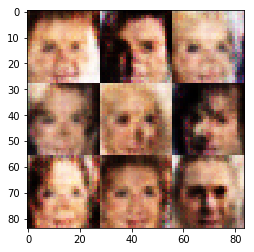

Epoch 1/1... Discriminator Loss: 1.3144... Generator Loss: 0.7434


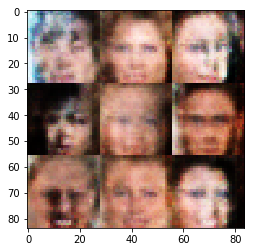

Epoch 1/1... Discriminator Loss: 1.1041... Generator Loss: 0.8230


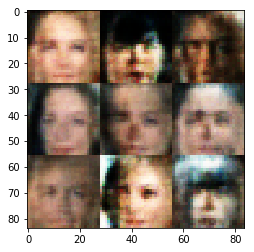

Epoch 1/1... Discriminator Loss: 1.2572... Generator Loss: 0.7748


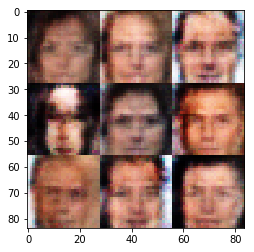

Epoch 1/1... Discriminator Loss: 1.1574... Generator Loss: 0.5941


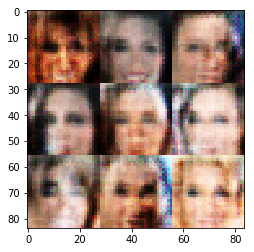

Epoch 1/1... Discriminator Loss: 1.3121... Generator Loss: 0.6342


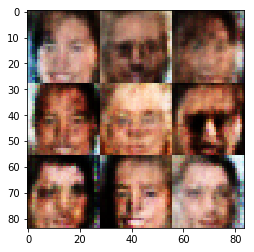

Epoch 1/1... Discriminator Loss: 1.1852... Generator Loss: 1.0204


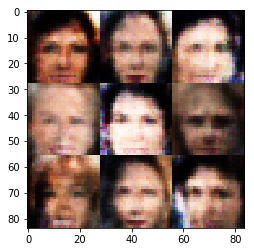

Epoch 1/1... Discriminator Loss: 1.1250... Generator Loss: 0.8343


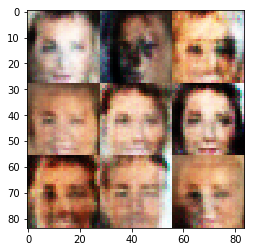

Epoch 1/1... Discriminator Loss: 1.4860... Generator Loss: 1.9536


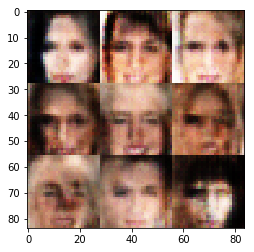

Epoch 1/1... Discriminator Loss: 1.1889... Generator Loss: 0.6222


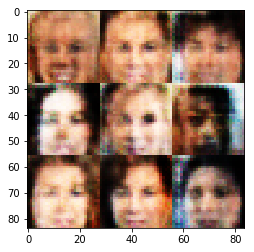

Epoch 1/1... Discriminator Loss: 1.1923... Generator Loss: 0.6321


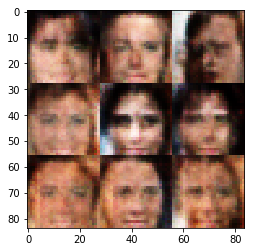

Epoch 1/1... Discriminator Loss: 1.0523... Generator Loss: 0.6996


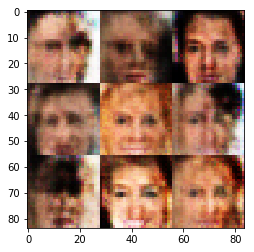

Epoch 1/1... Discriminator Loss: 1.3947... Generator Loss: 0.4331


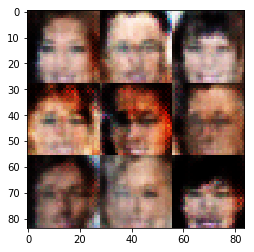

Epoch 1/1... Discriminator Loss: 1.2230... Generator Loss: 0.9172


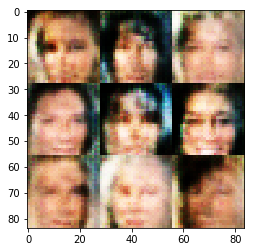

Epoch 1/1... Discriminator Loss: 1.2162... Generator Loss: 0.5850


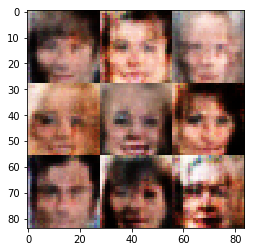

Epoch 1/1... Discriminator Loss: 1.3553... Generator Loss: 0.7146


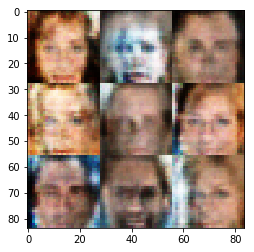

Epoch 1/1... Discriminator Loss: 1.0565... Generator Loss: 1.9275


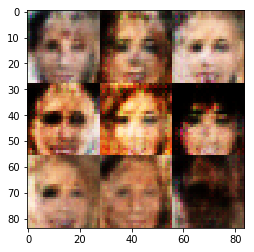

Epoch 1/1... Discriminator Loss: 0.9840... Generator Loss: 1.2659


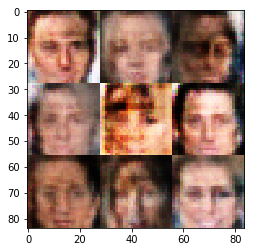

Epoch 1/1... Discriminator Loss: 0.9934... Generator Loss: 0.9296


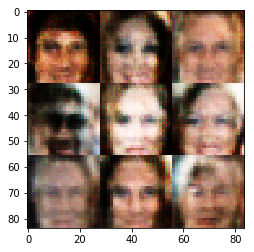

Epoch 1/1... Discriminator Loss: 1.0781... Generator Loss: 0.8618


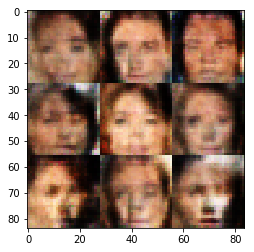

Epoch 1/1... Discriminator Loss: 1.1772... Generator Loss: 0.9120


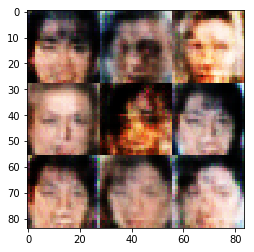

Epoch 1/1... Discriminator Loss: 0.8041... Generator Loss: 1.1292


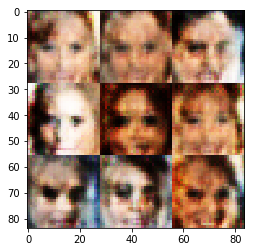

Epoch 1/1... Discriminator Loss: 1.1780... Generator Loss: 0.7901


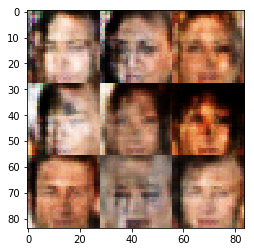

Epoch 1/1... Discriminator Loss: 1.1484... Generator Loss: 0.7408


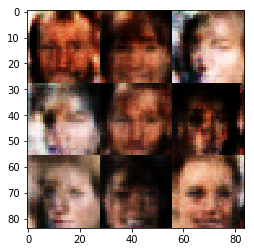

Epoch 1/1... Discriminator Loss: 1.4064... Generator Loss: 0.4078


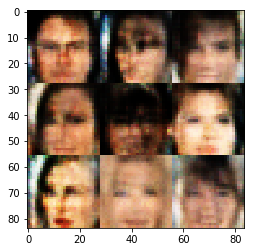

Epoch 1/1... Discriminator Loss: 1.1453... Generator Loss: 0.9923


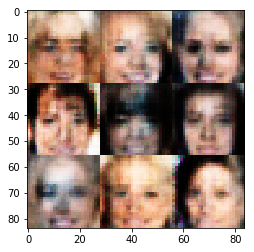

Epoch 1/1... Discriminator Loss: 1.3217... Generator Loss: 0.8254


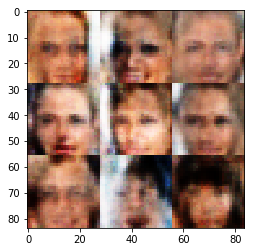

Epoch 1/1... Discriminator Loss: 0.9543... Generator Loss: 1.1595


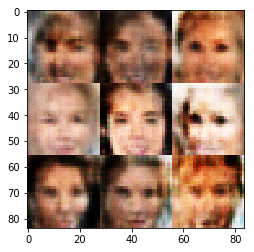

Epoch 1/1... Discriminator Loss: 0.8073... Generator Loss: 1.0996


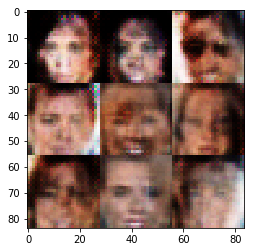

Epoch 1/1... Discriminator Loss: 2.4999... Generator Loss: 2.9646


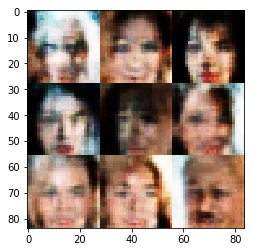

Epoch 1/1... Discriminator Loss: 0.9009... Generator Loss: 1.1405


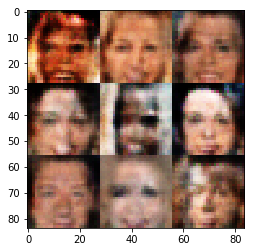

Epoch 1/1... Discriminator Loss: 1.1962... Generator Loss: 1.0079


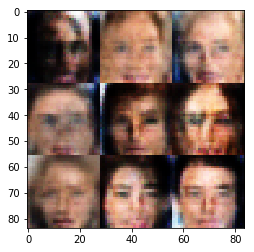

Epoch 1/1... Discriminator Loss: 1.4108... Generator Loss: 0.4103


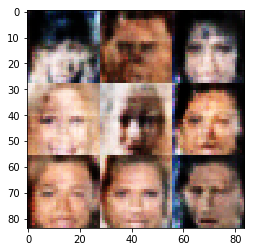

Epoch 1/1... Discriminator Loss: 0.9433... Generator Loss: 1.3074


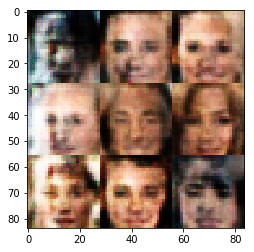

Epoch 1/1... Discriminator Loss: 1.2685... Generator Loss: 0.5030


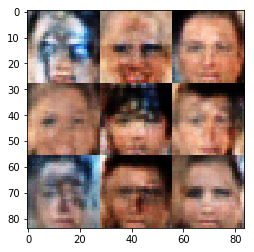

Epoch 1/1... Discriminator Loss: 1.3418... Generator Loss: 0.4290


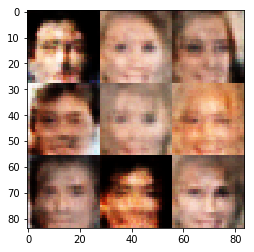

Epoch 1/1... Discriminator Loss: 0.8746... Generator Loss: 1.0251


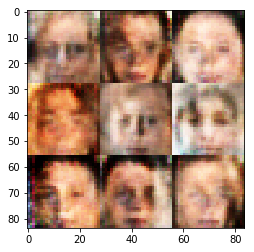

Epoch 1/1... Discriminator Loss: 1.0110... Generator Loss: 0.7030


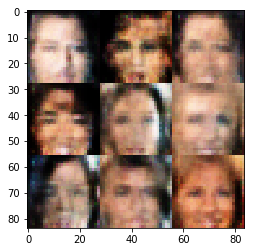

Epoch 1/1... Discriminator Loss: 1.2243... Generator Loss: 0.5450


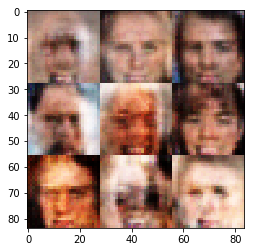

Epoch 1/1... Discriminator Loss: 0.9308... Generator Loss: 0.9754


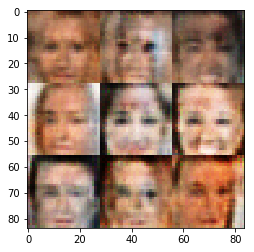

Epoch 1/1... Discriminator Loss: 2.1546... Generator Loss: 0.1471


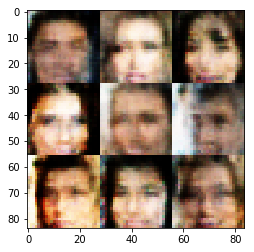

Epoch 1/1... Discriminator Loss: 1.1952... Generator Loss: 0.6625


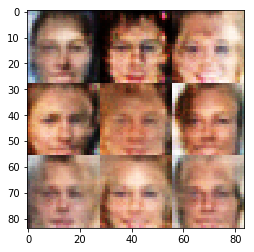

Epoch 1/1... Discriminator Loss: 1.1841... Generator Loss: 1.2707


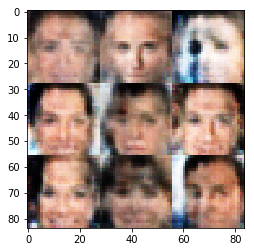

Epoch 1/1... Discriminator Loss: 1.4124... Generator Loss: 0.4085


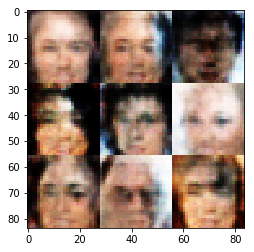

Epoch 1/1... Discriminator Loss: 1.2023... Generator Loss: 0.4981


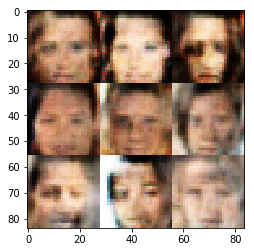

Epoch 1/1... Discriminator Loss: 1.3747... Generator Loss: 0.5501


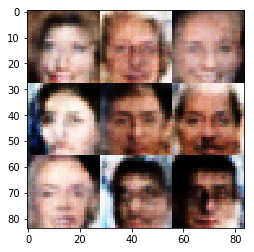

Epoch 1/1... Discriminator Loss: 0.8439... Generator Loss: 0.9591


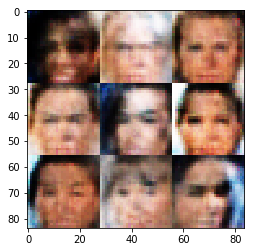

Epoch 1/1... Discriminator Loss: 1.4422... Generator Loss: 0.4070


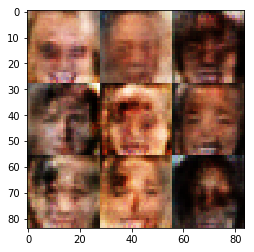

Epoch 1/1... Discriminator Loss: 1.2083... Generator Loss: 0.7470


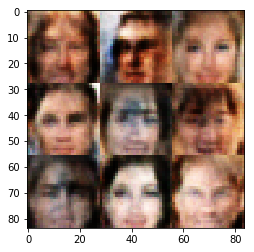

Epoch 1/1... Discriminator Loss: 1.2953... Generator Loss: 1.4739


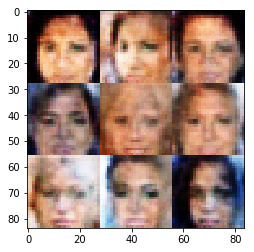

Epoch 1/1... Discriminator Loss: 1.4295... Generator Loss: 0.4218


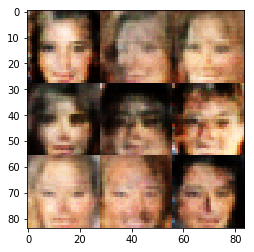

Epoch 1/1... Discriminator Loss: 1.1743... Generator Loss: 0.6654


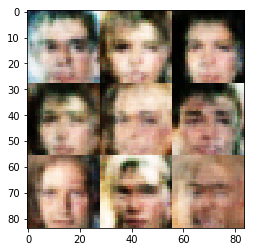

Epoch 1/1... Discriminator Loss: 1.1766... Generator Loss: 0.6791


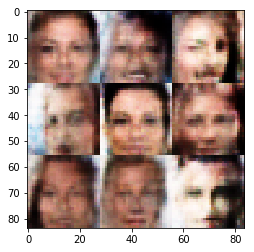

Epoch 1/1... Discriminator Loss: 1.3259... Generator Loss: 1.0609


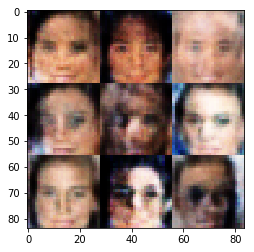

Epoch 1/1... Discriminator Loss: 1.0839... Generator Loss: 1.2268


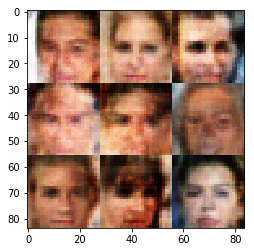

Epoch 1/1... Discriminator Loss: 1.1167... Generator Loss: 0.7343


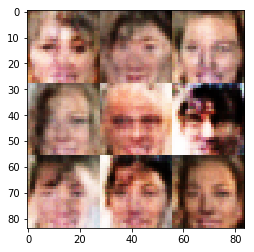

Epoch 1/1... Discriminator Loss: 1.3013... Generator Loss: 0.6249


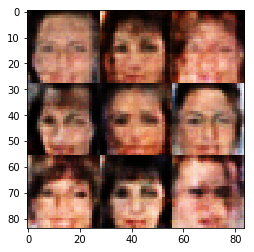

Epoch 1/1... Discriminator Loss: 1.1572... Generator Loss: 0.6409


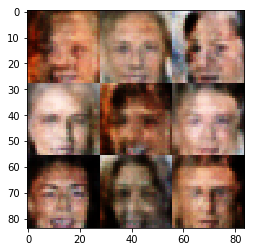

Epoch 1/1... Discriminator Loss: 0.9104... Generator Loss: 1.4023


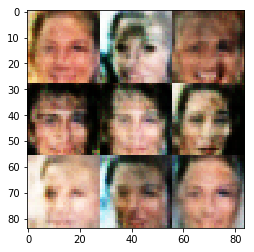

Epoch 1/1... Discriminator Loss: 1.0522... Generator Loss: 0.7112


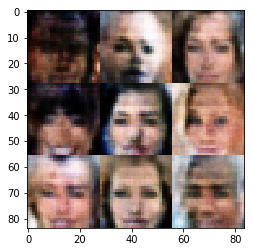

Epoch 1/1... Discriminator Loss: 1.2912... Generator Loss: 0.5518


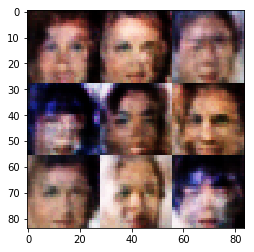

Epoch 1/1... Discriminator Loss: 1.3670... Generator Loss: 0.4234


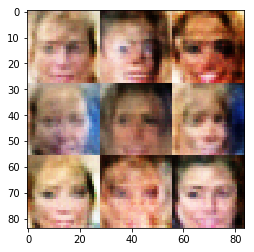

Epoch 1/1... Discriminator Loss: 1.0216... Generator Loss: 1.2467


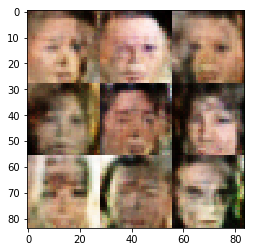

Epoch 1/1... Discriminator Loss: 1.0752... Generator Loss: 0.8585


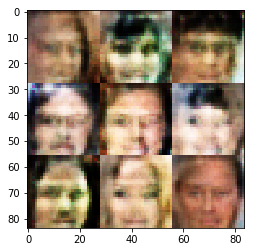

Epoch 1/1... Discriminator Loss: 1.3233... Generator Loss: 0.5468


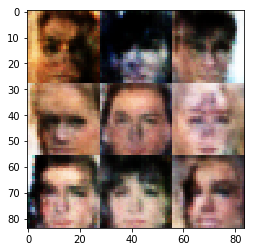

Epoch 1/1... Discriminator Loss: 1.1125... Generator Loss: 0.7854


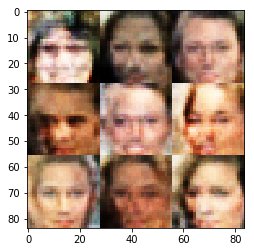

Epoch 1/1... Discriminator Loss: 1.1905... Generator Loss: 0.6477


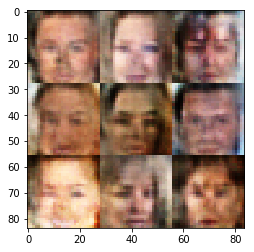

Epoch 1/1... Discriminator Loss: 1.0121... Generator Loss: 0.7447


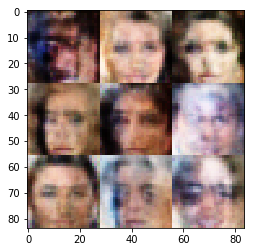

Epoch 1/1... Discriminator Loss: 1.3755... Generator Loss: 0.5844


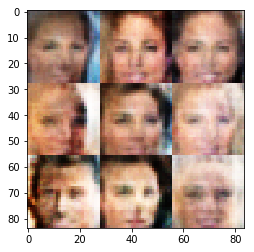

Epoch 1/1... Discriminator Loss: 1.2007... Generator Loss: 0.5151


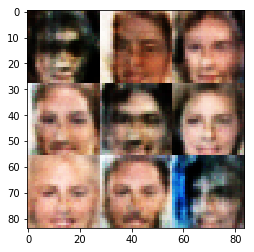

Epoch 1/1... Discriminator Loss: 1.4706... Generator Loss: 0.5034


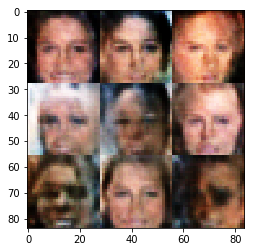

Epoch 1/1... Discriminator Loss: 1.1395... Generator Loss: 0.8106


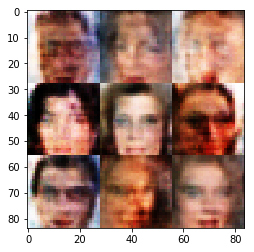

Epoch 1/1... Discriminator Loss: 1.5718... Generator Loss: 0.3066


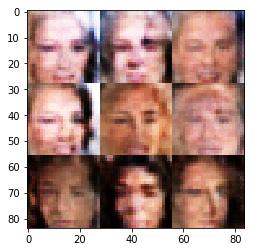

Epoch 1/1... Discriminator Loss: 1.1068... Generator Loss: 0.8997


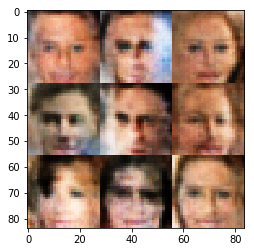

Epoch 1/1... Discriminator Loss: 1.5459... Generator Loss: 1.7051


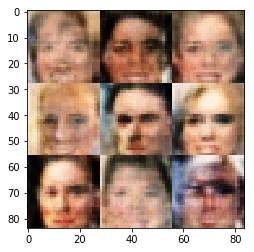

Epoch 1/1... Discriminator Loss: 1.1267... Generator Loss: 0.9899


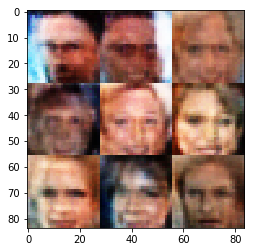

Epoch 1/1... Discriminator Loss: 1.0075... Generator Loss: 0.9217


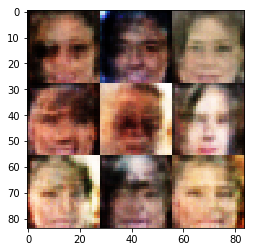

Epoch 1/1... Discriminator Loss: 1.6037... Generator Loss: 0.2871


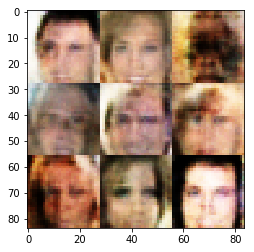

Epoch 1/1... Discriminator Loss: 1.2222... Generator Loss: 0.5248


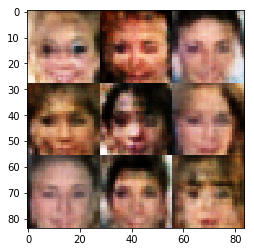

Epoch 1/1... Discriminator Loss: 1.0729... Generator Loss: 0.9166


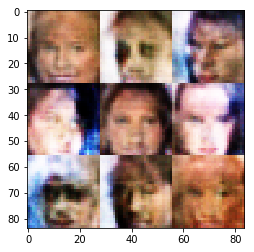

Epoch 1/1... Discriminator Loss: 1.2865... Generator Loss: 0.4605


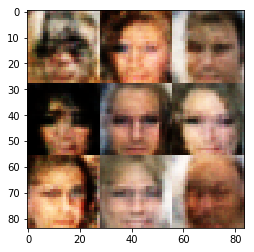

Epoch 1/1... Discriminator Loss: 1.1954... Generator Loss: 0.5608


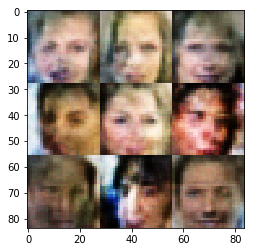

Epoch 1/1... Discriminator Loss: 1.1479... Generator Loss: 1.3229


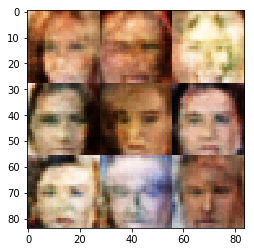

Epoch 1/1... Discriminator Loss: 0.9565... Generator Loss: 0.9538


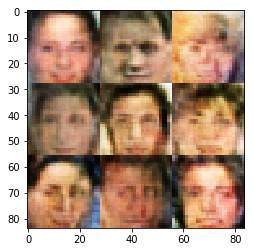

Epoch 1/1... Discriminator Loss: 1.1582... Generator Loss: 0.6012


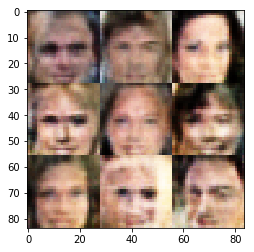

Epoch 1/1... Discriminator Loss: 1.3642... Generator Loss: 0.4627


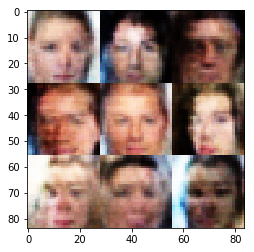

Epoch 1/1... Discriminator Loss: 1.0098... Generator Loss: 0.8497


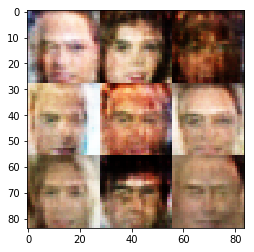

Epoch 1/1... Discriminator Loss: 1.5835... Generator Loss: 0.3201


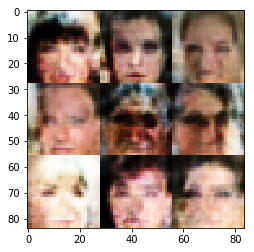

Epoch 1/1... Discriminator Loss: 1.5419... Generator Loss: 0.3253


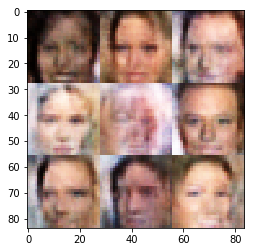

Epoch 1/1... Discriminator Loss: 1.0394... Generator Loss: 0.7798


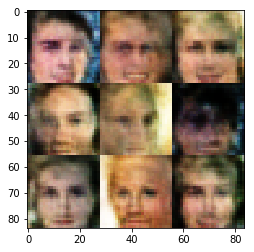

Epoch 1/1... Discriminator Loss: 1.4714... Generator Loss: 0.4069


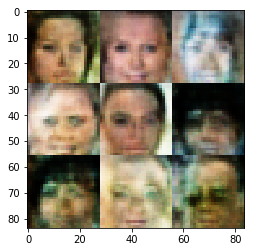

Epoch 1/1... Discriminator Loss: 1.1667... Generator Loss: 0.8177


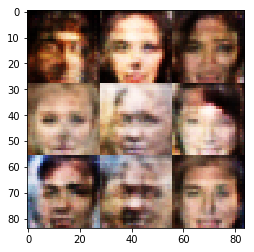

Epoch 1/1... Discriminator Loss: 0.8902... Generator Loss: 1.2035


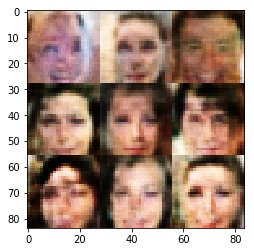

Epoch 1/1... Discriminator Loss: 1.1631... Generator Loss: 0.5707


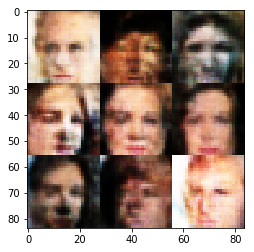

Epoch 1/1... Discriminator Loss: 1.1995... Generator Loss: 0.6665


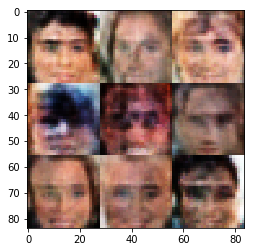

Epoch 1/1... Discriminator Loss: 1.2987... Generator Loss: 0.9463


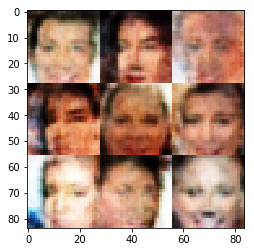

Epoch 1/1... Discriminator Loss: 1.2345... Generator Loss: 0.5914


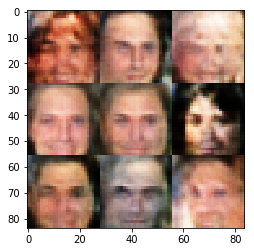

Epoch 1/1... Discriminator Loss: 1.0514... Generator Loss: 1.1183


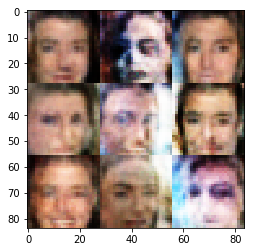

Epoch 1/1... Discriminator Loss: 1.3520... Generator Loss: 1.3451


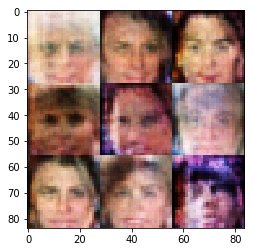

Epoch 1/1... Discriminator Loss: 1.0970... Generator Loss: 1.0356


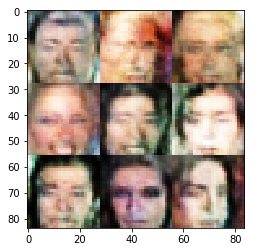

Epoch 1/1... Discriminator Loss: 1.2977... Generator Loss: 0.5097


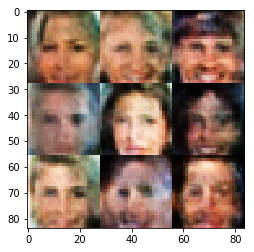

Epoch 1/1... Discriminator Loss: 0.9510... Generator Loss: 1.3605


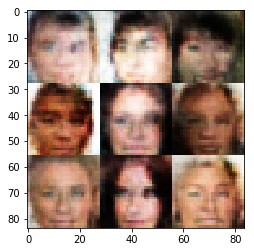

Epoch 1/1... Discriminator Loss: 1.3258... Generator Loss: 0.5014


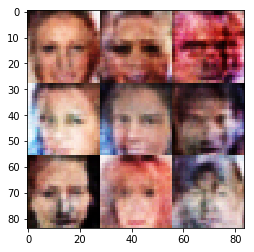

Epoch 1/1... Discriminator Loss: 1.3292... Generator Loss: 0.4366


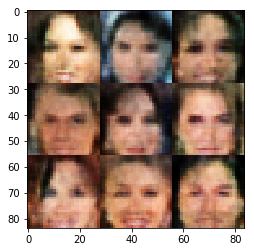

Epoch 1/1... Discriminator Loss: 1.3920... Generator Loss: 0.4831


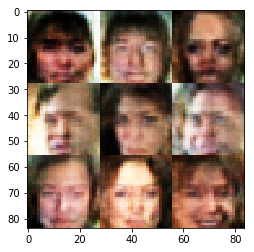

Epoch 1/1... Discriminator Loss: 1.2386... Generator Loss: 0.7408


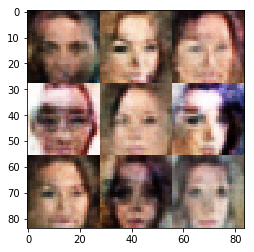

Epoch 1/1... Discriminator Loss: 1.0473... Generator Loss: 0.6444


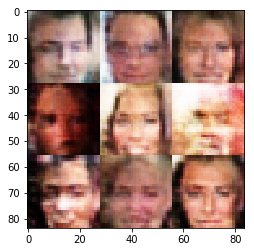

Epoch 1/1... Discriminator Loss: 1.1435... Generator Loss: 0.7721


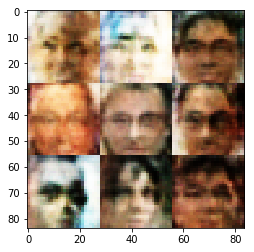

Epoch 1/1... Discriminator Loss: 1.0085... Generator Loss: 1.1158


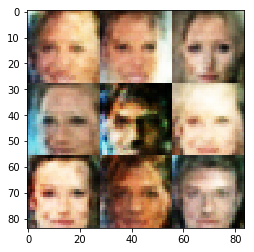

Epoch 1/1... Discriminator Loss: 0.7576... Generator Loss: 1.1664


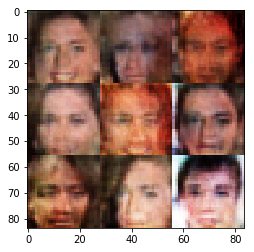

Epoch 1/1... Discriminator Loss: 1.2047... Generator Loss: 0.5591


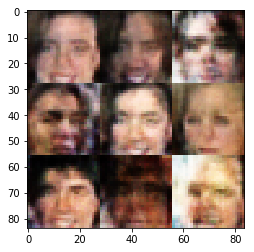

Epoch 1/1... Discriminator Loss: 1.0285... Generator Loss: 1.0109


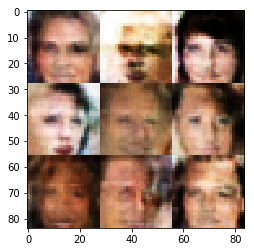

Epoch 1/1... Discriminator Loss: 0.9340... Generator Loss: 0.7338


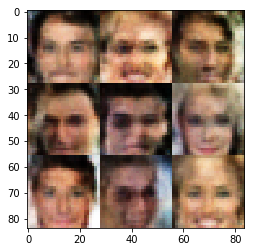

Epoch 1/1... Discriminator Loss: 1.4328... Generator Loss: 0.3429


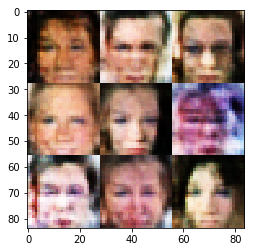

Epoch 1/1... Discriminator Loss: 1.1157... Generator Loss: 0.8637


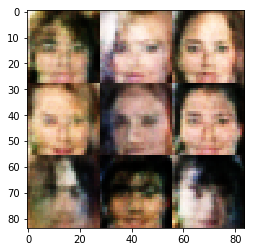

Epoch 1/1... Discriminator Loss: 1.2581... Generator Loss: 0.6199


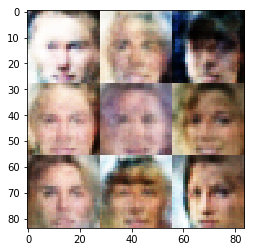

Epoch 1/1... Discriminator Loss: 0.8658... Generator Loss: 1.1003


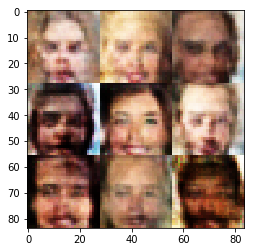

Epoch 1/1... Discriminator Loss: 1.2794... Generator Loss: 0.5210


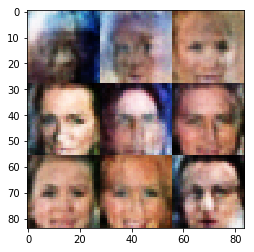

Epoch 1/1... Discriminator Loss: 0.9886... Generator Loss: 0.7804


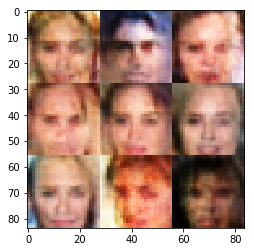

Epoch 1/1... Discriminator Loss: 1.1217... Generator Loss: 0.7068


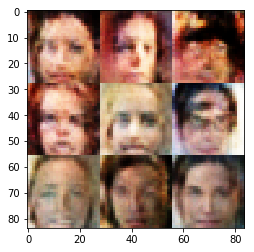

Epoch 1/1... Discriminator Loss: 1.4775... Generator Loss: 0.3519


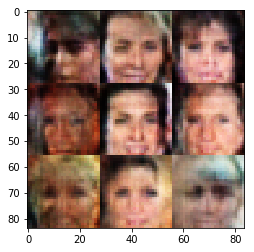

Epoch 1/1... Discriminator Loss: 1.2718... Generator Loss: 0.5020


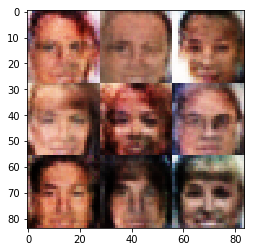

Epoch 1/1... Discriminator Loss: 1.1361... Generator Loss: 0.7231


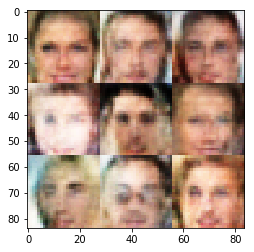

Epoch 1/1... Discriminator Loss: 1.1177... Generator Loss: 0.6675


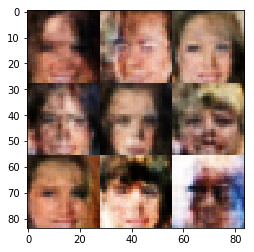

Epoch 1/1... Discriminator Loss: 1.0676... Generator Loss: 0.7999


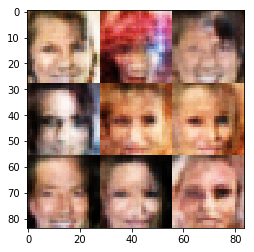

Epoch 1/1... Discriminator Loss: 0.9546... Generator Loss: 0.7751


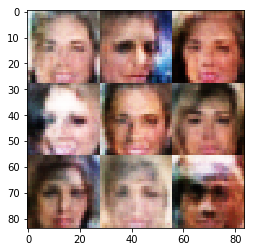

Epoch 1/1... Discriminator Loss: 1.1295... Generator Loss: 0.6046


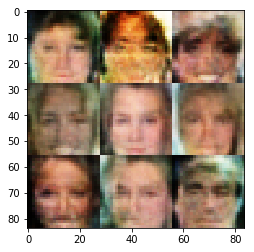

Epoch 1/1... Discriminator Loss: 1.0576... Generator Loss: 0.8237


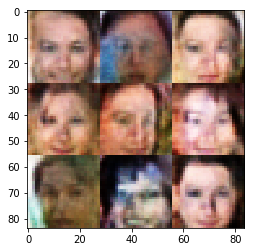

Epoch 1/1... Discriminator Loss: 0.9912... Generator Loss: 0.8380


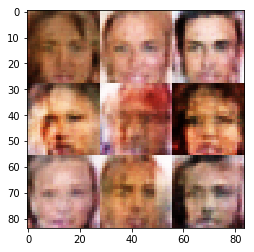

Epoch 1/1... Discriminator Loss: 1.2644... Generator Loss: 0.6027


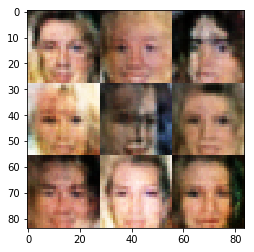

Epoch 1/1... Discriminator Loss: 1.0469... Generator Loss: 0.8699


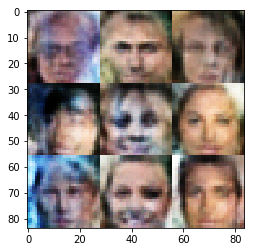

Epoch 1/1... Discriminator Loss: 1.2755... Generator Loss: 0.5484


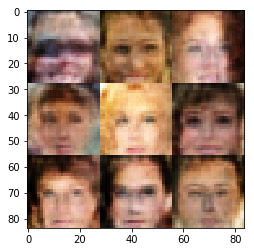

Epoch 1/1... Discriminator Loss: 1.0719... Generator Loss: 0.7732


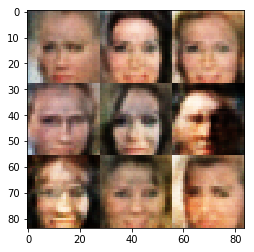

Epoch 1/1... Discriminator Loss: 1.0607... Generator Loss: 0.8358


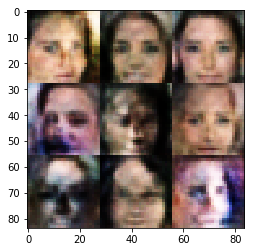

Epoch 1/1... Discriminator Loss: 1.2377... Generator Loss: 1.3692


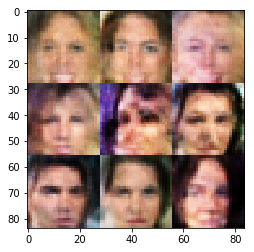

Epoch 1/1... Discriminator Loss: 1.2350... Generator Loss: 0.6033


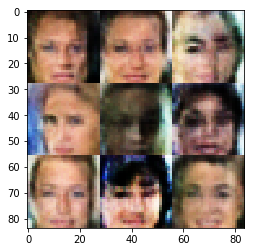

Epoch 1/1... Discriminator Loss: 1.3807... Generator Loss: 0.6994


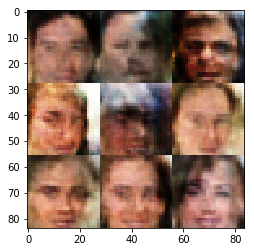

Epoch 1/1... Discriminator Loss: 1.0764... Generator Loss: 0.7599


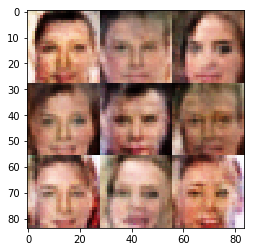

Epoch 1/1... Discriminator Loss: 1.1778... Generator Loss: 0.6036


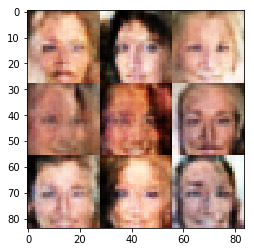

Epoch 1/1... Discriminator Loss: 1.0308... Generator Loss: 0.8383


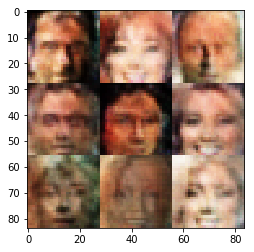

Epoch 1/1... Discriminator Loss: 1.0515... Generator Loss: 0.9835


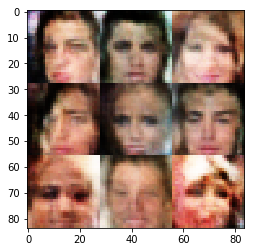

Epoch 1/1... Discriminator Loss: 1.0501... Generator Loss: 0.6934


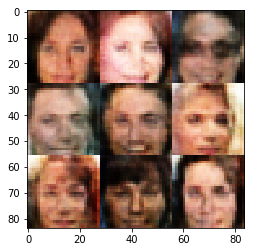

Epoch 1/1... Discriminator Loss: 1.3507... Generator Loss: 0.4975


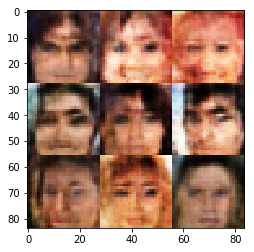

Epoch 1/1... Discriminator Loss: 1.1225... Generator Loss: 0.5639


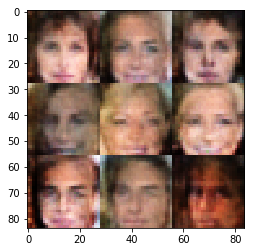

Epoch 1/1... Discriminator Loss: 1.0381... Generator Loss: 0.9757


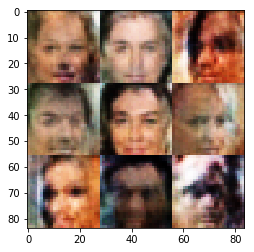

Epoch 1/1... Discriminator Loss: 1.1238... Generator Loss: 0.7968


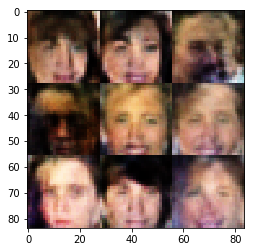

Epoch 1/1... Discriminator Loss: 1.6734... Generator Loss: 0.3130


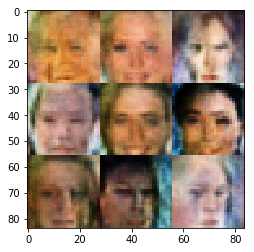

Epoch 1/1... Discriminator Loss: 0.9259... Generator Loss: 0.9222


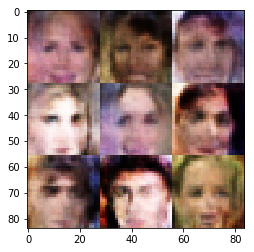

Epoch 1/1... Discriminator Loss: 1.1525... Generator Loss: 1.3930


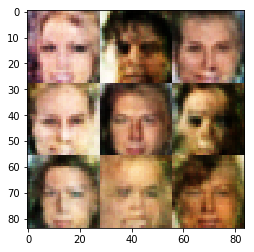

Epoch 1/1... Discriminator Loss: 1.0974... Generator Loss: 0.6003


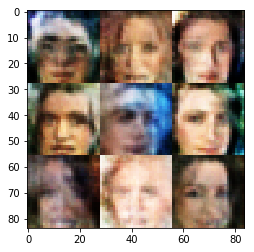

Epoch 1/1... Discriminator Loss: 1.8533... Generator Loss: 0.2228


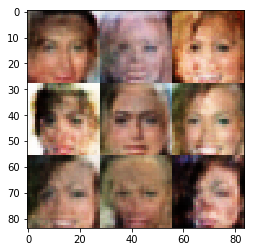

Epoch 1/1... Discriminator Loss: 1.1968... Generator Loss: 0.8680


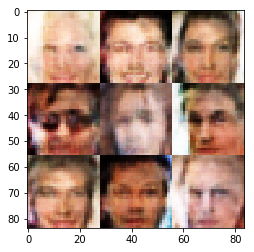

Epoch 1/1... Discriminator Loss: 1.4790... Generator Loss: 0.4283


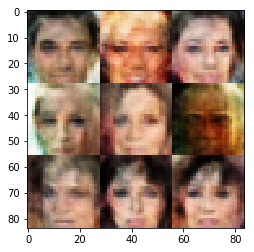

Epoch 1/1... Discriminator Loss: 1.0579... Generator Loss: 1.0659


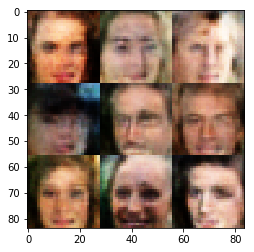

Epoch 1/1... Discriminator Loss: 1.2381... Generator Loss: 0.5230


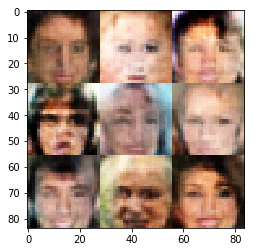

Epoch 1/1... Discriminator Loss: 1.3500... Generator Loss: 0.4275


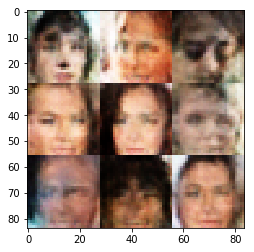

Epoch 1/1... Discriminator Loss: 1.1779... Generator Loss: 0.6031


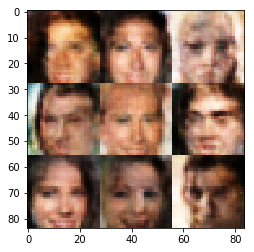

Epoch 1/1... Discriminator Loss: 1.0520... Generator Loss: 0.7060


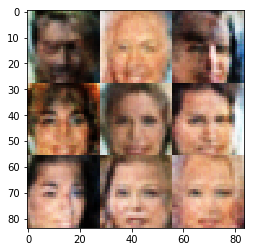

Epoch 1/1... Discriminator Loss: 1.1285... Generator Loss: 0.8342


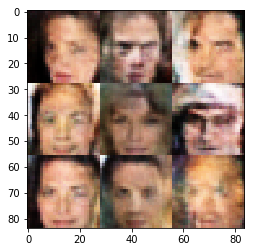

Epoch 1/1... Discriminator Loss: 1.2842... Generator Loss: 0.4834


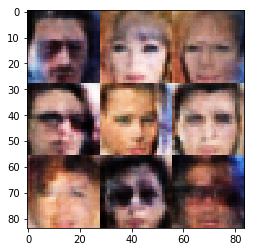

Epoch 1/1... Discriminator Loss: 1.0261... Generator Loss: 0.7335


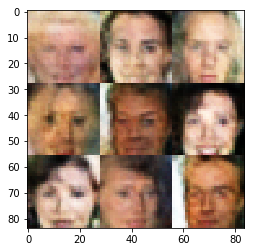

Epoch 1/1... Discriminator Loss: 1.3109... Generator Loss: 0.5941


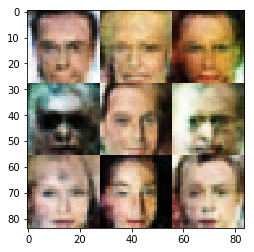

Epoch 1/1... Discriminator Loss: 1.4083... Generator Loss: 0.3624


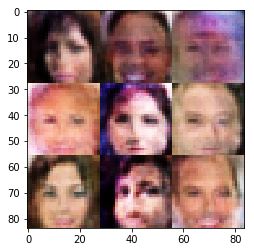

Epoch 1/1... Discriminator Loss: 1.2595... Generator Loss: 0.4854


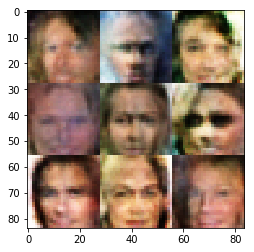

Epoch 1/1... Discriminator Loss: 0.9773... Generator Loss: 0.7519


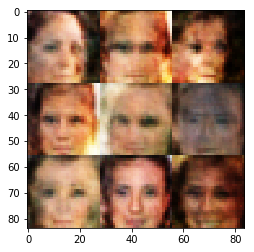

Epoch 1/1... Discriminator Loss: 1.0903... Generator Loss: 0.5714


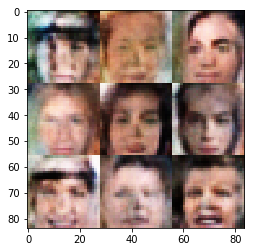

Epoch 1/1... Discriminator Loss: 0.9168... Generator Loss: 0.9710


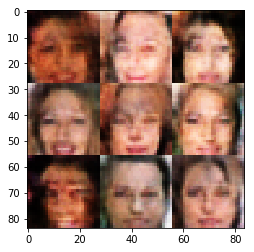

Epoch 1/1... Discriminator Loss: 1.2427... Generator Loss: 0.5547


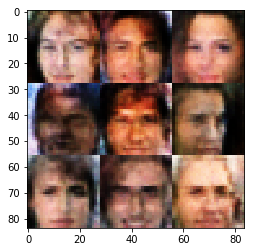

Epoch 1/1... Discriminator Loss: 1.2360... Generator Loss: 0.4852


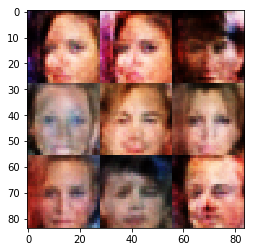

Epoch 1/1... Discriminator Loss: 1.1617... Generator Loss: 0.8412


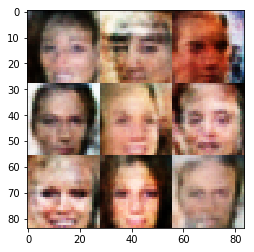

Epoch 1/1... Discriminator Loss: 1.3325... Generator Loss: 0.6562


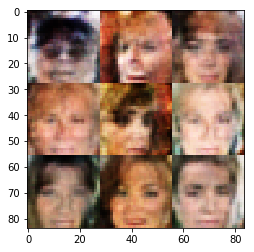

Epoch 1/1... Discriminator Loss: 1.1608... Generator Loss: 0.6474


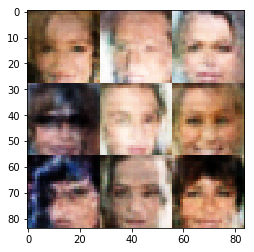

Epoch 1/1... Discriminator Loss: 1.5349... Generator Loss: 0.3812


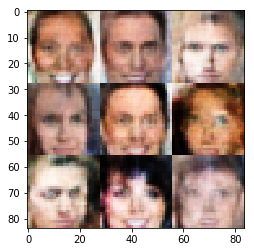

Epoch 1/1... Discriminator Loss: 1.0203... Generator Loss: 0.9239


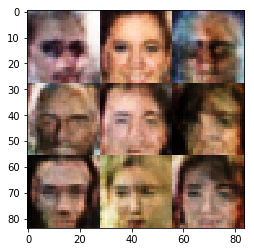

Epoch 1/1... Discriminator Loss: 1.0936... Generator Loss: 1.3968


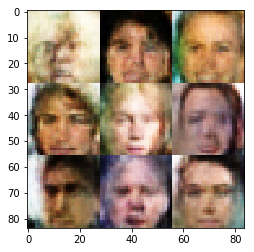

Epoch 1/1... Discriminator Loss: 1.1983... Generator Loss: 0.5379


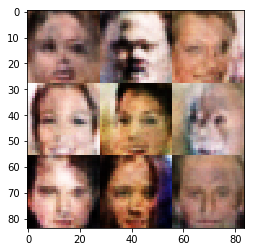

Epoch 1/1... Discriminator Loss: 1.0173... Generator Loss: 0.7499


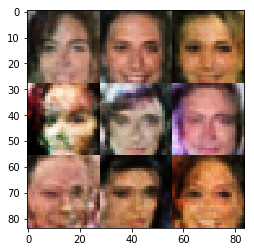

Epoch 1/1... Discriminator Loss: 1.0988... Generator Loss: 0.6151


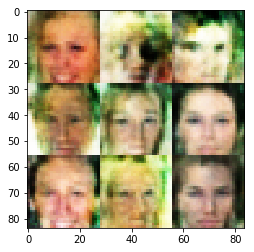

Epoch 1/1... Discriminator Loss: 1.0350... Generator Loss: 0.9013


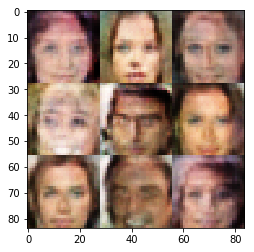

Epoch 1/1... Discriminator Loss: 1.2607... Generator Loss: 0.5404


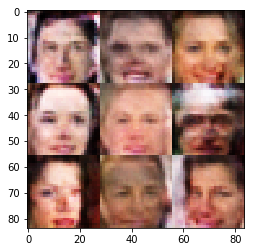

Epoch 1/1... Discriminator Loss: 1.2713... Generator Loss: 0.4769


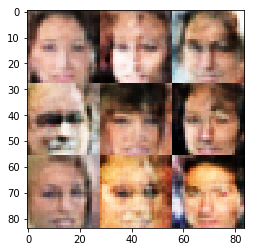

Epoch 1/1... Discriminator Loss: 1.0997... Generator Loss: 0.8528


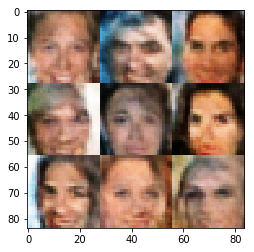

Epoch 1/1... Discriminator Loss: 1.2567... Generator Loss: 0.4554


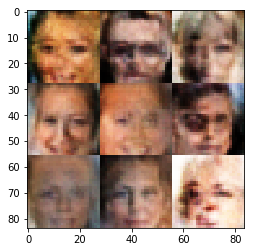

Epoch 1/1... Discriminator Loss: 1.2607... Generator Loss: 0.4984


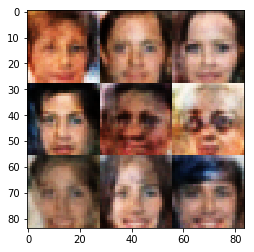

Epoch 1/1... Discriminator Loss: 1.0506... Generator Loss: 0.8031


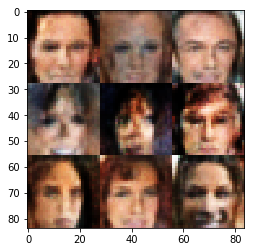

Epoch 1/1... Discriminator Loss: 1.4329... Generator Loss: 0.4070


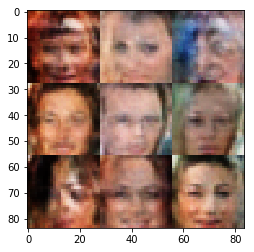

Epoch 1/1... Discriminator Loss: 1.1684... Generator Loss: 0.9479


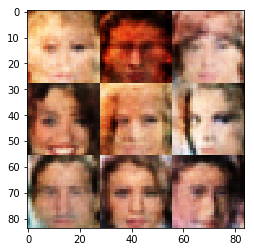

Epoch 1/1... Discriminator Loss: 1.1989... Generator Loss: 0.4857


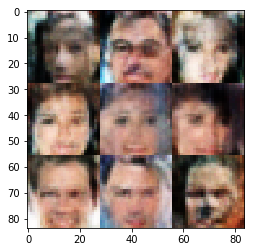

Epoch 1/1... Discriminator Loss: 1.2555... Generator Loss: 0.9576


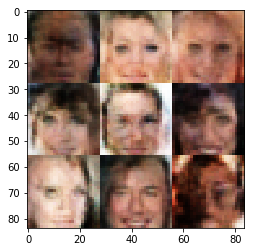

Epoch 1/1... Discriminator Loss: 1.1217... Generator Loss: 1.2435


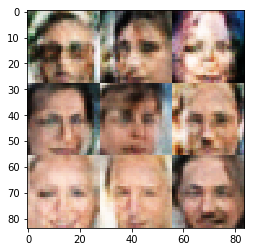

Epoch 1/1... Discriminator Loss: 1.2484... Generator Loss: 0.5508


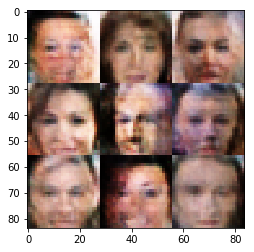

Epoch 1/1... Discriminator Loss: 1.2909... Generator Loss: 0.5325


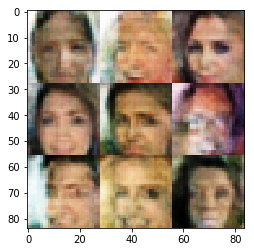

Epoch 1/1... Discriminator Loss: 0.8782... Generator Loss: 1.0035


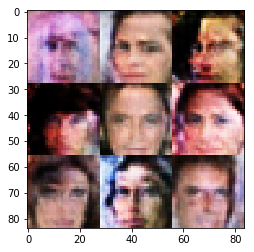

Epoch 1/1... Discriminator Loss: 1.0281... Generator Loss: 0.6917


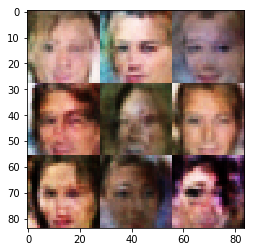

Epoch 1/1... Discriminator Loss: 1.0911... Generator Loss: 0.6853


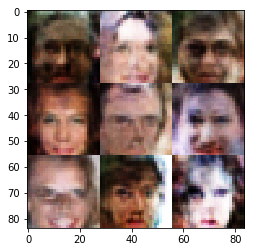

Epoch 1/1... Discriminator Loss: 1.1133... Generator Loss: 1.0366


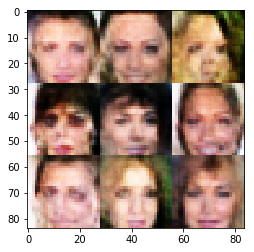

Epoch 1/1... Discriminator Loss: 1.1246... Generator Loss: 1.0750


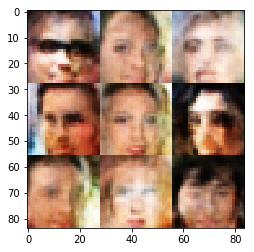

Epoch 1/1... Discriminator Loss: 1.0075... Generator Loss: 0.8181


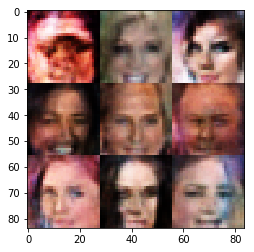

Epoch 1/1... Discriminator Loss: 0.9946... Generator Loss: 1.0855


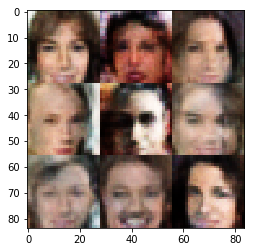

Epoch 1/1... Discriminator Loss: 1.1946... Generator Loss: 0.5719


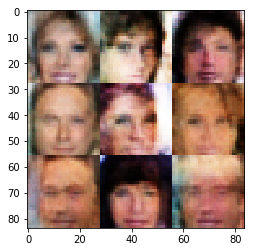

Epoch 1/1... Discriminator Loss: 0.8697... Generator Loss: 0.9523


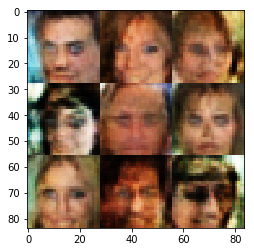

Epoch 1/1... Discriminator Loss: 1.2957... Generator Loss: 0.4208


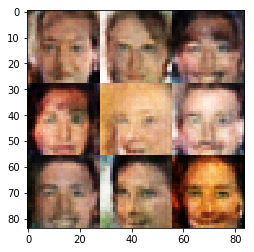

Epoch 1/1... Discriminator Loss: 1.0732... Generator Loss: 0.7513


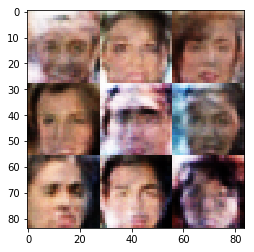

Epoch 1/1... Discriminator Loss: 1.3472... Generator Loss: 0.4318


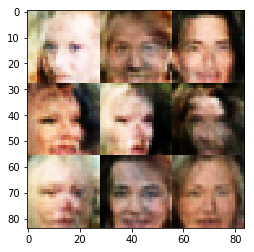

Epoch 1/1... Discriminator Loss: 1.3999... Generator Loss: 0.4417


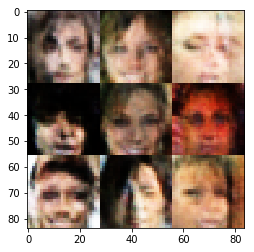

Epoch 1/1... Discriminator Loss: 1.1267... Generator Loss: 0.6026


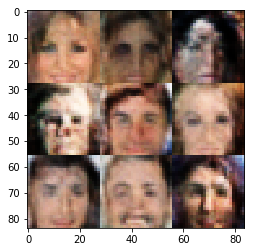

Epoch 1/1... Discriminator Loss: 1.0511... Generator Loss: 0.7913


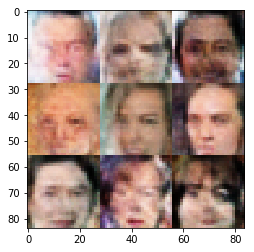

Epoch 1/1... Discriminator Loss: 1.1115... Generator Loss: 0.6367


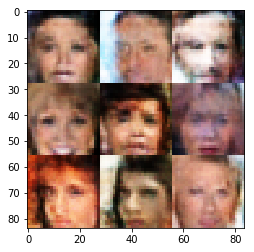

Epoch 1/1... Discriminator Loss: 1.0636... Generator Loss: 0.8883


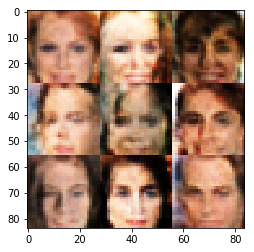

Epoch 1/1... Discriminator Loss: 1.0255... Generator Loss: 1.1865


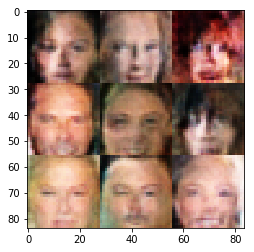

Epoch 1/1... Discriminator Loss: 1.0289... Generator Loss: 0.7769


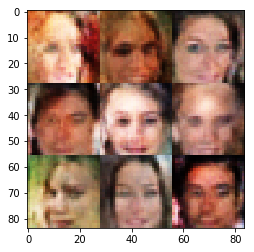

Epoch 1/1... Discriminator Loss: 0.9370... Generator Loss: 0.8451


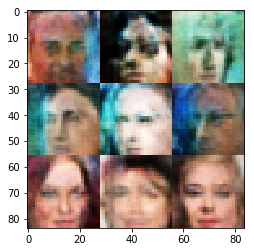

Epoch 1/1... Discriminator Loss: 1.4324... Generator Loss: 0.4343


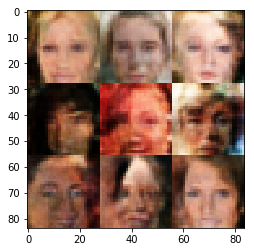

Epoch 1/1... Discriminator Loss: 1.2884... Generator Loss: 0.5199


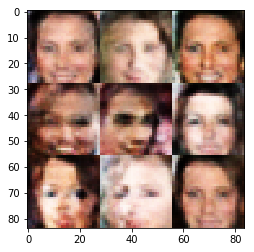

Epoch 1/1... Discriminator Loss: 1.3286... Generator Loss: 0.4289


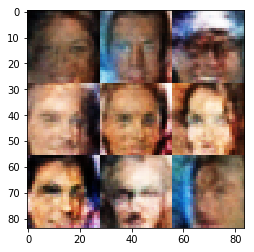

Epoch 1/1... Discriminator Loss: 1.1323... Generator Loss: 0.6875


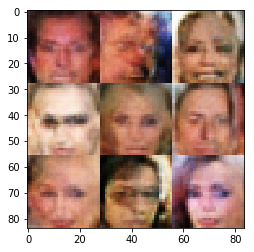

Epoch 1/1... Discriminator Loss: 0.9753... Generator Loss: 0.6969


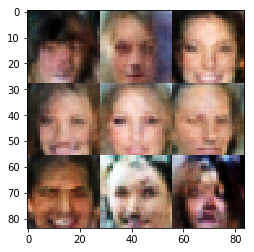

Epoch 1/1... Discriminator Loss: 1.4144... Generator Loss: 0.3711


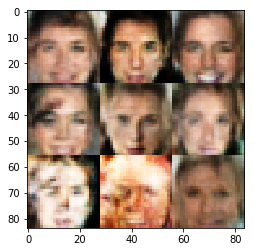

Epoch 1/1... Discriminator Loss: 1.3770... Generator Loss: 0.4561


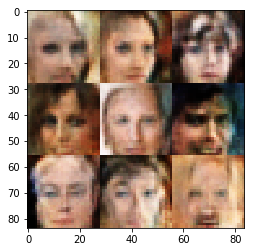

Epoch 1/1... Discriminator Loss: 1.1628... Generator Loss: 1.1547


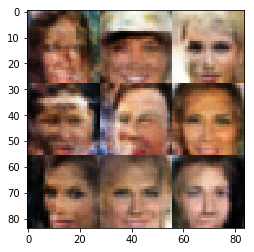

Epoch 1/1... Discriminator Loss: 1.0669... Generator Loss: 1.2528


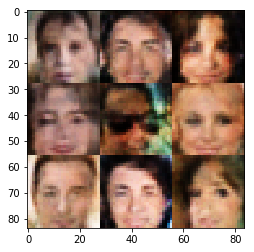

Epoch 1/1... Discriminator Loss: 0.9683... Generator Loss: 1.1397


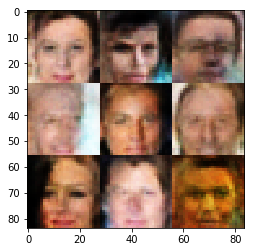

Epoch 1/1... Discriminator Loss: 1.2269... Generator Loss: 0.6760


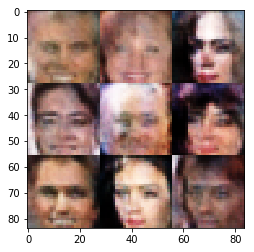

Epoch 1/1... Discriminator Loss: 1.2132... Generator Loss: 0.6485


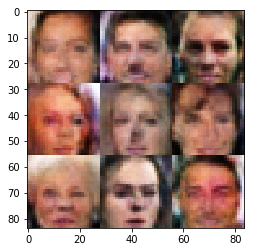

Epoch 1/1... Discriminator Loss: 1.0066... Generator Loss: 0.9275


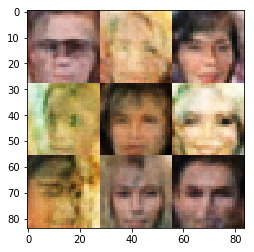

Epoch 1/1... Discriminator Loss: 1.3400... Generator Loss: 0.3889


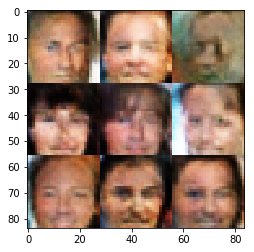

Epoch 1/1... Discriminator Loss: 1.0515... Generator Loss: 0.6855


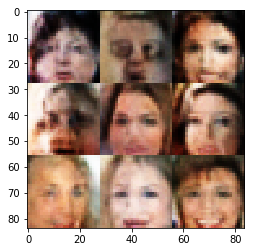

Epoch 1/1... Discriminator Loss: 1.2744... Generator Loss: 0.4807


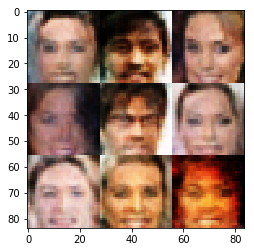

Epoch 1/1... Discriminator Loss: 1.3124... Generator Loss: 0.4358


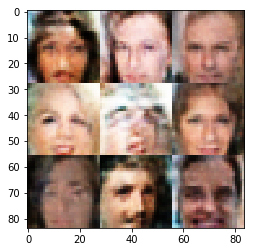

Epoch 1/1... Discriminator Loss: 1.4700... Generator Loss: 0.3331


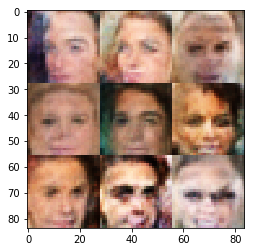

Epoch 1/1... Discriminator Loss: 1.2627... Generator Loss: 0.5141


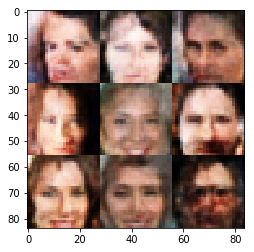

Epoch 1/1... Discriminator Loss: 0.9387... Generator Loss: 1.0793


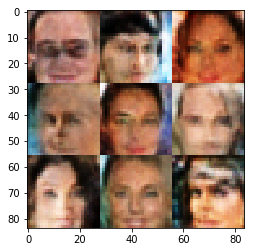

Epoch 1/1... Discriminator Loss: 1.1578... Generator Loss: 0.5681


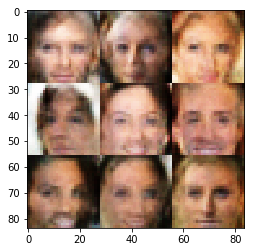

Epoch 1/1... Discriminator Loss: 1.0441... Generator Loss: 0.9011


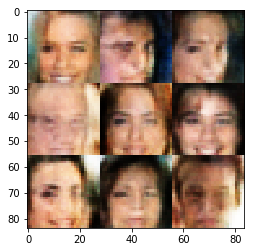

Epoch 1/1... Discriminator Loss: 0.8209... Generator Loss: 0.9142


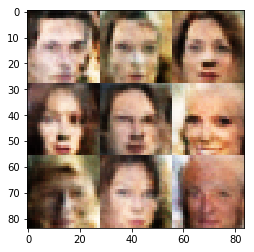

Epoch 1/1... Discriminator Loss: 1.3364... Generator Loss: 0.4217


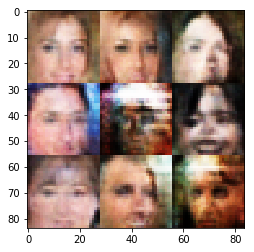

Epoch 1/1... Discriminator Loss: 1.2998... Generator Loss: 0.5383


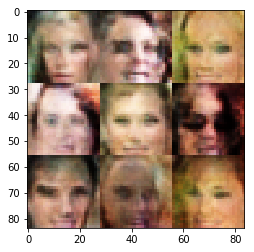

Epoch 1/1... Discriminator Loss: 1.2233... Generator Loss: 0.5180


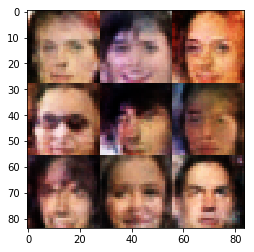

Epoch 1/1... Discriminator Loss: 1.1586... Generator Loss: 0.5295


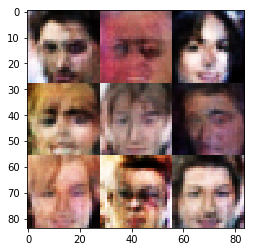

Epoch 1/1... Discriminator Loss: 0.9844... Generator Loss: 0.9903


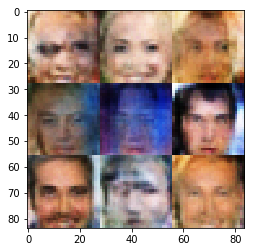

Epoch 1/1... Discriminator Loss: 1.0983... Generator Loss: 0.7800


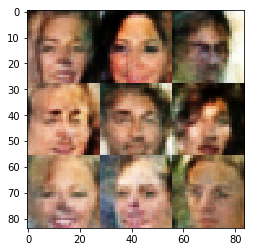

Epoch 1/1... Discriminator Loss: 1.2355... Generator Loss: 0.5232


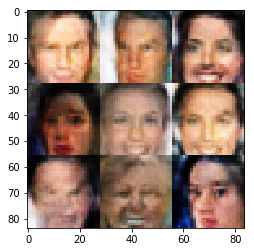

Epoch 1/1... Discriminator Loss: 1.0695... Generator Loss: 0.7454


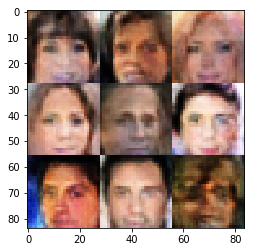

Epoch 1/1... Discriminator Loss: 0.8876... Generator Loss: 1.1627


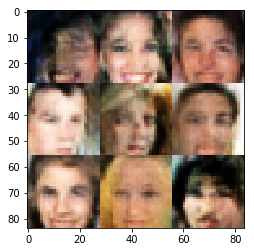

Epoch 1/1... Discriminator Loss: 0.9961... Generator Loss: 0.8261


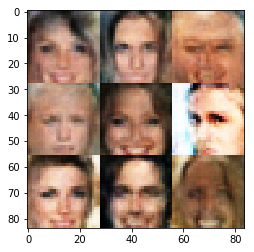

Epoch 1/1... Discriminator Loss: 1.0364... Generator Loss: 0.9386


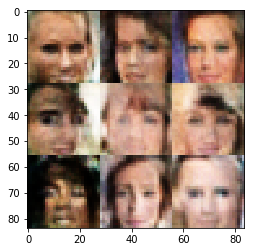

Epoch 1/1... Discriminator Loss: 1.3920... Generator Loss: 0.4037


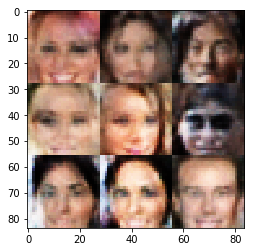

Epoch 1/1... Discriminator Loss: 1.0524... Generator Loss: 1.1360


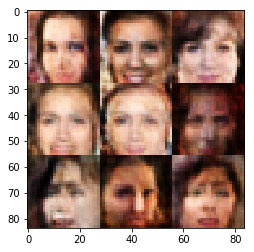

Epoch 1/1... Discriminator Loss: 1.2525... Generator Loss: 0.6179


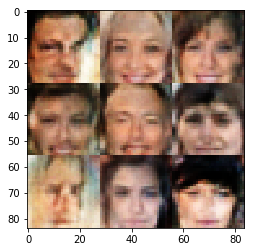

Epoch 1/1... Discriminator Loss: 1.0959... Generator Loss: 0.7621


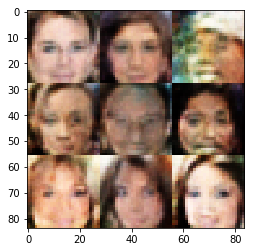

Epoch 1/1... Discriminator Loss: 1.1501... Generator Loss: 0.6495


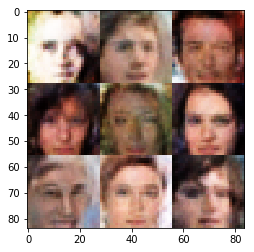

Epoch 1/1... Discriminator Loss: 0.9980... Generator Loss: 0.6944


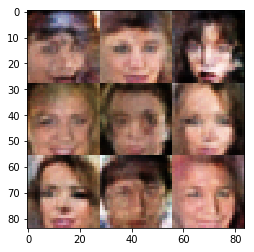

Epoch 1/1... Discriminator Loss: 1.2966... Generator Loss: 0.4919


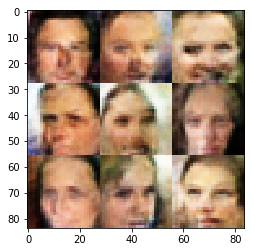

Epoch 1/1... Discriminator Loss: 1.0745... Generator Loss: 0.6404


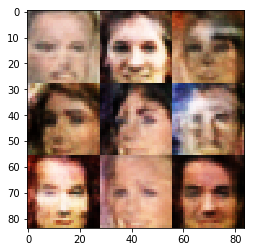

Epoch 1/1... Discriminator Loss: 0.9051... Generator Loss: 0.9045


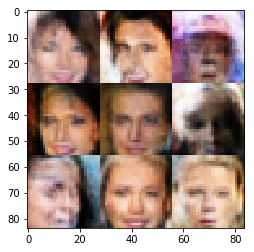

Epoch 1/1... Discriminator Loss: 1.3832... Generator Loss: 0.4782


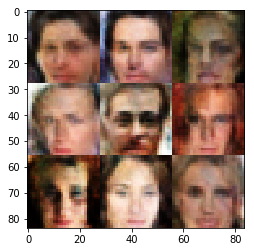

Epoch 1/1... Discriminator Loss: 1.0077... Generator Loss: 0.9129


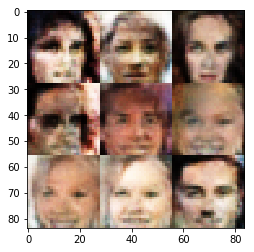

Epoch 1/1... Discriminator Loss: 1.2605... Generator Loss: 0.4370


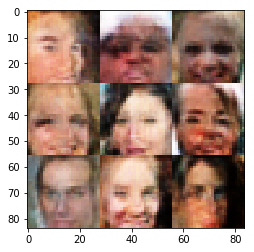

Epoch 1/1... Discriminator Loss: 1.1482... Generator Loss: 0.6384


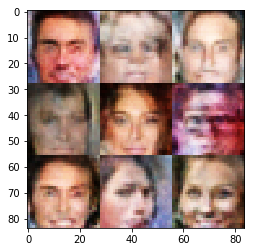

Epoch 1/1... Discriminator Loss: 1.1701... Generator Loss: 0.8458


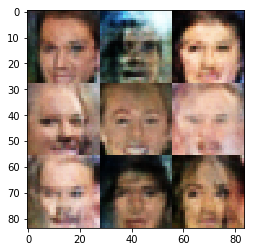

Epoch 1/1... Discriminator Loss: 1.0671... Generator Loss: 0.6169


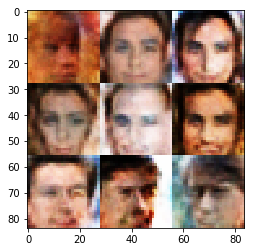

Epoch 1/1... Discriminator Loss: 0.9541... Generator Loss: 0.7816


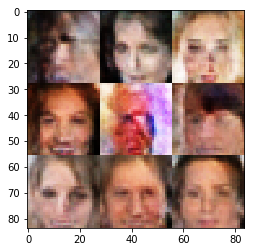

Epoch 1/1... Discriminator Loss: 0.8882... Generator Loss: 0.9492


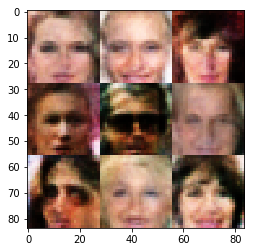

Epoch 1/1... Discriminator Loss: 1.2752... Generator Loss: 0.5412


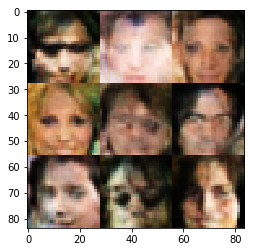

Epoch 1/1... Discriminator Loss: 1.0205... Generator Loss: 0.9461


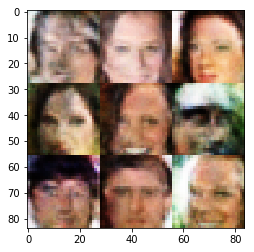

Epoch 1/1... Discriminator Loss: 1.1588... Generator Loss: 0.8004


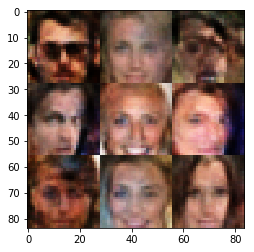

Epoch 1/1... Discriminator Loss: 1.2719... Generator Loss: 0.4962


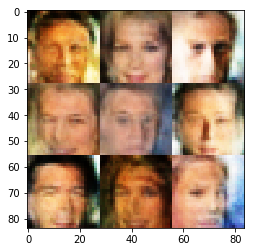

Epoch 1/1... Discriminator Loss: 1.1429... Generator Loss: 0.5253


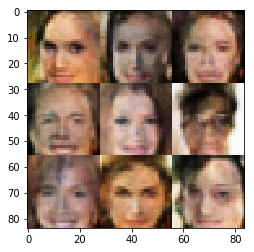

Epoch 1/1... Discriminator Loss: 1.1494... Generator Loss: 0.5289


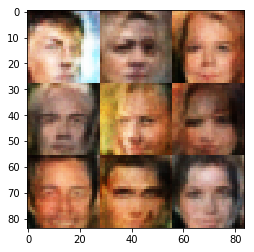

Epoch 1/1... Discriminator Loss: 1.1513... Generator Loss: 0.9845


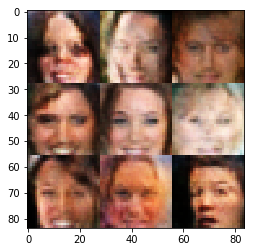

Epoch 1/1... Discriminator Loss: 1.0082... Generator Loss: 0.9307


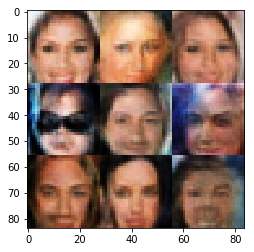

Epoch 1/1... Discriminator Loss: 1.1811... Generator Loss: 0.6623


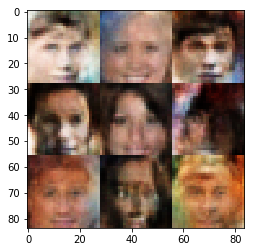

Epoch 1/1... Discriminator Loss: 1.0709... Generator Loss: 0.7037


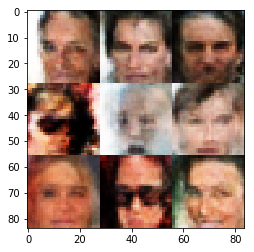

Epoch 1/1... Discriminator Loss: 1.0357... Generator Loss: 0.8556


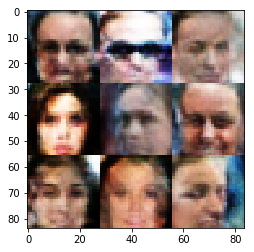

Epoch 1/1... Discriminator Loss: 1.1335... Generator Loss: 0.8388


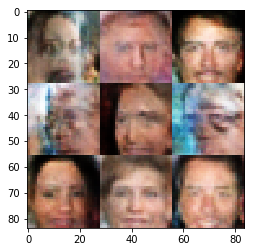

Epoch 1/1... Discriminator Loss: 1.1934... Generator Loss: 0.5562


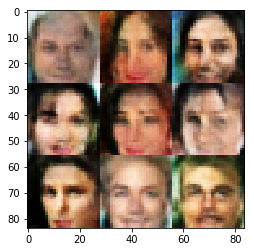

Epoch 1/1... Discriminator Loss: 1.3196... Generator Loss: 1.0179


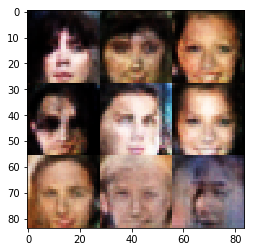

Epoch 1/1... Discriminator Loss: 1.1840... Generator Loss: 0.7974


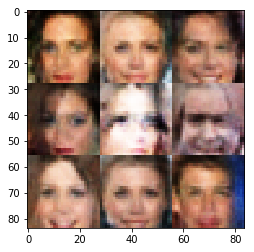

Epoch 1/1... Discriminator Loss: 1.1189... Generator Loss: 0.7413


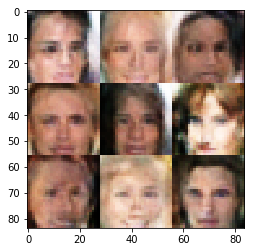

Epoch 1/1... Discriminator Loss: 1.2055... Generator Loss: 0.7811


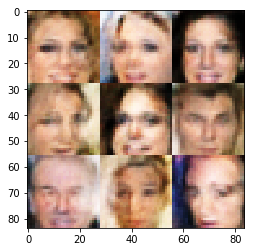

Epoch 1/1... Discriminator Loss: 1.1416... Generator Loss: 0.5542


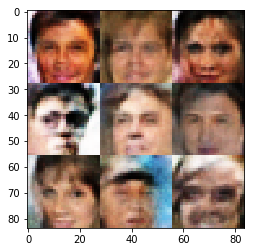

Epoch 1/1... Discriminator Loss: 1.3043... Generator Loss: 0.4734


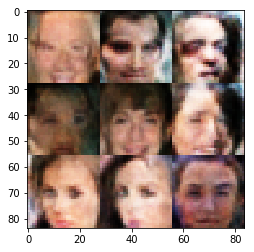

Epoch 1/1... Discriminator Loss: 0.9492... Generator Loss: 0.8185


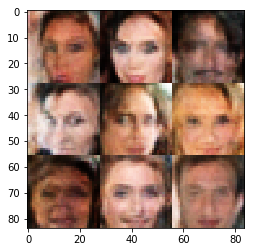

Epoch 1/1... Discriminator Loss: 1.0491... Generator Loss: 0.9015


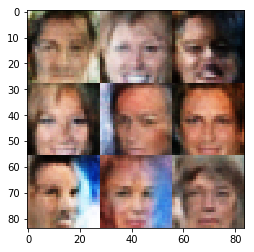

Epoch 1/1... Discriminator Loss: 1.2182... Generator Loss: 0.5891


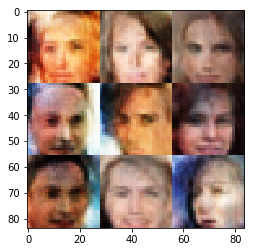

Epoch 1/1... Discriminator Loss: 1.0039... Generator Loss: 0.7530


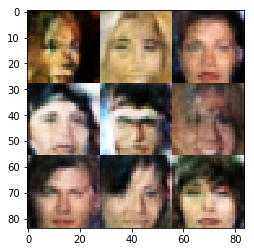

Epoch 1/1... Discriminator Loss: 1.0323... Generator Loss: 1.2021


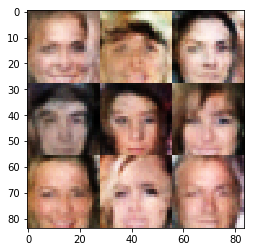

Epoch 1/1... Discriminator Loss: 0.8467... Generator Loss: 1.5054


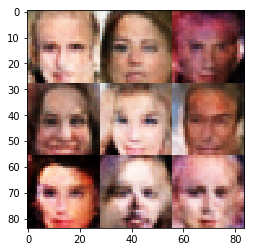

Epoch 1/1... Discriminator Loss: 1.2926... Generator Loss: 0.5175


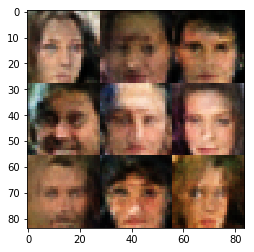

Epoch 1/1... Discriminator Loss: 1.1694... Generator Loss: 0.5171


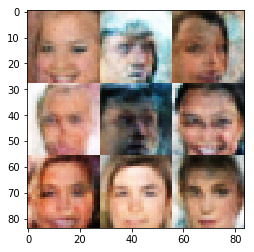

Epoch 1/1... Discriminator Loss: 1.3733... Generator Loss: 0.3840


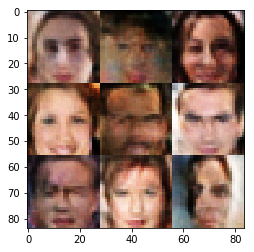

Epoch 1/1... Discriminator Loss: 0.9841... Generator Loss: 1.2035


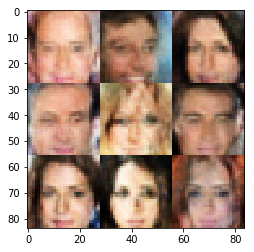

Epoch 1/1... Discriminator Loss: 1.0226... Generator Loss: 0.7484


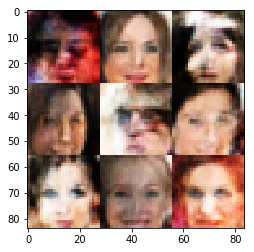

Epoch 1/1... Discriminator Loss: 0.9845... Generator Loss: 0.8909


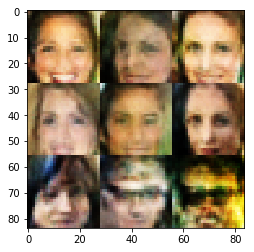

Epoch 1/1... Discriminator Loss: 1.0488... Generator Loss: 0.6935


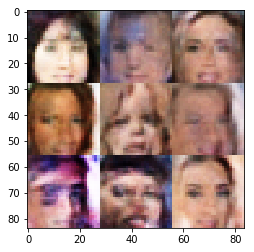

Epoch 1/1... Discriminator Loss: 0.9592... Generator Loss: 0.8353


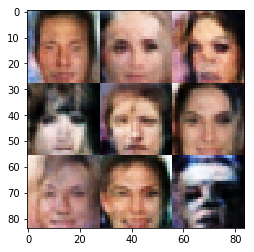

Epoch 1/1... Discriminator Loss: 1.1394... Generator Loss: 0.7004


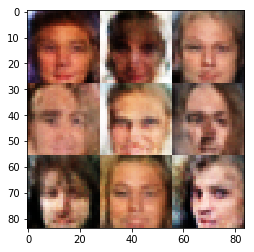

Epoch 1/1... Discriminator Loss: 1.2156... Generator Loss: 0.7346


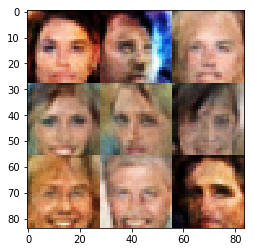

Epoch 1/1... Discriminator Loss: 1.1666... Generator Loss: 0.8900


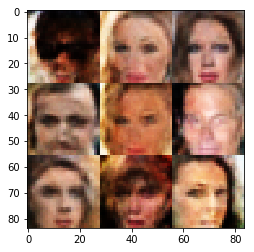

Epoch 1/1... Discriminator Loss: 1.0338... Generator Loss: 0.7989


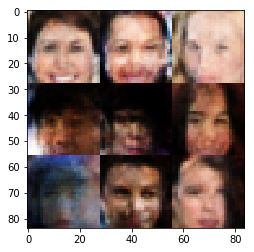

Epoch 1/1... Discriminator Loss: 1.3391... Generator Loss: 0.4725


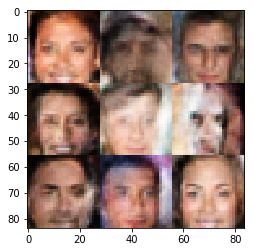

Epoch 1/1... Discriminator Loss: 1.2382... Generator Loss: 0.8450


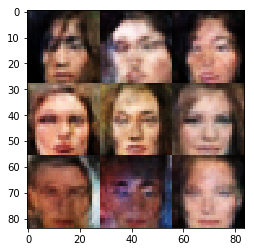

Epoch 1/1... Discriminator Loss: 1.2077... Generator Loss: 0.7201


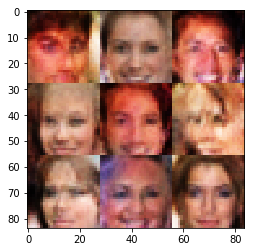

Epoch 1/1... Discriminator Loss: 1.0348... Generator Loss: 0.8579


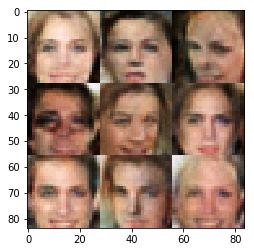

Epoch 1/1... Discriminator Loss: 1.1817... Generator Loss: 0.5303


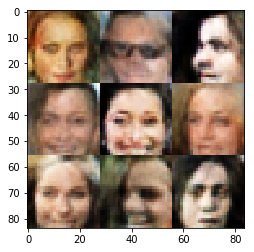

Epoch 1/1... Discriminator Loss: 1.7207... Generator Loss: 0.2677


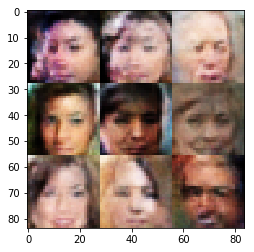

Epoch 1/1... Discriminator Loss: 1.0037... Generator Loss: 0.7552


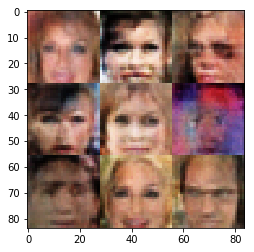

Epoch 1/1... Discriminator Loss: 1.2336... Generator Loss: 0.4867


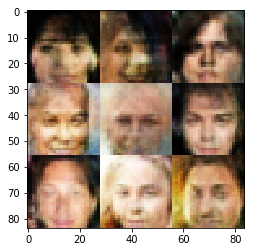

Epoch 1/1... Discriminator Loss: 1.0630... Generator Loss: 0.7545


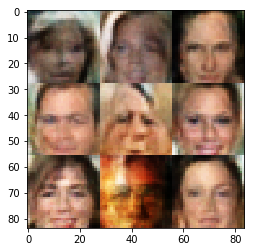

Epoch 1/1... Discriminator Loss: 0.9692... Generator Loss: 0.8053


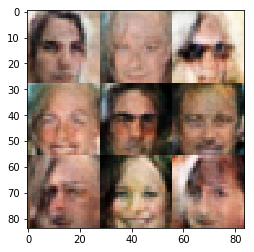

Epoch 1/1... Discriminator Loss: 1.2037... Generator Loss: 1.0246


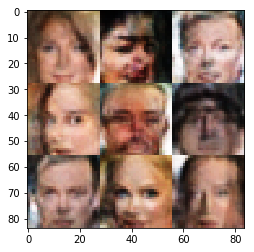

Epoch 1/1... Discriminator Loss: 1.0072... Generator Loss: 1.1842


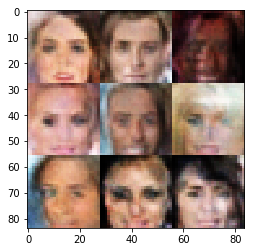

Epoch 1/1... Discriminator Loss: 1.1166... Generator Loss: 0.6105


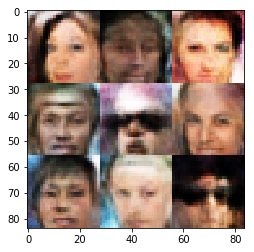

Epoch 1/1... Discriminator Loss: 1.1041... Generator Loss: 0.7564


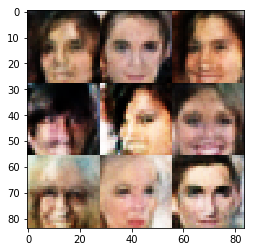

Epoch 1/1... Discriminator Loss: 1.1648... Generator Loss: 0.5471


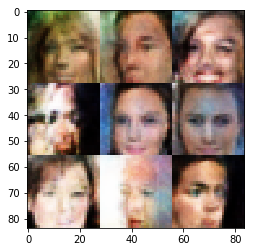

Epoch 1/1... Discriminator Loss: 0.9868... Generator Loss: 0.7832


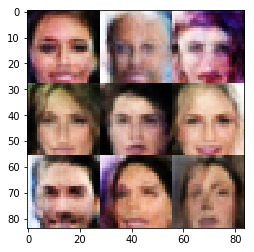

Epoch 1/1... Discriminator Loss: 1.5237... Generator Loss: 0.3177


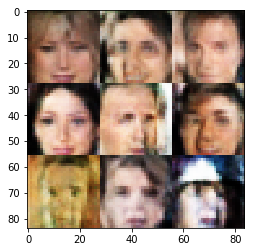

Epoch 1/1... Discriminator Loss: 1.3326... Generator Loss: 0.5122


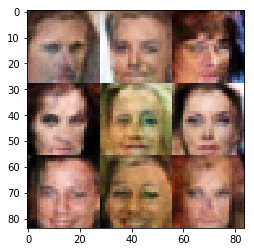

Epoch 1/1... Discriminator Loss: 1.0618... Generator Loss: 0.9326


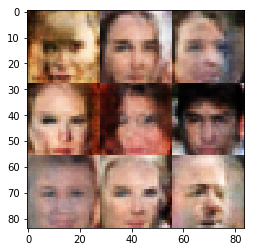

Epoch 1/1... Discriminator Loss: 1.0003... Generator Loss: 1.3929


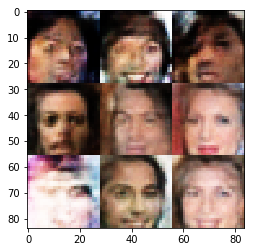

Epoch 1/1... Discriminator Loss: 1.1640... Generator Loss: 0.7870


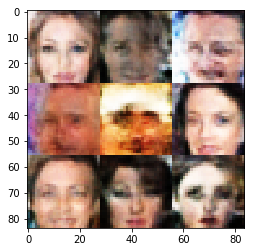

Epoch 1/1... Discriminator Loss: 1.2280... Generator Loss: 0.5092


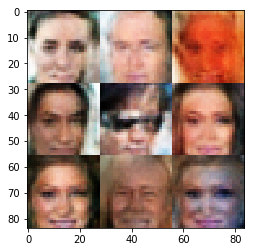

Epoch 1/1... Discriminator Loss: 1.0679... Generator Loss: 0.7250


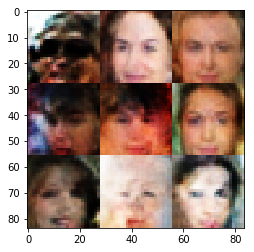

Epoch 1/1... Discriminator Loss: 1.1737... Generator Loss: 0.6148


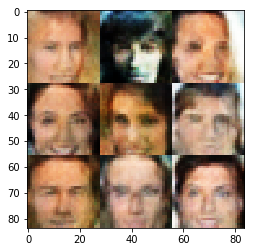

Epoch 1/1... Discriminator Loss: 1.0074... Generator Loss: 0.7669


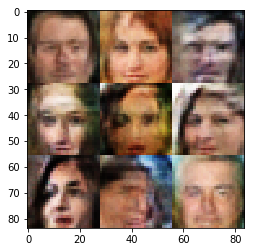

Epoch 1/1... Discriminator Loss: 1.2870... Generator Loss: 0.4923


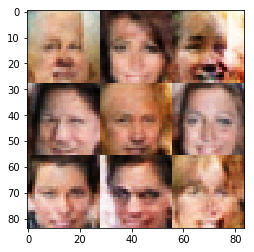

Epoch 1/1... Discriminator Loss: 0.9880... Generator Loss: 0.8444


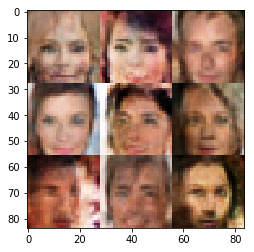

Epoch 1/1... Discriminator Loss: 1.1465... Generator Loss: 0.9597


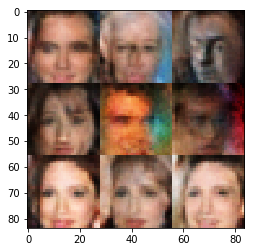

Epoch 1/1... Discriminator Loss: 1.3650... Generator Loss: 0.5482


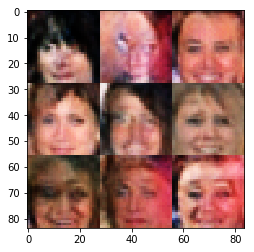

Epoch 1/1... Discriminator Loss: 1.3414... Generator Loss: 0.3846


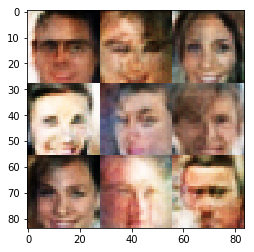

Epoch 1/1... Discriminator Loss: 1.2605... Generator Loss: 0.5073


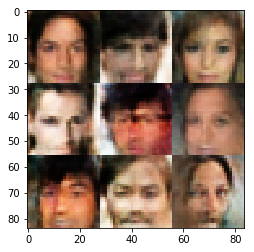

Epoch 1/1... Discriminator Loss: 1.2463... Generator Loss: 0.4952


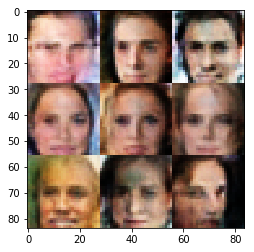

Epoch 1/1... Discriminator Loss: 1.2955... Generator Loss: 0.4342


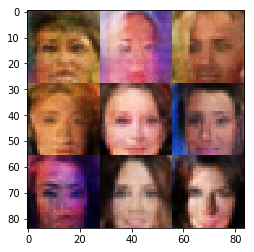

Epoch 1/1... Discriminator Loss: 1.1847... Generator Loss: 0.7853


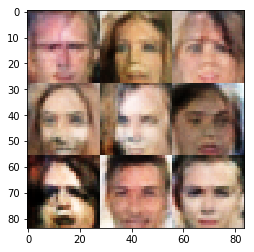

Epoch 1/1... Discriminator Loss: 1.1135... Generator Loss: 0.8922


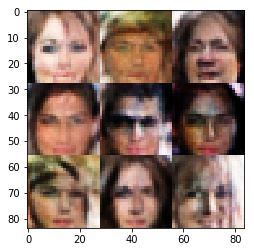

Epoch 1/1... Discriminator Loss: 1.3224... Generator Loss: 0.6852


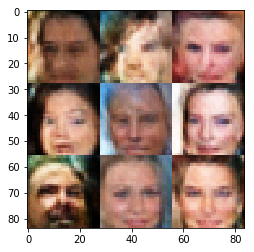

Epoch 1/1... Discriminator Loss: 1.0280... Generator Loss: 0.7779


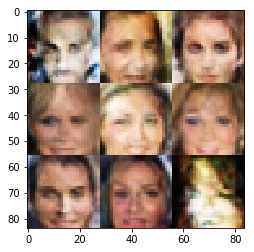

Epoch 1/1... Discriminator Loss: 1.0757... Generator Loss: 0.8155


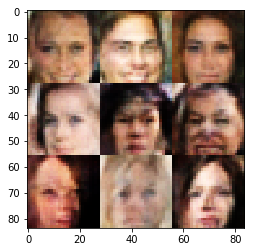

Epoch 1/1... Discriminator Loss: 0.9995... Generator Loss: 0.9991


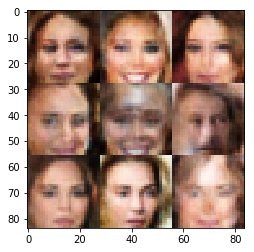

Epoch 1/1... Discriminator Loss: 1.1649... Generator Loss: 0.5784


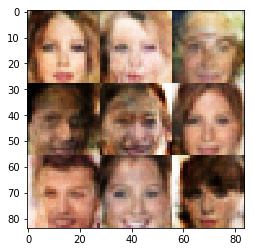

Epoch 1/1... Discriminator Loss: 1.2072... Generator Loss: 0.6484


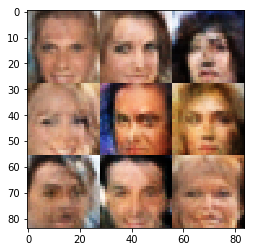

Epoch 1/1... Discriminator Loss: 1.4962... Generator Loss: 0.3400


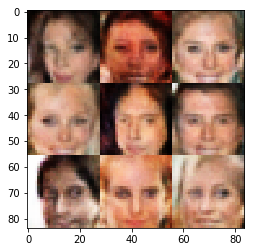

Epoch 1/1... Discriminator Loss: 1.3247... Generator Loss: 0.5702


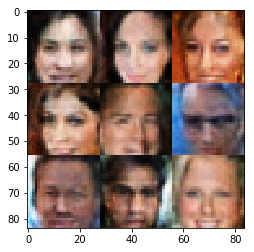

Epoch 1/1... Discriminator Loss: 1.0276... Generator Loss: 0.6521


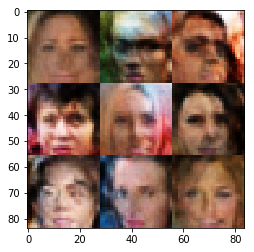

Epoch 1/1... Discriminator Loss: 1.1726... Generator Loss: 0.7100


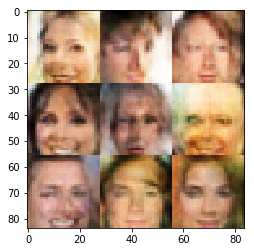

Epoch 1/1... Discriminator Loss: 1.4729... Generator Loss: 0.6192


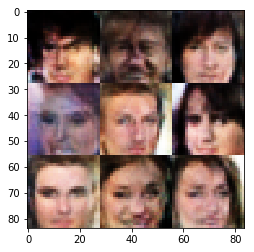

Epoch 1/1... Discriminator Loss: 0.8676... Generator Loss: 0.9334


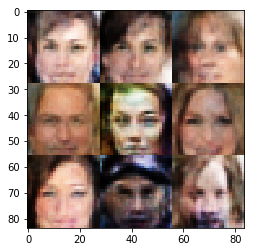

Epoch 1/1... Discriminator Loss: 1.0510... Generator Loss: 0.8507


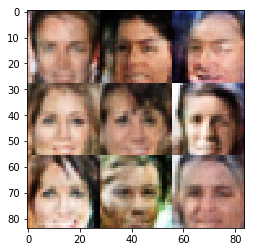

Epoch 1/1... Discriminator Loss: 1.0131... Generator Loss: 0.8187


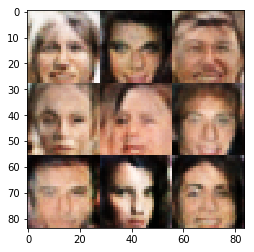

Epoch 1/1... Discriminator Loss: 1.0747... Generator Loss: 0.7978


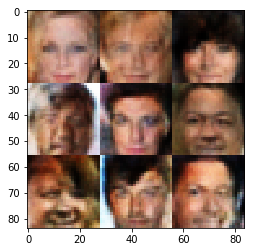

Epoch 1/1... Discriminator Loss: 0.9406... Generator Loss: 0.9000


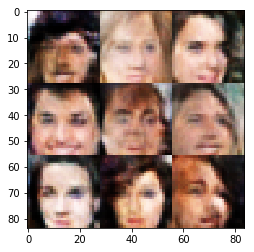

Epoch 1/1... Discriminator Loss: 0.8591... Generator Loss: 0.8733


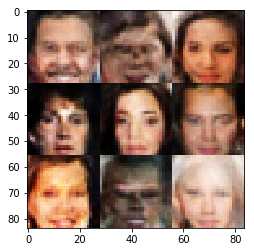

Epoch 1/1... Discriminator Loss: 1.1013... Generator Loss: 0.6586


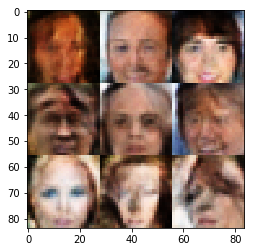

Epoch 1/1... Discriminator Loss: 1.0832... Generator Loss: 0.5504


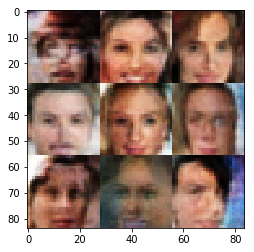

Epoch 1/1... Discriminator Loss: 1.0962... Generator Loss: 0.6499


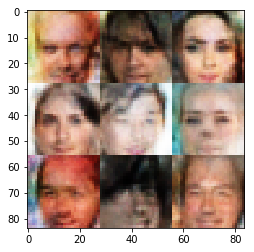

Epoch 1/1... Discriminator Loss: 0.9374... Generator Loss: 0.9855


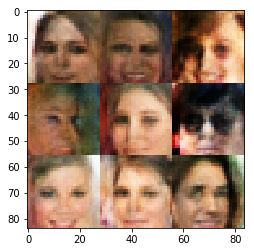

Epoch 1/1... Discriminator Loss: 1.3028... Generator Loss: 0.5541


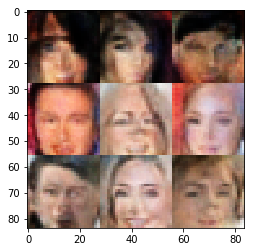

Epoch 1/1... Discriminator Loss: 1.1184... Generator Loss: 0.6746


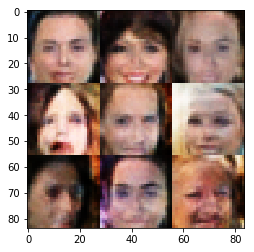

Epoch 1/1... Discriminator Loss: 1.6390... Generator Loss: 0.2779


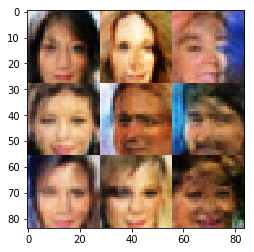

Epoch 1/1... Discriminator Loss: 1.1513... Generator Loss: 0.5906


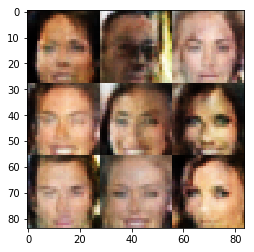

Epoch 1/1... Discriminator Loss: 1.1446... Generator Loss: 0.5369


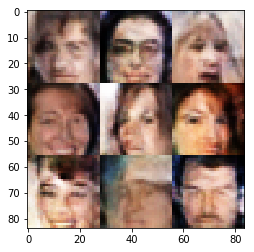

Epoch 1/1... Discriminator Loss: 1.2039... Generator Loss: 0.5007


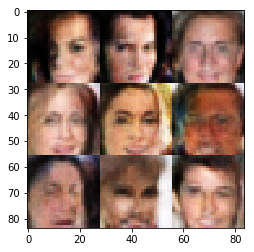

Epoch 1/1... Discriminator Loss: 1.4503... Generator Loss: 0.5358


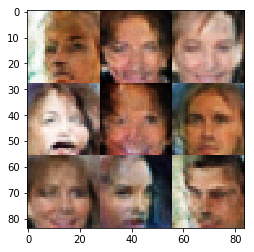

Epoch 1/1... Discriminator Loss: 1.1391... Generator Loss: 0.7505


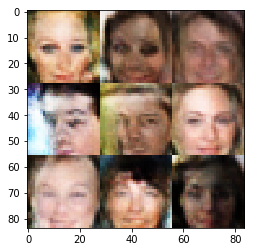

Epoch 1/1... Discriminator Loss: 1.0244... Generator Loss: 0.9888


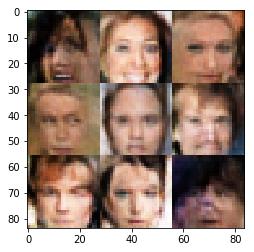

Epoch 1/1... Discriminator Loss: 1.1637... Generator Loss: 0.7864


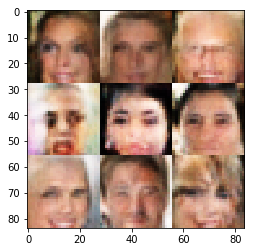

Epoch 1/1... Discriminator Loss: 1.2767... Generator Loss: 0.5121


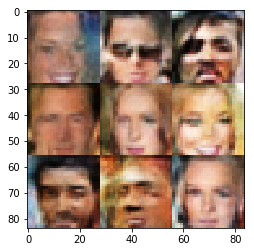

Epoch 1/1... Discriminator Loss: 1.6774... Generator Loss: 0.2643


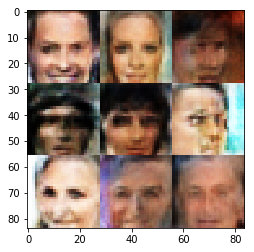

Epoch 1/1... Discriminator Loss: 1.2763... Generator Loss: 0.6298


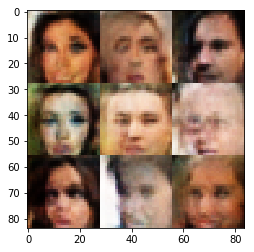

Epoch 1/1... Discriminator Loss: 1.3929... Generator Loss: 0.3886


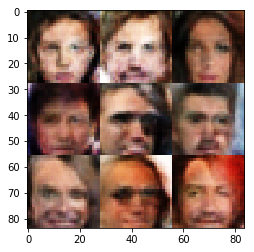

Epoch 1/1... Discriminator Loss: 0.8513... Generator Loss: 0.8096


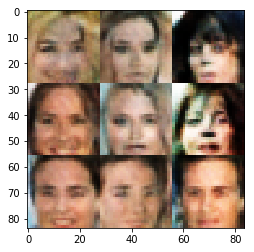

Epoch 1/1... Discriminator Loss: 1.1380... Generator Loss: 0.7535


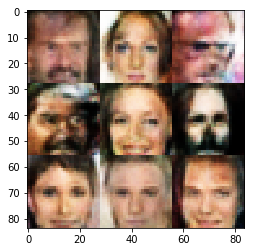

Epoch 1/1... Discriminator Loss: 1.5824... Generator Loss: 0.3161


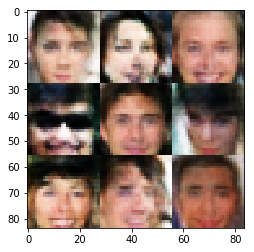

Epoch 1/1... Discriminator Loss: 1.1540... Generator Loss: 0.4587


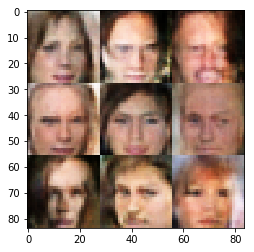

Epoch 1/1... Discriminator Loss: 1.1474... Generator Loss: 0.4937


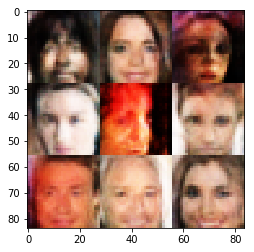

Epoch 1/1... Discriminator Loss: 1.3607... Generator Loss: 0.7683


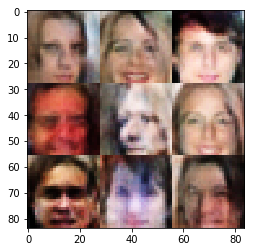

Epoch 1/1... Discriminator Loss: 1.0423... Generator Loss: 1.2315


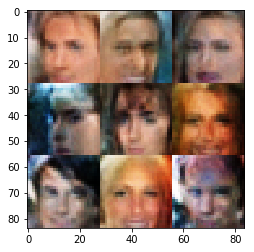

Epoch 1/1... Discriminator Loss: 1.0718... Generator Loss: 1.0449


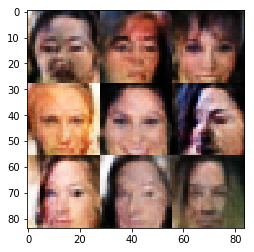

Epoch 1/1... Discriminator Loss: 1.4509... Generator Loss: 0.4107


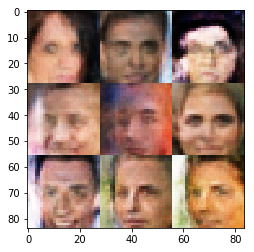

Epoch 1/1... Discriminator Loss: 1.3461... Generator Loss: 0.4603


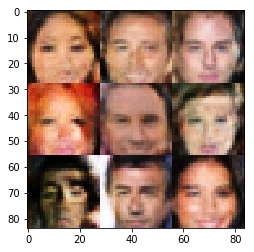

Epoch 1/1... Discriminator Loss: 1.0813... Generator Loss: 0.6410


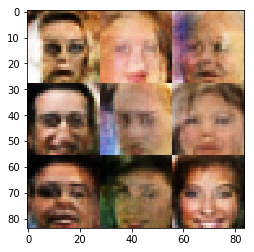

Epoch 1/1... Discriminator Loss: 0.9671... Generator Loss: 0.7164


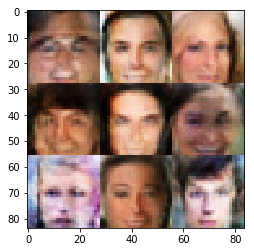

Epoch 1/1... Discriminator Loss: 1.3519... Generator Loss: 0.6834


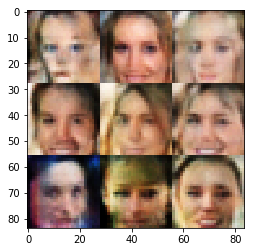

Epoch 1/1... Discriminator Loss: 0.8659... Generator Loss: 0.9130


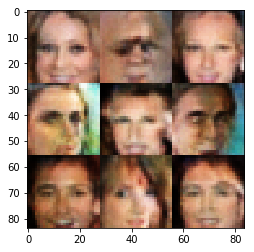

Epoch 1/1... Discriminator Loss: 1.0713... Generator Loss: 0.6839


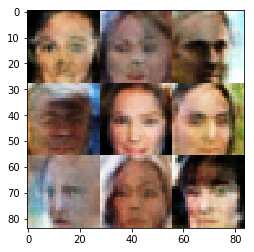

Epoch 1/1... Discriminator Loss: 0.9056... Generator Loss: 1.6415


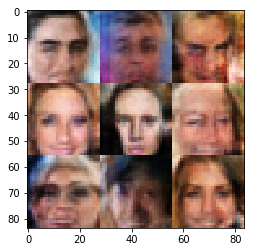

Epoch 1/1... Discriminator Loss: 0.8560... Generator Loss: 1.2826


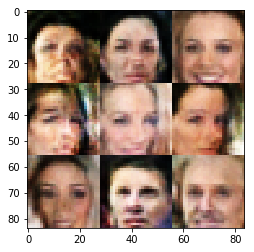

Epoch 1/1... Discriminator Loss: 1.1091... Generator Loss: 0.8659


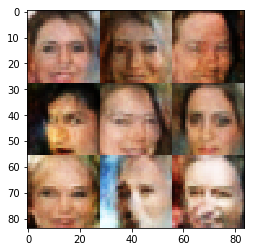

Epoch 1/1... Discriminator Loss: 1.1734... Generator Loss: 0.5149


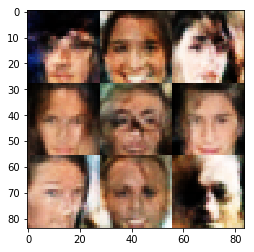

Epoch 1/1... Discriminator Loss: 1.2207... Generator Loss: 0.4966


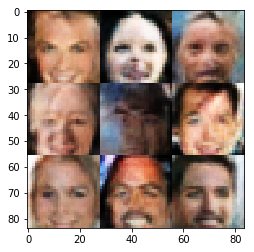

Epoch 1/1... Discriminator Loss: 1.1480... Generator Loss: 0.6122


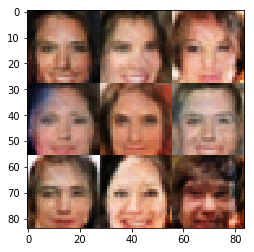

Epoch 1/1... Discriminator Loss: 1.2083... Generator Loss: 0.5246


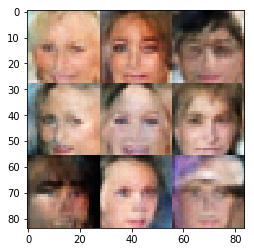

Epoch 1/1... Discriminator Loss: 1.1719... Generator Loss: 0.4864


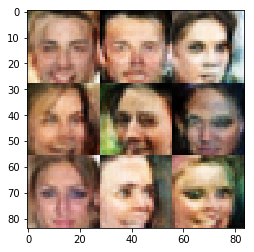

Epoch 1/1... Discriminator Loss: 0.9580... Generator Loss: 0.7345


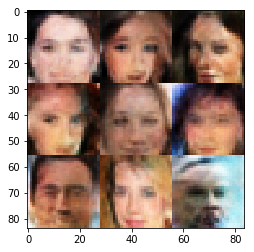

Epoch 1/1... Discriminator Loss: 1.1600... Generator Loss: 1.1739


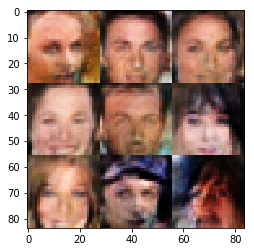

Epoch 1/1... Discriminator Loss: 1.6235... Generator Loss: 0.3375


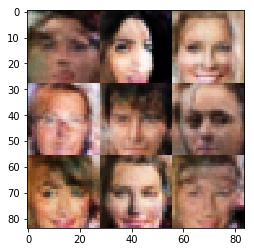

Epoch 1/1... Discriminator Loss: 1.1878... Generator Loss: 0.5427


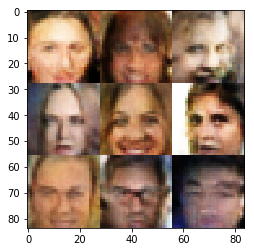

Epoch 1/1... Discriminator Loss: 1.2589... Generator Loss: 0.8142


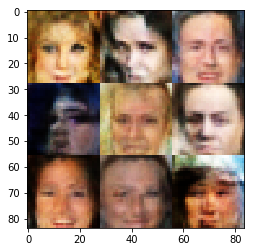

Epoch 1/1... Discriminator Loss: 1.2363... Generator Loss: 1.3328


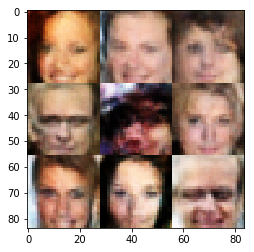

Epoch 1/1... Discriminator Loss: 1.0166... Generator Loss: 1.4211


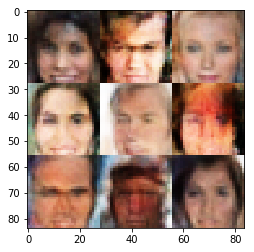

Epoch 1/1... Discriminator Loss: 1.1634... Generator Loss: 0.6426


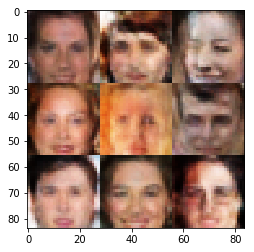

Epoch 1/1... Discriminator Loss: 1.5828... Generator Loss: 0.3534


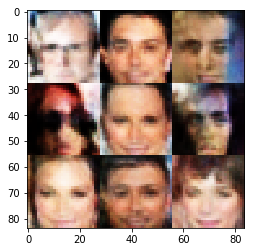

Epoch 1/1... Discriminator Loss: 1.0848... Generator Loss: 0.6785


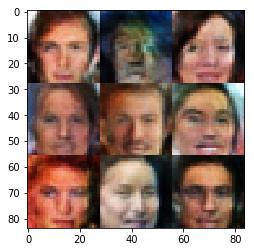

Epoch 1/1... Discriminator Loss: 1.2434... Generator Loss: 0.6906


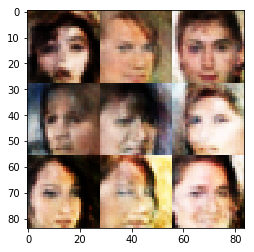

Epoch 1/1... Discriminator Loss: 1.2638... Generator Loss: 0.5509


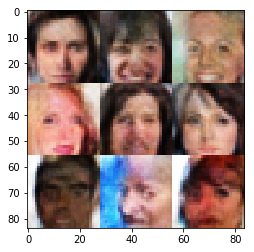

Epoch 1/1... Discriminator Loss: 1.0150... Generator Loss: 1.2442


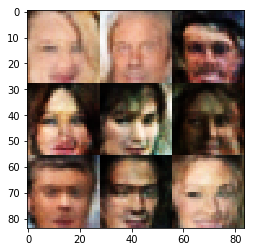

Epoch 1/1... Discriminator Loss: 1.0275... Generator Loss: 0.6634


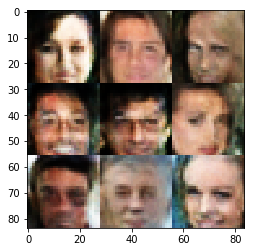

Epoch 1/1... Discriminator Loss: 0.9446... Generator Loss: 1.2116


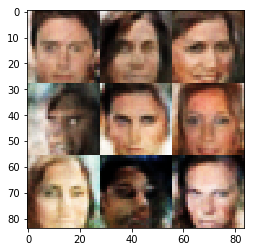

Epoch 1/1... Discriminator Loss: 1.1143... Generator Loss: 0.8729


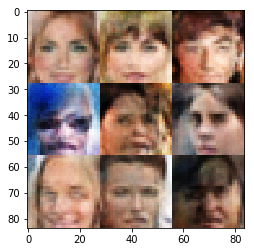

Epoch 1/1... Discriminator Loss: 1.0922... Generator Loss: 0.6302


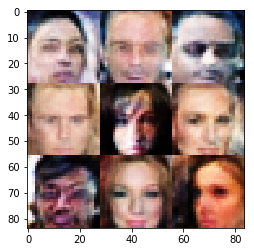

Epoch 1/1... Discriminator Loss: 1.2046... Generator Loss: 0.7710


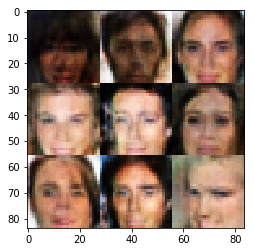

Epoch 1/1... Discriminator Loss: 1.4358... Generator Loss: 0.3592


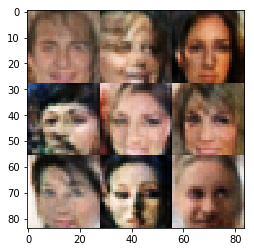

Epoch 1/1... Discriminator Loss: 1.6237... Generator Loss: 0.3559


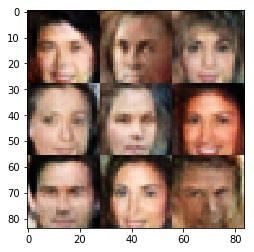

Epoch 1/1... Discriminator Loss: 1.6305... Generator Loss: 0.3192


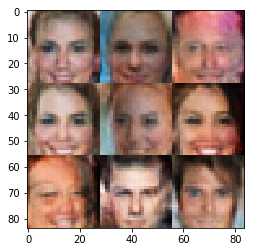

Epoch 1/1... Discriminator Loss: 0.9266... Generator Loss: 0.7554


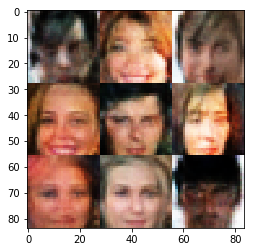

Epoch 1/1... Discriminator Loss: 0.9398... Generator Loss: 0.7442


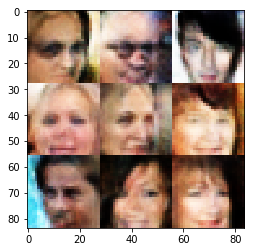

Epoch 1/1... Discriminator Loss: 1.2838... Generator Loss: 0.5174


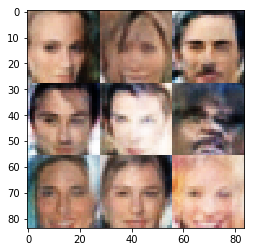

Epoch 1/1... Discriminator Loss: 1.2307... Generator Loss: 0.5942


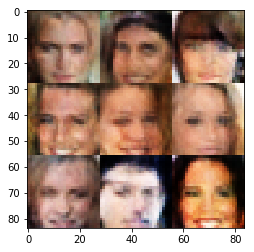

Epoch 1/1... Discriminator Loss: 1.2631... Generator Loss: 1.0926


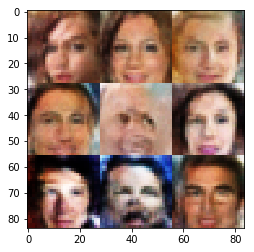

Epoch 1/1... Discriminator Loss: 0.9581... Generator Loss: 0.8731


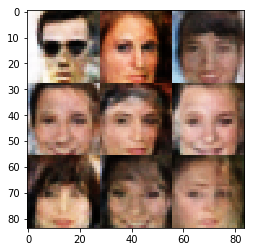

Epoch 1/1... Discriminator Loss: 1.3133... Generator Loss: 0.6057


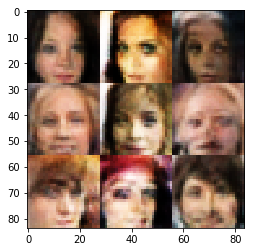

Epoch 1/1... Discriminator Loss: 1.7494... Generator Loss: 0.2387


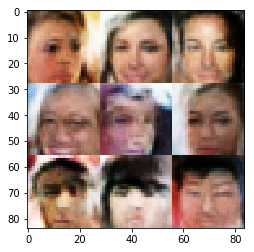

Epoch 1/1... Discriminator Loss: 1.2111... Generator Loss: 0.6735


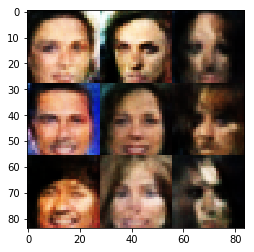

Epoch 1/1... Discriminator Loss: 1.1312... Generator Loss: 0.5913


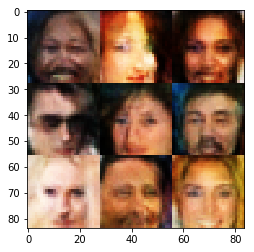

Epoch 1/1... Discriminator Loss: 1.1638... Generator Loss: 0.6222


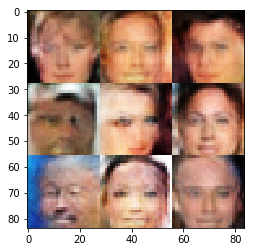

Epoch 1/1... Discriminator Loss: 0.8155... Generator Loss: 1.2422


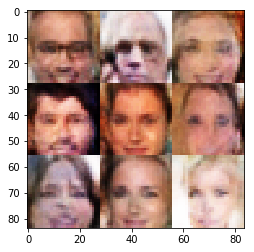

Epoch 1/1... Discriminator Loss: 1.0561... Generator Loss: 0.7057


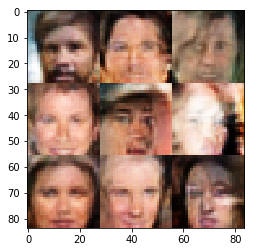

Epoch 1/1... Discriminator Loss: 1.2650... Generator Loss: 0.9682


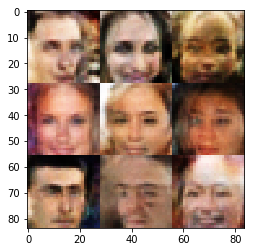

Epoch 1/1... Discriminator Loss: 1.4121... Generator Loss: 0.4219


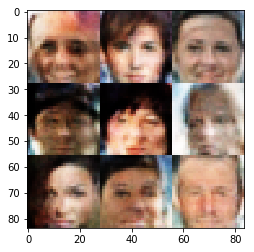

Epoch 1/1... Discriminator Loss: 1.0659... Generator Loss: 0.6947


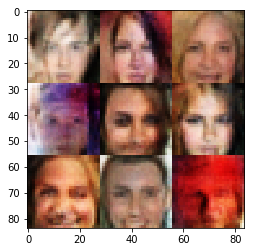

Epoch 1/1... Discriminator Loss: 1.0205... Generator Loss: 0.8501


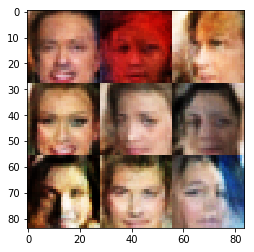

Epoch 1/1... Discriminator Loss: 0.9921... Generator Loss: 0.7611


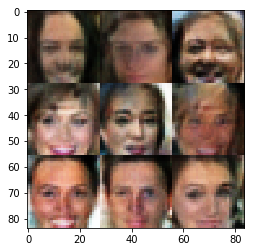

Epoch 1/1... Discriminator Loss: 1.0457... Generator Loss: 0.6289


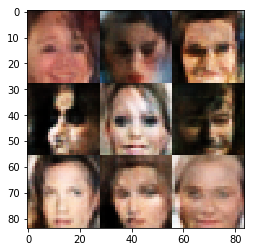

Epoch 1/1... Discriminator Loss: 1.3065... Generator Loss: 0.5728


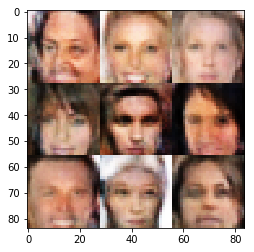

Epoch 1/1... Discriminator Loss: 1.0741... Generator Loss: 0.6083


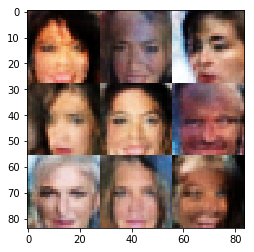

Epoch 1/1... Discriminator Loss: 1.1857... Generator Loss: 0.6824


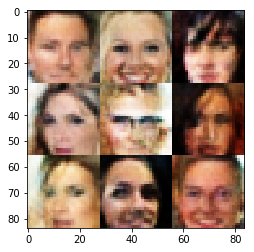

Epoch 1/1... Discriminator Loss: 1.5266... Generator Loss: 0.3081


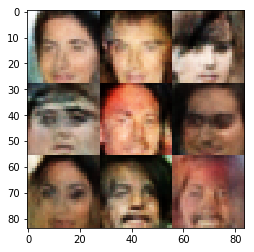

Epoch 1/1... Discriminator Loss: 1.3195... Generator Loss: 0.4231


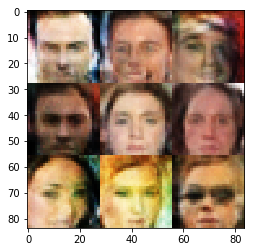

Epoch 1/1... Discriminator Loss: 1.3285... Generator Loss: 0.4569


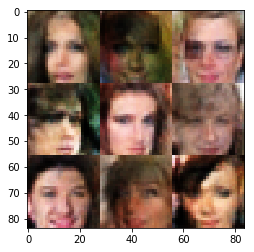

Epoch 1/1... Discriminator Loss: 1.4073... Generator Loss: 1.6165


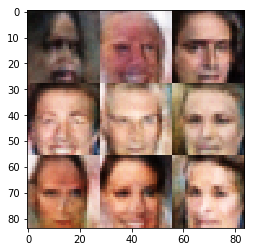

Epoch 1/1... Discriminator Loss: 1.3104... Generator Loss: 0.4321


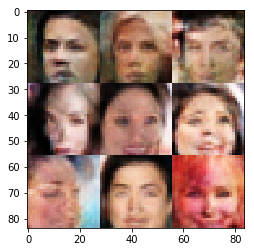

Epoch 1/1... Discriminator Loss: 1.1025... Generator Loss: 0.8876


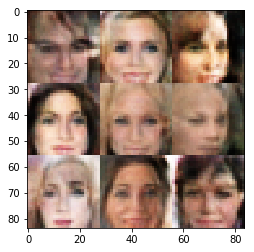

Epoch 1/1... Discriminator Loss: 1.0269... Generator Loss: 0.6283


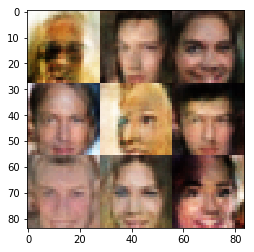

Epoch 1/1... Discriminator Loss: 1.1625... Generator Loss: 0.8171


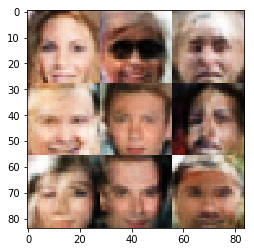

Epoch 1/1... Discriminator Loss: 0.9636... Generator Loss: 1.0370


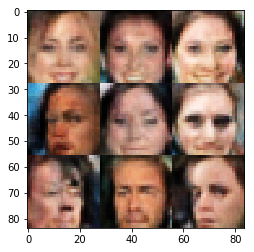

Epoch 1/1... Discriminator Loss: 1.0295... Generator Loss: 0.7320


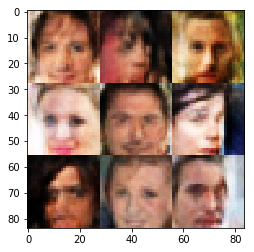

Epoch 1/1... Discriminator Loss: 1.2258... Generator Loss: 0.4809


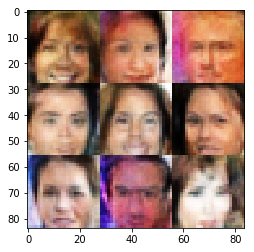

Epoch 1/1... Discriminator Loss: 0.9338... Generator Loss: 0.6485


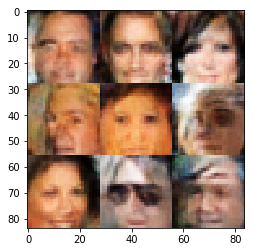

Epoch 1/1... Discriminator Loss: 1.0925... Generator Loss: 0.5479


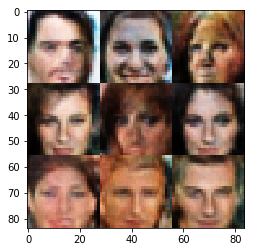

Epoch 1/1... Discriminator Loss: 1.8382... Generator Loss: 0.2411


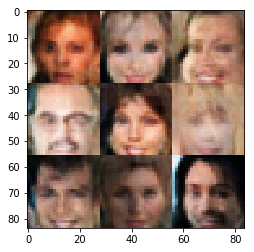

Epoch 1/1... Discriminator Loss: 1.1652... Generator Loss: 0.8413


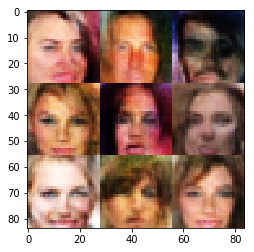

Epoch 1/1... Discriminator Loss: 1.1226... Generator Loss: 0.6341


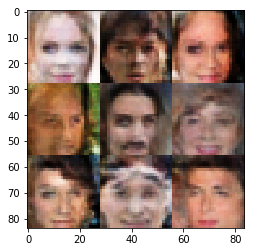

Epoch 1/1... Discriminator Loss: 0.9858... Generator Loss: 0.7916


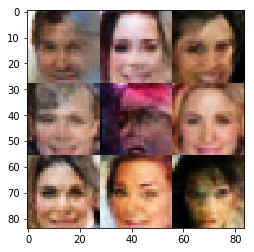

Epoch 1/1... Discriminator Loss: 1.4679... Generator Loss: 0.3221


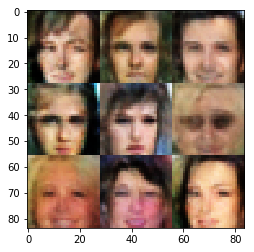

Epoch 1/1... Discriminator Loss: 1.1712... Generator Loss: 0.6020


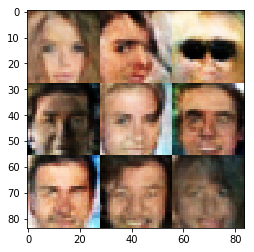

Epoch 1/1... Discriminator Loss: 1.4044... Generator Loss: 0.5043


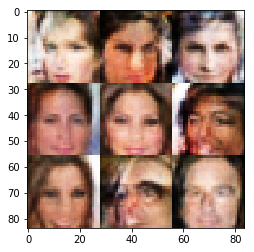

Epoch 1/1... Discriminator Loss: 1.1256... Generator Loss: 0.5291


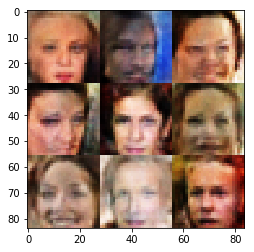

Epoch 1/1... Discriminator Loss: 1.5846... Generator Loss: 0.3267


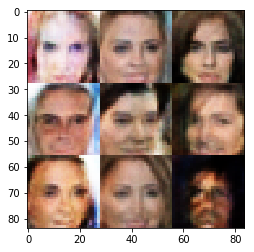

Epoch 1/1... Discriminator Loss: 0.8820... Generator Loss: 0.8391


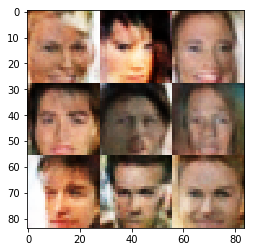

Epoch 1/1... Discriminator Loss: 1.5046... Generator Loss: 0.3768


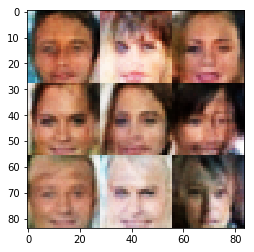

Epoch 1/1... Discriminator Loss: 1.4099... Generator Loss: 0.4077


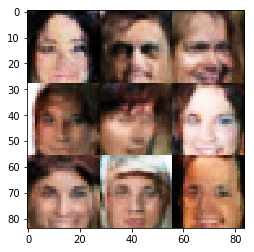

Epoch 1/1... Discriminator Loss: 0.8886... Generator Loss: 0.8494


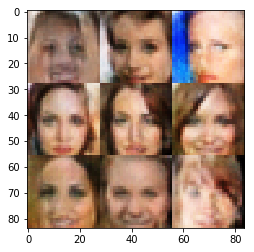

Epoch 1/1... Discriminator Loss: 1.2976... Generator Loss: 0.9016


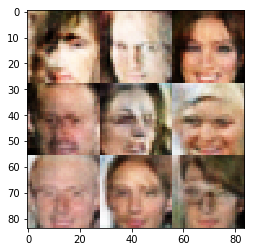

Epoch 1/1... Discriminator Loss: 0.8334... Generator Loss: 1.0952


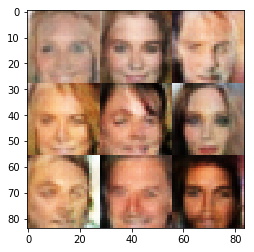

Epoch 1/1... Discriminator Loss: 1.1711... Generator Loss: 1.8877


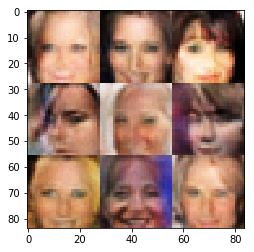

Epoch 1/1... Discriminator Loss: 1.0890... Generator Loss: 0.7667


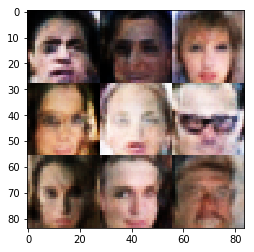

Epoch 1/1... Discriminator Loss: 0.8326... Generator Loss: 1.4337


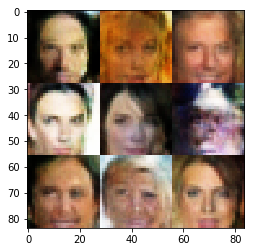

Epoch 1/1... Discriminator Loss: 1.3258... Generator Loss: 0.4438


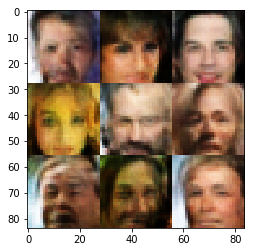

Epoch 1/1... Discriminator Loss: 1.0271... Generator Loss: 0.6013


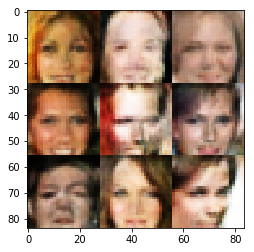

Epoch 1/1... Discriminator Loss: 1.1741... Generator Loss: 0.6030


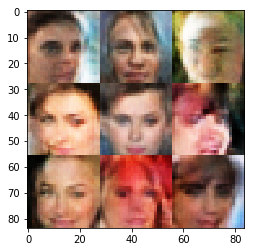

Epoch 1/1... Discriminator Loss: 1.2599... Generator Loss: 0.7090


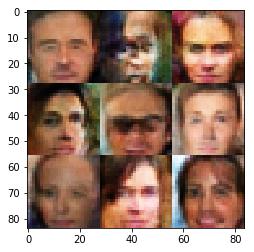

Epoch 1/1... Discriminator Loss: 1.2107... Generator Loss: 0.4911


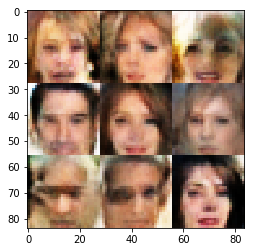

Epoch 1/1... Discriminator Loss: 1.1743... Generator Loss: 0.5251


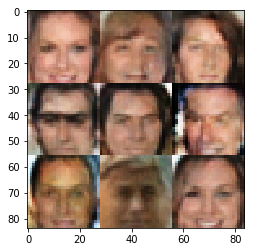

Epoch 1/1... Discriminator Loss: 1.2073... Generator Loss: 1.0365


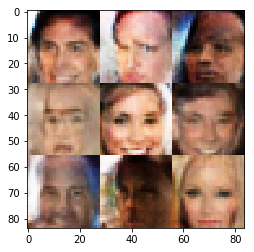

Epoch 1/1... Discriminator Loss: 1.8163... Generator Loss: 0.2456


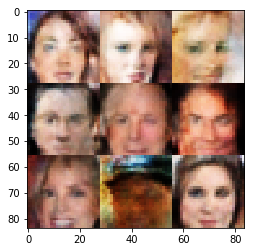

Epoch 1/1... Discriminator Loss: 1.1035... Generator Loss: 0.8627


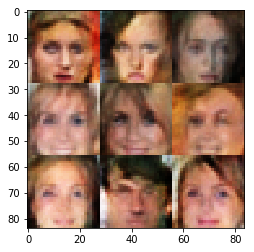

Epoch 1/1... Discriminator Loss: 1.0808... Generator Loss: 0.5881


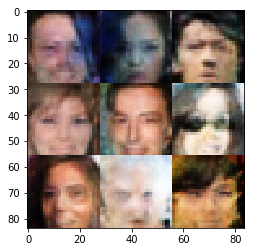

Epoch 1/1... Discriminator Loss: 1.4024... Generator Loss: 0.3817


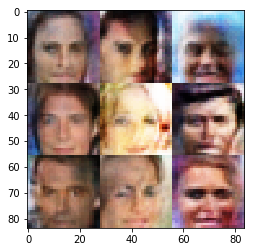

Epoch 1/1... Discriminator Loss: 1.1121... Generator Loss: 1.0813


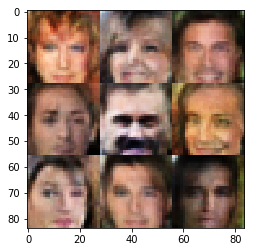

Epoch 1/1... Discriminator Loss: 1.1961... Generator Loss: 0.8387


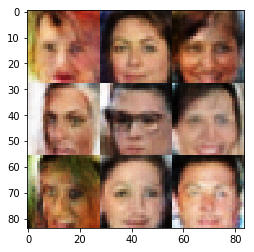

Epoch 1/1... Discriminator Loss: 1.1762... Generator Loss: 0.5107


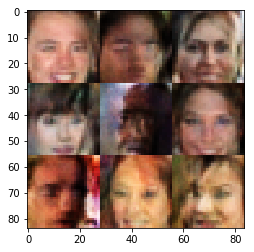

Epoch 1/1... Discriminator Loss: 1.1047... Generator Loss: 0.5789


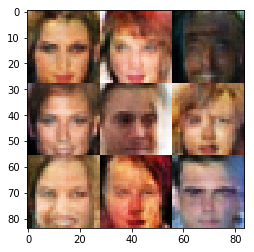

Epoch 1/1... Discriminator Loss: 1.6358... Generator Loss: 0.3659


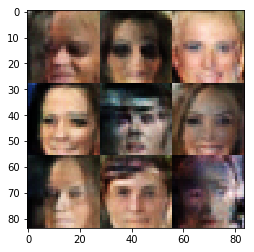

Epoch 1/1... Discriminator Loss: 1.3206... Generator Loss: 0.4694


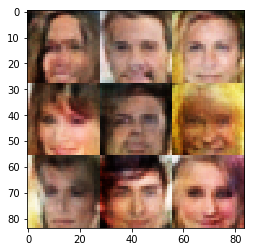

Epoch 1/1... Discriminator Loss: 1.4360... Generator Loss: 0.3193


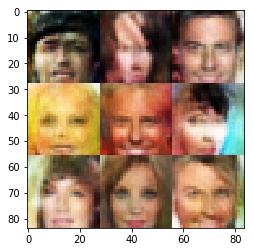

Epoch 1/1... Discriminator Loss: 0.9216... Generator Loss: 0.8197


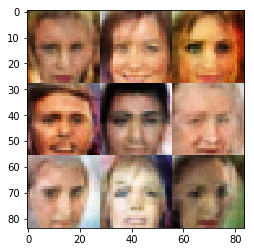

Epoch 1/1... Discriminator Loss: 1.2726... Generator Loss: 0.5159


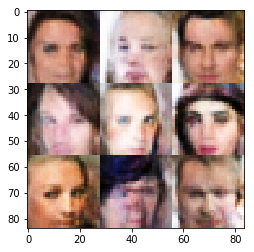

Epoch 1/1... Discriminator Loss: 1.0661... Generator Loss: 0.5542


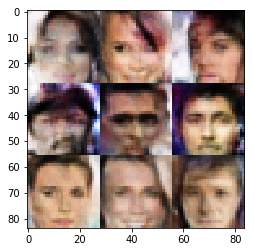

Epoch 1/1... Discriminator Loss: 1.4598... Generator Loss: 0.3619


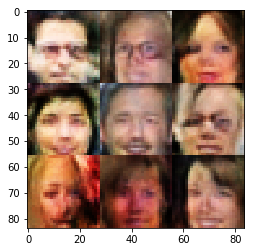

Epoch 1/1... Discriminator Loss: 0.9974... Generator Loss: 0.7705


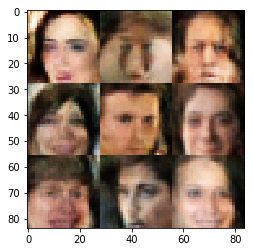

Epoch 1/1... Discriminator Loss: 0.8458... Generator Loss: 0.8040


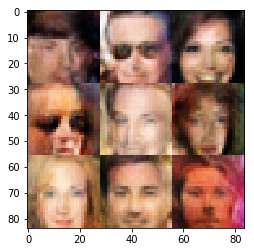

Epoch 1/1... Discriminator Loss: 1.4059... Generator Loss: 0.4106


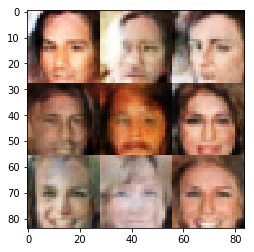

Epoch 1/1... Discriminator Loss: 1.5320... Generator Loss: 0.5267


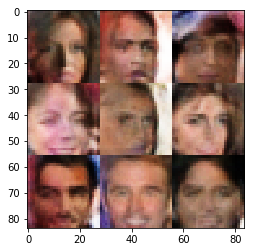

Epoch 1/1... Discriminator Loss: 0.8880... Generator Loss: 1.0938


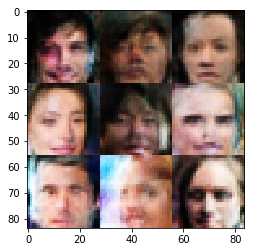

Epoch 1/1... Discriminator Loss: 0.9566... Generator Loss: 1.1830


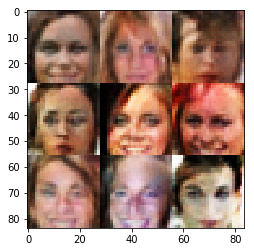

Epoch 1/1... Discriminator Loss: 1.3858... Generator Loss: 0.4120


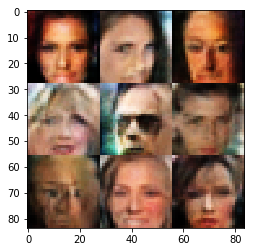

Epoch 1/1... Discriminator Loss: 0.9279... Generator Loss: 0.9848


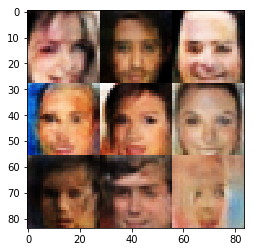

Epoch 1/1... Discriminator Loss: 1.4322... Generator Loss: 0.4052


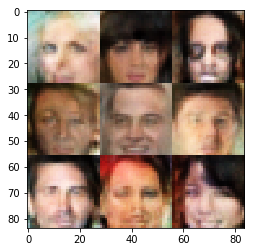

Epoch 1/1... Discriminator Loss: 0.9144... Generator Loss: 0.7832


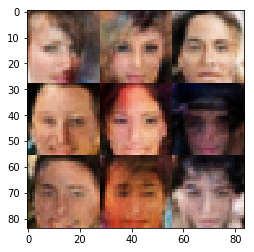

Epoch 1/1... Discriminator Loss: 1.4579... Generator Loss: 0.3852


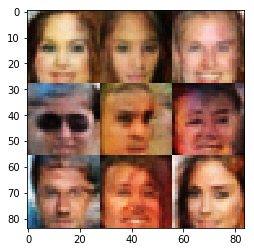

Epoch 1/1... Discriminator Loss: 1.0839... Generator Loss: 0.6378


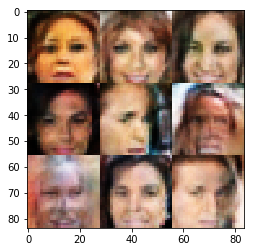

Epoch 1/1... Discriminator Loss: 1.3644... Generator Loss: 0.4866


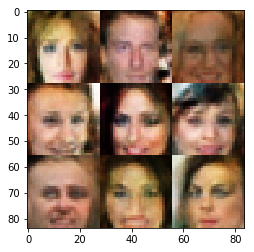

Epoch 1/1... Discriminator Loss: 1.0916... Generator Loss: 0.5904


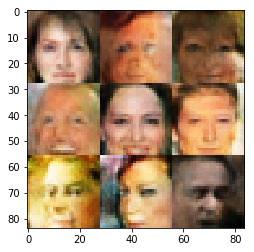

Epoch 1/1... Discriminator Loss: 1.4012... Generator Loss: 0.7584


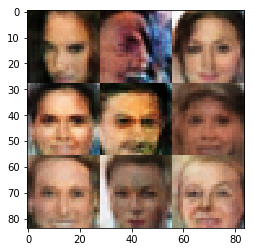

Epoch 1/1... Discriminator Loss: 0.8392... Generator Loss: 1.2689


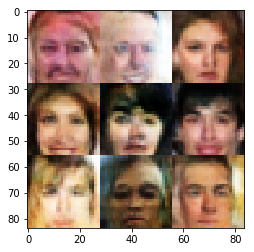

Epoch 1/1... Discriminator Loss: 1.3459... Generator Loss: 0.4040


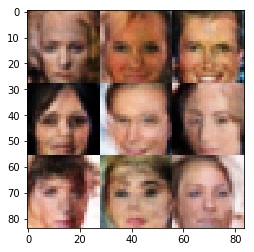

Epoch 1/1... Discriminator Loss: 1.5218... Generator Loss: 0.3521


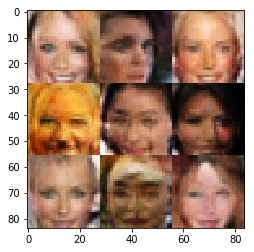

Epoch 1/1... Discriminator Loss: 0.9083... Generator Loss: 0.6841


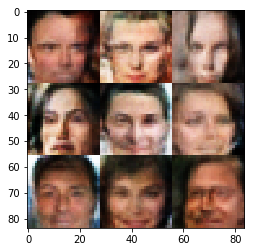

Epoch 1/1... Discriminator Loss: 1.4465... Generator Loss: 0.3853


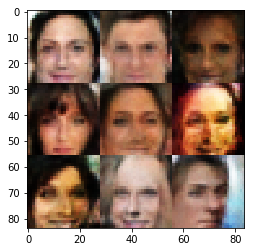

Epoch 1/1... Discriminator Loss: 1.7548... Generator Loss: 0.2200


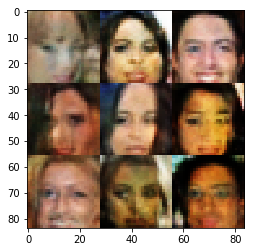

Epoch 1/1... Discriminator Loss: 0.7269... Generator Loss: 1.0647


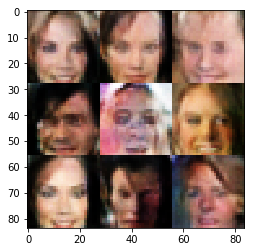

Epoch 1/1... Discriminator Loss: 0.8872... Generator Loss: 1.0430


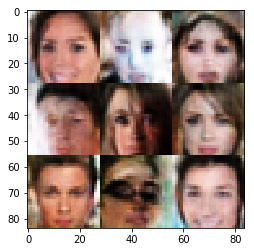

Epoch 1/1... Discriminator Loss: 0.9887... Generator Loss: 0.6620


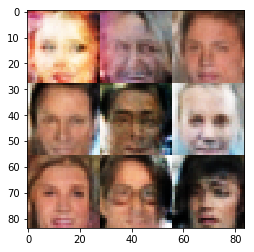

Epoch 1/1... Discriminator Loss: 1.3841... Generator Loss: 0.4416


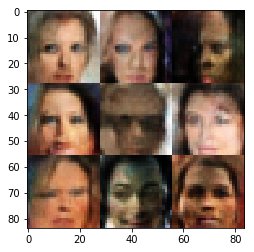

Epoch 1/1... Discriminator Loss: 1.0405... Generator Loss: 0.9464


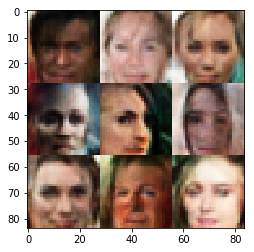

Epoch 1/1... Discriminator Loss: 0.9083... Generator Loss: 0.9516


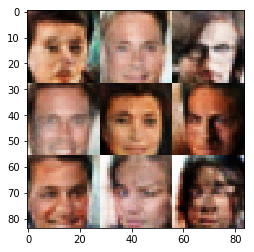

Epoch 1/1... Discriminator Loss: 0.9215... Generator Loss: 1.3542


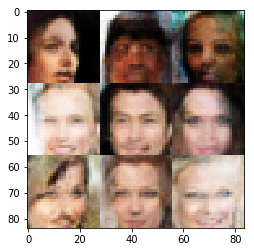

Epoch 1/1... Discriminator Loss: 1.1496... Generator Loss: 0.6425


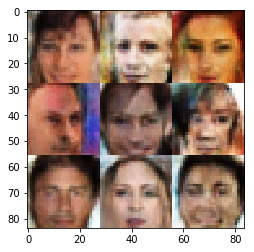

Epoch 1/1... Discriminator Loss: 1.0899... Generator Loss: 0.5618


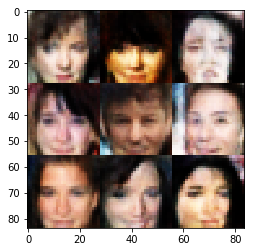

Epoch 1/1... Discriminator Loss: 0.9271... Generator Loss: 0.8245


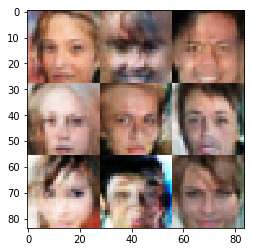

Epoch 1/1... Discriminator Loss: 0.7380... Generator Loss: 1.0527


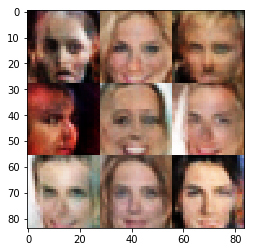

Epoch 1/1... Discriminator Loss: 1.3932... Generator Loss: 0.3831


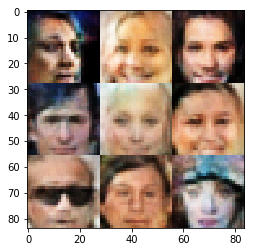

Epoch 1/1... Discriminator Loss: 1.1758... Generator Loss: 1.1054


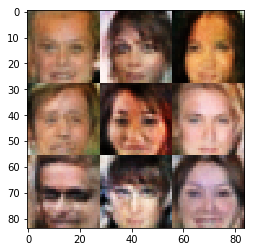

Epoch 1/1... Discriminator Loss: 2.1592... Generator Loss: 0.1847


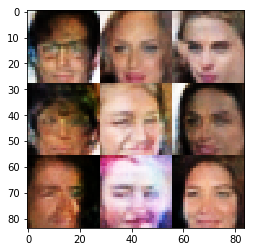

Epoch 1/1... Discriminator Loss: 1.5393... Generator Loss: 0.2967


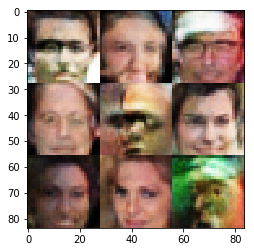

Epoch 1/1... Discriminator Loss: 1.1935... Generator Loss: 0.6475


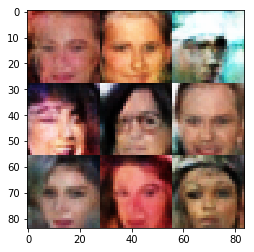

Epoch 1/1... Discriminator Loss: 1.1601... Generator Loss: 0.8079


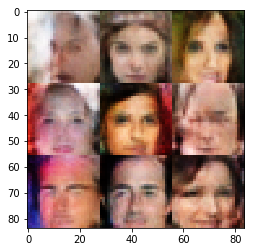

Epoch 1/1... Discriminator Loss: 1.3095... Generator Loss: 0.7875


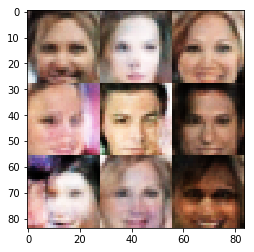

Epoch 1/1... Discriminator Loss: 0.6774... Generator Loss: 1.3737


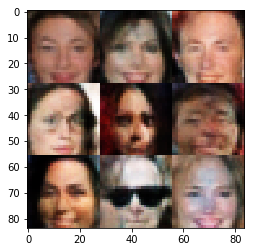

Epoch 1/1... Discriminator Loss: 1.0987... Generator Loss: 0.6216


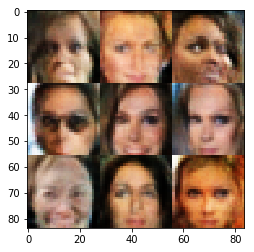

Epoch 1/1... Discriminator Loss: 1.3915... Generator Loss: 0.4148


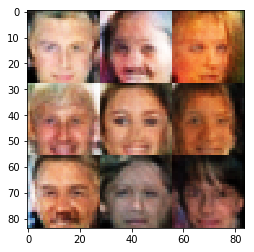

Epoch 1/1... Discriminator Loss: 1.2011... Generator Loss: 0.5469


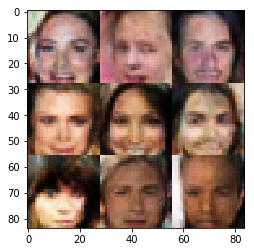

Epoch 1/1... Discriminator Loss: 1.3288... Generator Loss: 0.4488


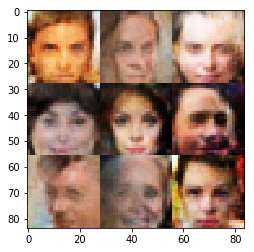

Epoch 1/1... Discriminator Loss: 1.1769... Generator Loss: 0.4966


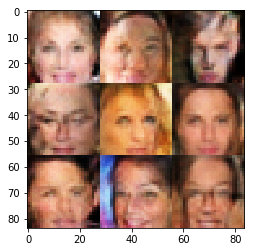

Epoch 1/1... Discriminator Loss: 0.9409... Generator Loss: 0.9169


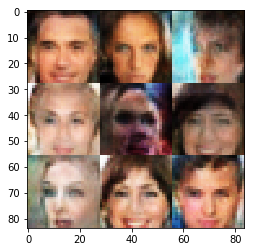

Epoch 1/1... Discriminator Loss: 1.2611... Generator Loss: 0.4215


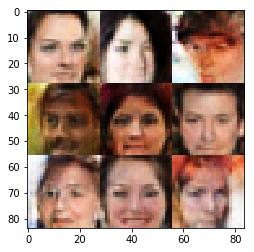

Epoch 1/1... Discriminator Loss: 1.3904... Generator Loss: 0.4350


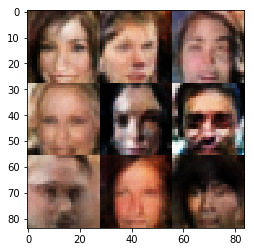

Epoch 1/1... Discriminator Loss: 1.2287... Generator Loss: 0.5193


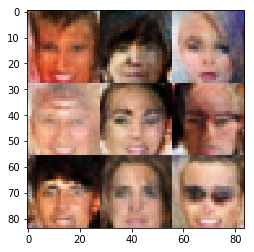

Epoch 1/1... Discriminator Loss: 0.9532... Generator Loss: 0.7634


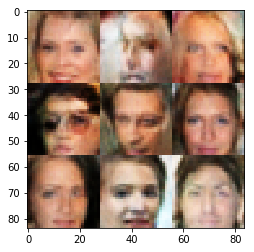

Epoch 1/1... Discriminator Loss: 1.1670... Generator Loss: 0.5330


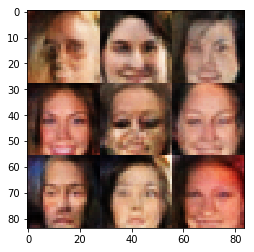

Epoch 1/1... Discriminator Loss: 1.2800... Generator Loss: 0.4677


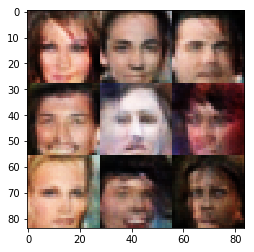

Epoch 1/1... Discriminator Loss: 1.1354... Generator Loss: 0.5342


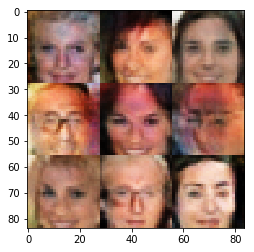

Epoch 1/1... Discriminator Loss: 1.2096... Generator Loss: 0.5152


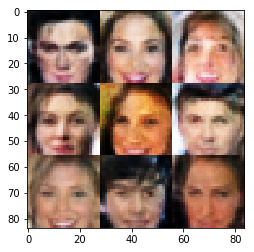

Epoch 1/1... Discriminator Loss: 1.1603... Generator Loss: 0.6361


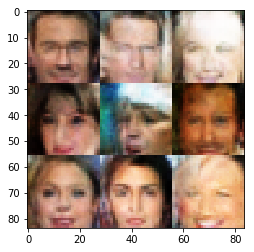

Epoch 1/1... Discriminator Loss: 0.9943... Generator Loss: 0.7684


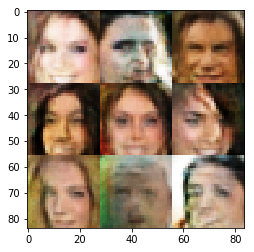

Epoch 1/1... Discriminator Loss: 1.1226... Generator Loss: 0.6014


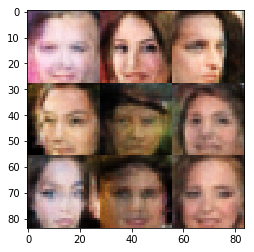

Epoch 1/1... Discriminator Loss: 1.3293... Generator Loss: 0.3647


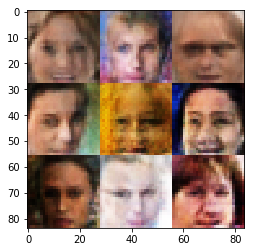

Epoch 1/1... Discriminator Loss: 1.3139... Generator Loss: 0.4988


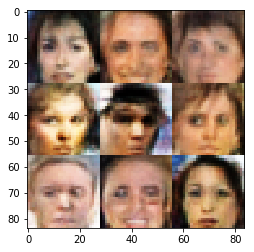

Epoch 1/1... Discriminator Loss: 1.3865... Generator Loss: 1.0563


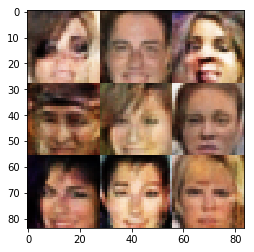

Epoch 1/1... Discriminator Loss: 1.1031... Generator Loss: 0.7199


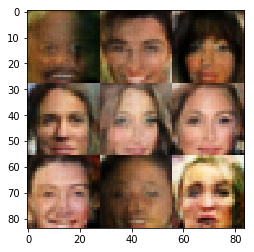

Epoch 1/1... Discriminator Loss: 0.8828... Generator Loss: 1.5668


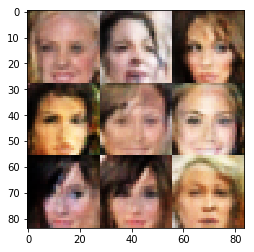

Epoch 1/1... Discriminator Loss: 1.2059... Generator Loss: 0.4861


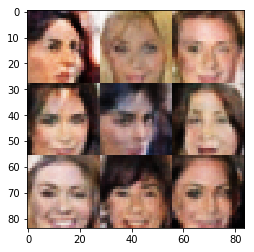

Epoch 1/1... Discriminator Loss: 0.8566... Generator Loss: 0.8826


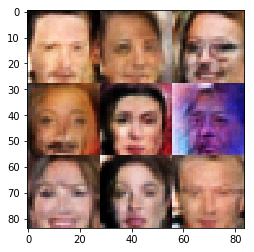

Epoch 1/1... Discriminator Loss: 1.1269... Generator Loss: 0.5550


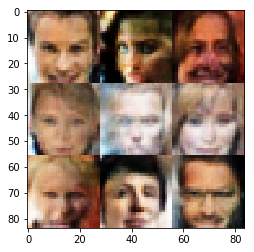

Epoch 1/1... Discriminator Loss: 0.9303... Generator Loss: 0.7101


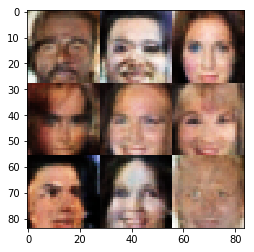

Epoch 1/1... Discriminator Loss: 1.4571... Generator Loss: 0.3970


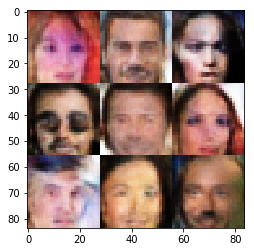

Epoch 1/1... Discriminator Loss: 1.5616... Generator Loss: 0.9891


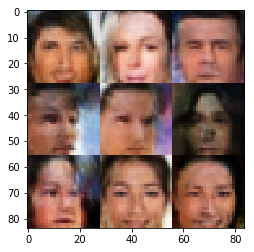

Epoch 1/1... Discriminator Loss: 0.9147... Generator Loss: 1.7841


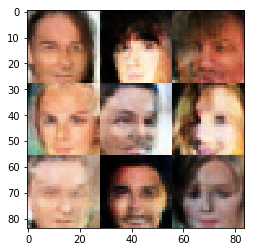

Epoch 1/1... Discriminator Loss: 1.1464... Generator Loss: 0.7341


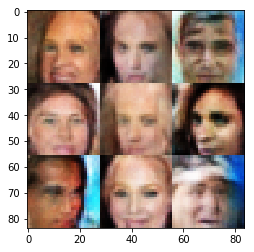

Epoch 1/1... Discriminator Loss: 1.5705... Generator Loss: 0.3451


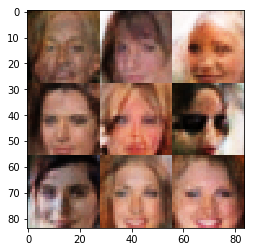

In [13]:
batch_size = 32 # recommended by reviewer, batch_size and learning_rate should be correlated
z_dim = 100
learning_rate = 0.0004 # recommended by reviewer, said DCGAN is stable between 0.0001 and 0.0008
beta1 = 0.3 # recommended by reviewer, said best values between 0.1 and 0.3
tf.reset_default_graph()

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

<div class="alert alert-block alert-info">
<b>Insights from training:</b> <br>
<br>
As you scroll through the output of the cell above, you'll see images slowly transform from what looks like random static, to realistic images of people.  This arises from the interplay between the generator and discriminator networks with the generator essentially trying to fool the discriminator and the discriminator trying to better differentiate real from fake among images from the generator.
</div>